In [1]:
import os, sys

import pandas as pd
import numpy as np
from math import log2
from sklearn.preprocessing import LabelEncoder
from keras.utils import to_categorical
from numpy.random import randint
import matplotlib.pyplot as plt
from scipy.stats import pearsonr


labelnames = ['Adrenal', 'Bladder', 'Brain', 'Breast', 'Cervix', 'Colon', 'Esophagus', 'Head', 'Kidney', 'Leukemia', 'Liver',
'Lung', 'Lymph', 'Ovarian', 'Pancreas', 'Peritoneum', 'Prostate', 'Sarcoma', 'Skin', 'Stomach', 'Testis', 'Thyroid', 'Uterus']

In [2]:
df = pd.read_csv("data/exToptimizedtrain.csv")
bindf = pd.read_csv("data/trainbindata.csv")

In [3]:
stemdf = pd.read_csv("stem_data/prepped_stem_data.csv")

In [4]:
#plt.style.use('dark_background')

In [ ]:
print(stemdf)
elimcols = list()
for col in stemdf.columns:
    for i in range(len(stemdf[stemdf.columns[0]])):
        if np.isnan(list(stemdf[col])[i]):
            elimcols.append(col)
            break
stemdf = stemdf.drop(columns=elimcols)
print(stemdf)
print(len(elimcols))
print(elimcols)

        A1BG  A1BG-AS1      A1CF     A2ML1   A3GALT2    A4GALT     A4GNT  \
0  -0.263787 -1.189730 -3.250951 -2.102223 -3.216413 -1.942248 -3.321928   
1  -0.717341 -1.222610 -3.304378 -2.046415 -3.219386 -2.118950 -3.321928   
2  -0.172887 -1.380992 -3.247566 -1.556462 -3.321928 -1.824290 -3.321928   
3  -2.522045 -2.134667 -2.881636 -3.190677 -2.427254 -3.004510 -2.920556   
4  -1.164648 -1.363482 -2.838676 -3.146693 -2.546269 -2.728811 -2.662065   
5  -1.173720 -1.027592 -3.044977 -3.296687 -2.414490 -3.017951 -2.648895   
6  -1.585159 -0.958234 -2.462258 -2.882471 -2.311564 -3.321928 -3.321928   
7  -1.813717 -1.291243 -2.638258 -2.846303 -1.994351 -3.278038 -3.321928   
8  -0.362450 -0.790901 -2.980376 -3.109772 -2.621286 -3.143599 -3.141294   
9  -0.686951 -1.130705 -3.033292 -3.135526 -2.404526 -3.201210 -3.321928   
10 -2.196625 -2.503328 -2.491915 -2.755442 -1.086080 -3.205447 -3.203909   
11 -0.615147 -1.597022 -3.136142 -3.078998 -2.452294 -3.321928 -3.114772   
12 -0.003963

In [ ]:
stemfeatures = list(stemdf.columns)
regfeatures = list(df.columns)
removedfeatures = list()
for i in range(len(regfeatures)):
    if regfeatures[i] == 'labels':
        continue
    if (i % 1000) == 0:
        print(i)
    flag = 1
    for j in range(len(stemfeatures)):
        if stemfeatures[j] == regfeatures[i]:
            flag = 0
            break
    if flag:
        removedfeatures.append(regfeatures[i])

print(removedfeatures)
print(len(removedfeatures))

for f in removedfeatures:
    regfeatures.remove(f)
print("Starting df reindex")
df = df.reindex(columns=regfeatures)
print("Starting bindf redindex")
bindf = bindf.reindex(columns=regfeatures)

In [ ]:
def NarrowToTwoLabels(df, label1, label2):
    classlist = list(df['labels'])
    indexlist = list()
    for i in range(len(classlist)):
        if classlist[i] == label1 or classlist[i] == label2:
            indexlist.append(i)
    return indexlist

def Aggregate(df, index, featurenames, reverse):
    sum = 0
    for i in range(len(featurenames)):
        value = list(df[featurenames[i]])[index]
        if reverse[i] == 0:
            sum += value
        else:
            sum -= value
    return sum

In [ ]:
def InfoGain(featurelist, classlist, classentropy):
    featurenum = len(np.unique(featurelist))
    classnum = len(np.unique(classlist))
    length = len(featurelist)

    entropy = 0
    for i in range(featurenum):
        featurecount = 0
        for j in range(length):
            if featurelist[j] == i:
                featurecount += 1
        for c in range(classnum):
            cellentropy = 0
            count = 0
            for j in range(length):
                if (featurelist[j] == i) and (classlist[j] == c):
                    count += 1
            if count != 0:
                ratio = count / featurecount
                cellentropy -= ratio * log2(ratio)
                entropy += cellentropy * (featurecount / length)
    return classentropy - entropy
    

def graphpairfeature(df, featurename, label1, label2, indexlist):
    classlist = list(df['labels'])
    featurelist = list(df[featurename])
    graphfeaturelist = list()
    graphclasslist = list()
        
    for i in indexlist:
        graphfeaturelist.append(featurelist[i])
        graphclasslist.append(classlist[i])
        
    graphindex = 0
    for i in range(len(graphclasslist)):
        if graphclasslist[i] == label1:
            graphclasslist[i] = graphindex
            graphindex += 1
    graphindex += 50
    for i in range(len(graphclasslist)):
        if graphclasslist[i] == label2:
            graphclasslist[i] = graphindex
            graphindex += 1
    markersizelist = [10] * len(graphclasslist)
    plt.scatter(graphclasslist, graphfeaturelist, s=markersizelist)
    plt.title(featurename)
    plt.ylabel('Feature Value')
    plt.xlabel('Iteration split by label')
    plt.show()
    


def graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist):
    
    print(featurenamelist)
    print(reverse)
    
    #Handle aggregate creation
    graphfeaturelist = list()
    for i in indexlist:
        graphfeaturelist.append(list(df[featurenamelist[0]])[i])
    for i in range(len(featurenamelist) - 1):
        tmplist = list(df[featurenamelist[i + 1]].copy())
        copylist = list()
        for j in indexlist:
            copylist.append(tmplist[j])

        for j in range(len(graphfeaturelist)):
            if reverse[i + 1] == 0:
                graphfeaturelist[j] += copylist[j]
            else:
                graphfeaturelist[j] -= copylist[j]
    
    #Handle class list creation
    graphclasslist = list()
    for i in indexlist:
        graphclasslist.append(df['labels'][i])
        
    #prepare graph values
    graphindex = 0
    for i in range(len(graphclasslist)):
        if graphclasslist[i] == label1:
            graphclasslist[i] = graphindex
            graphindex += 1
    graphindex += 100
    for i in range(len(graphclasslist)):
        if graphclasslist[i] == label2:
            graphclasslist[i] = graphindex
            graphindex += 1
            
    markersizelist = [10] * len(graphclasslist)
    plt.scatter(graphclasslist, graphfeaturelist, s=markersizelist)
    plt.title("Aggregate")
    plt.ylabel('Feature Value')
    plt.xlabel('Iteration split by label')
    plt.show()

    
def top5correlatedfeatures(df, featurename, indexlist):
    topfeaturelist = list()
    classlist = list()
    for i in indexlist:
        classlist.append(list(df['labels'])[i])
        topfeaturelist.append(list(df[featurename])[i])
    correlationlist = list()
    for i in range(1, len(df.columns)):
        if df.columns[i] == featurename:
            correlationlist.append(0.0)
        else:
            tmplist = list(df[df.columns[i]])
            featurelist = list()
            for j in indexlist:
                featurelist.append(tmplist[j])
            corr, _ = pearsonr(topfeaturelist, featurelist)
            correlationlist.append(corr)
        if (i % 2000) == 0:
            print("Correlation:", i)
    returnlist = list()
    returnlist.append(featurename)
    reverse = [0]
    for j in range(5):
        max = 0
        maxindex = -1
        for i in range(len(correlationlist)):
            if abs(correlationlist[i]) > max:
                max = abs(correlationlist[i])
                maxindex = i
        if correlationlist[maxindex] < 0:
            reverse.append(1)
        else:
            reverse.append(0)
        returnlist.append(df.columns[maxindex + 1])
        correlationlist[maxindex] = 0
    return returnlist, reverse



def plottop5features(df, bindf, label1, label2, indexlist):
    classlist = list()

    #Original label list
    tmplabel = list(df['labels'])

    #Creating classlist which narrows down the classes to two labels
    for i in indexlist:
        if tmplabel[i] == label1:
            classlist.append(0)
        if tmplabel[i] == label2:
            classlist.append(1)
            
    #Calculating the entropy for the class to speed up the info gain function
    classnum = 2
    classprob = [0] * classnum
    for l in classlist:
        classprob[l] += 1
    classentropy = 0
    for i in range(classnum):
        classprob[i] = classprob[i] / len(classlist)
        classentropy -= classprob[i] * log2(classprob[i])


    #Get list of info gain values between each feature and classification
    infoGain = list()
    for i in range(1, len(df.columns)):
        featurelist = list()
        tmpfeature = list(bindf[bindf.columns[i]])
        for k in indexlist:
            featurelist.append(tmpfeature[k])
        infoGain.append(InfoGain(list(LabelEncoder().fit_transform(featurelist)), classlist, classentropy))
        if (i % 1000) == 0:
            print("i = ", i)

    print("Starting to print graphs")
    for k in range(5):
        max = -1
        maxindex = -1
        for i in range(len(infoGain)):
            if infoGain[i] > max:
                max = infoGain[i]
                maxindex = i
        infoGain[maxindex] = -1
        topfeature = df.columns[maxindex + 1]
        print("Top feature ", topfeature, " index ", k)
        featurenames, reverse = top5correlatedfeatures(df, topfeature, indexlist)
        for i in featurenames:
            graphpairfeature(df, i, label1, label2, indexlist)
        graphpairaggregate(df, featurenames, reverse, label1, label2, indexlist)
    return

In [ ]:
def featureindex(featurename):
    featurelist = list(df.columns)
    for i in range(len(featurelist)):
        if featurelist[i] == featurename:
            return i + 1

Labels being compared: Adrenal  and  Bladder


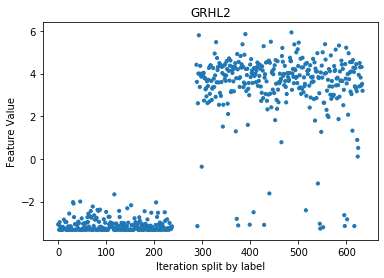

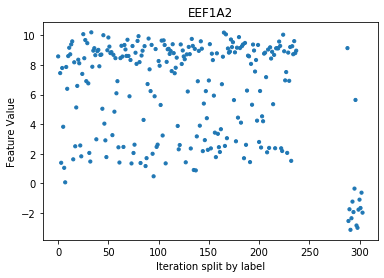

In [10]:
label1 = 0
label2 = 1
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'EEF1A2'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Brain


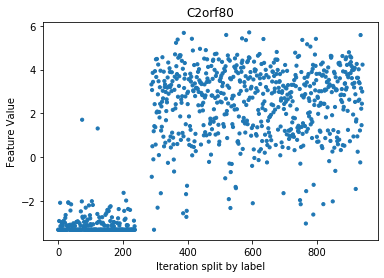

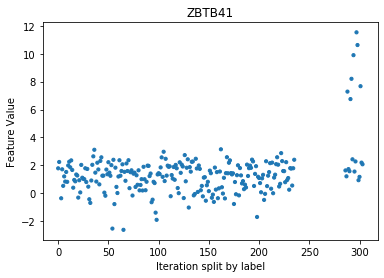

['GFAP', 'FAM181A', 'WDR49', 'CHI3L1', 'SOX21', 'BCAS1']
[0, 0, 0, 0, 0, 0]


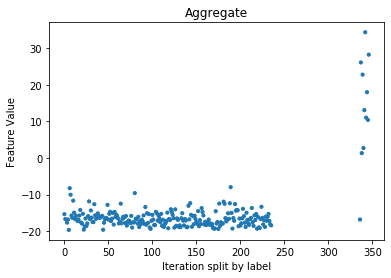

In [11]:
label1 = 0
label2 = 2
featurename = 'C2orf80'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZBTB41'
graphpairfeature(df, featurename, label1, label2, indexlist)


#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 4:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['GFAP', 'FAM181A', 'WDR49', 'CHI3L1', 'SOX21', 'BCAS1']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

14491
Labels being compared: Adrenal  and  Breast


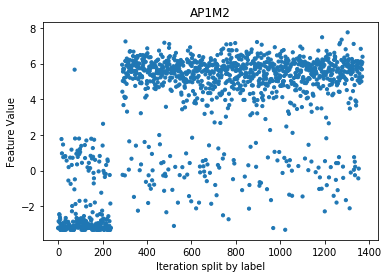

4166


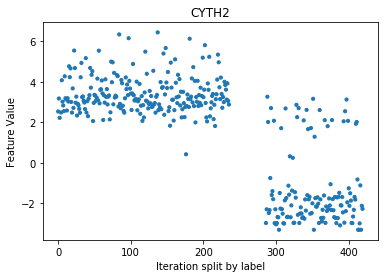

95
['PTPRH', 'PDCD1LG2', 'DSC2', 'IL16', 'TACR1', 'TNN']
[0, 1, 1, 1, 1, 1]


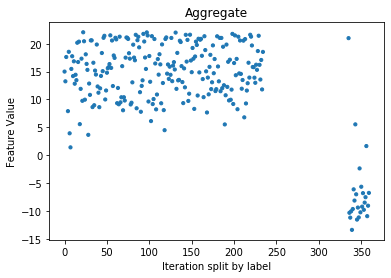

In [12]:
label1 = 0
label2 = 3
featurename = 'AP1M2'
print(featureindex(featurename))
    
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 2.1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CYTH2'
print(featureindex(featurename))
graphpairfeature(df, featurename, label1, label2, indexlist)


#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist


#new value
featurenamelist = ['PTPRH', 'PDCD1LG2', 'DSC2', 'IL16', 'TACR1', 'TNN']
print(featureindex(featurenamelist[0]))
reverse = [0, 1, 1, 1, 1, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Adrenal  and  Cervix
['CLDN4', 'MARVELD3', 'CDH1', 'RAB25', 'C15orf48', 'NAP1L2']
[0, 0, 0, 0, 0, 1]


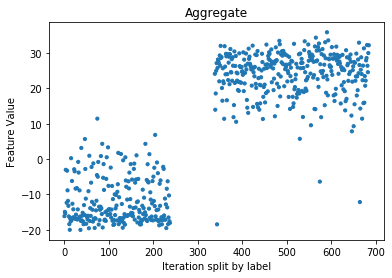

In [13]:
label1 = 0
label2 = 4
featurenamelist = ['CLDN4', 'MARVELD3', 'CDH1', 'RAB25', 'C15orf48', 'NAP1L2']
reverse = [0, 0, 0, 0, 0, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Adrenal  and  Colon
['TUSC3', 'CLDN4', 'GPR35', 'CRB3', 'CACNA2D1', 'ATP1B2']
[0, 1, 1, 1, 0, 0]


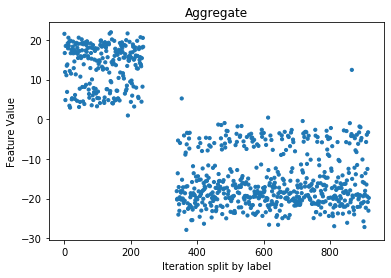

In [14]:
label1 = 0
label2 = 5
featurenamelist = ['TUSC3', 'CLDN4', 'GPR35', 'CRB3', 'CACNA2D1', 'ATP1B2']
reverse = [0, 1, 1, 1, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Adrenal  and  Esophagus


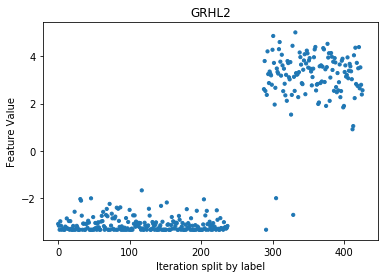

In [15]:
label1 = 0
label2 = 6
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Head


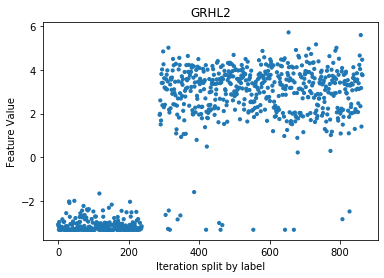

In [16]:
label1 = 0
label2 = 7
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Kidney
['HPN', 'CRB3', 'SPINT1', 'EMX2', 'HGD', 'DLK1']
[0, 0, 0, 0, 0, 1]


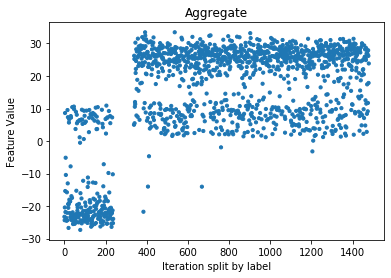

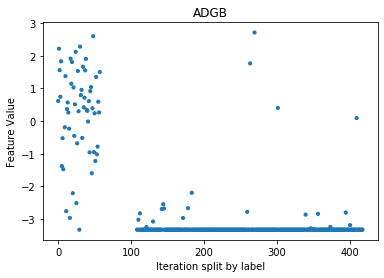

In [17]:
label1 = 0
label2 = 8
featurenamelist = ['HPN', 'CRB3', 'SPINT1', 'EMX2', 'HGD', 'DLK1']
reverse = [0, 0, 0, 0, 0, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 12.5 and v > -5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ADGB'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Leukemia
['NOL3', 'SPR', 'CCDC51', 'CAMKK1', 'TPM1', 'CCND1']
[0, 0, 0, 0, 0, 0]


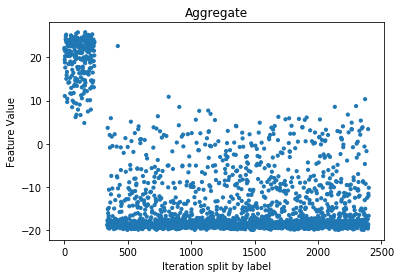

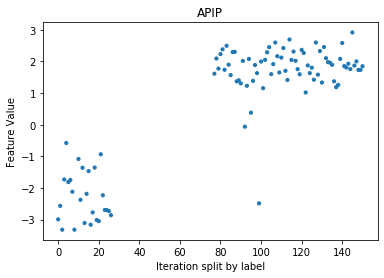

In [18]:
label1 = 0
label2 = 9
featurenamelist = ['NOL3', 'SPR', 'CCDC51', 'CAMKK1', 'TPM1', 'CCND1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 13 and v > 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'APIP'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Liver


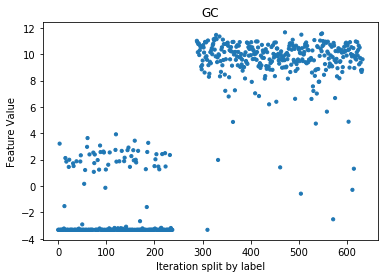

In [19]:
label1 = 0
label2 = 10
featurename = 'GC'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Lung


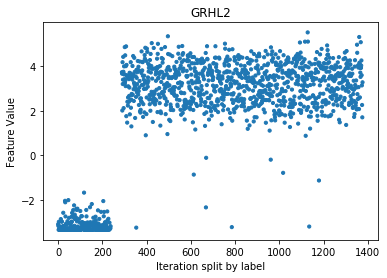

In [20]:
label1 = 0
label2 = 11
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Lymph


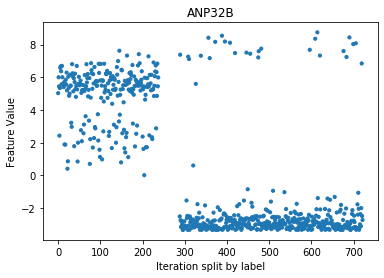

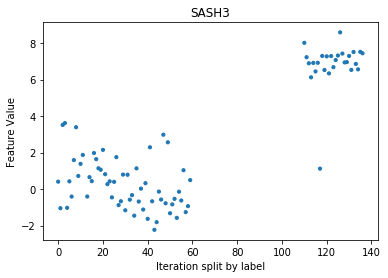

In [21]:
label1 = 0
label2 = 12
featurename = 'ANP32B'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 6:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'SASH3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Ovarian


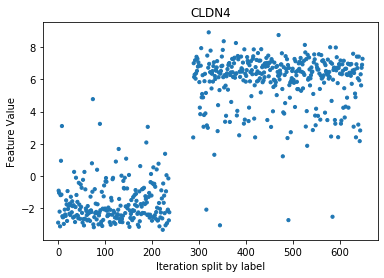

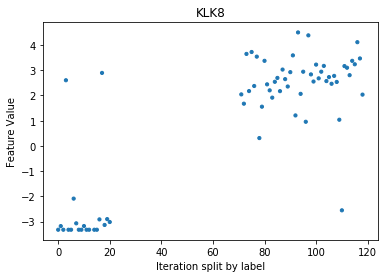

In [22]:
label1 = 0
label2 = 13
featurename = 'CLDN4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)


#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 4 and v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'KLK8'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Pancreas
['CLDN4', 'FA2H', 'SULT2B1', 'GRB7', 'HGD', 'RAB25']
[0, 0, 0, 0, 0, 0]


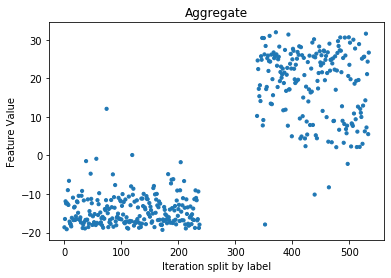

In [23]:
label1 = 0
label2 = 14
featurenamelist = ['CLDN4', 'FA2H', 'SULT2B1', 'GRB7', 'HGD', 'RAB25']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Adrenal  and  Peritoneum


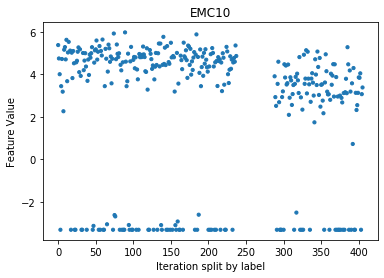

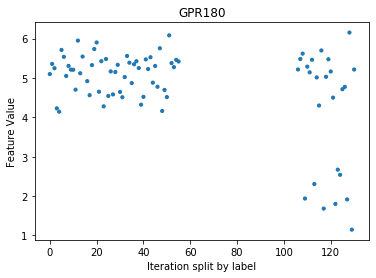

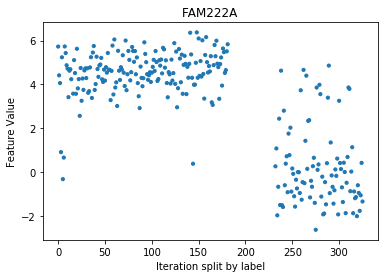

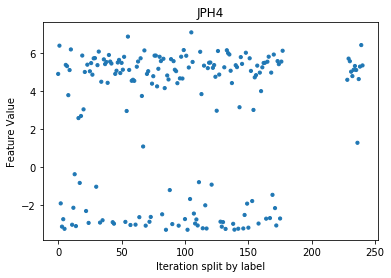

In [24]:
label1 = 0
label2 = 15
featurename = 'EMC10'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -1:
        
        tmpindexlist.append(i)
    
    if v > -1:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'GPR180'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'FAM222A'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 2.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'JPH4'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Prostate


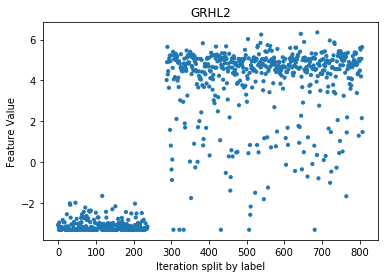

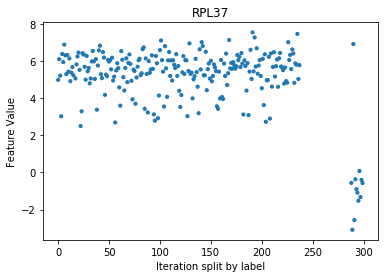

In [25]:
label1 = 0
label2 = 16
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)


#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'RPL37'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Sarcoma


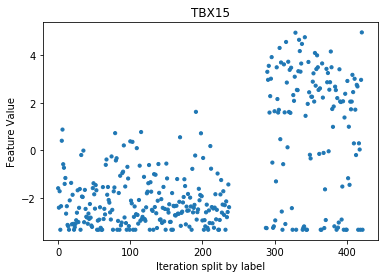

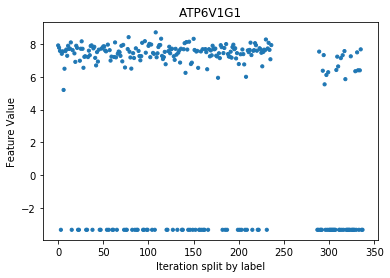

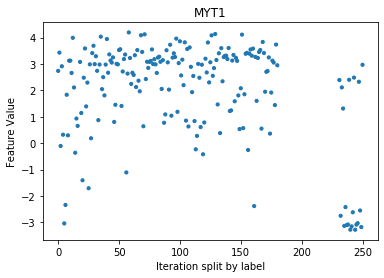

In [26]:
label1 = 0
label2 = 17
featurename = 'TBX15'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ATP6V1G1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 4:
        
        tmpindexlist.append(i)
        
    if v < -2:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist


#new value
featurename = 'MYT1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Skin
['BACE2', 'TFAP2A', 'FMN1', 'MITF', 'MMP14', 'HS6ST3']
[0, 0, 0, 0, 0, 1]


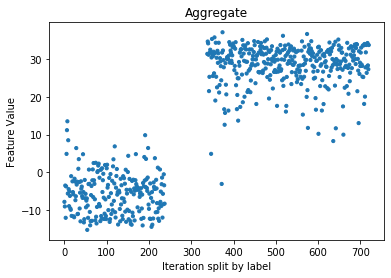

In [27]:
label1 = 0
label2 = 18
featurenamelist = ['BACE2', 'TFAP2A', 'FMN1', 'MITF', 'MMP14', 'HS6ST3']
reverse = [0, 0, 0, 0, 0, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Adrenal  and  Stomach
['AGR2', 'TMC5', 'PRR15L', 'AGR3', 'FA2H', 'LGALS4']
[0, 0, 0, 0, 0, 0]


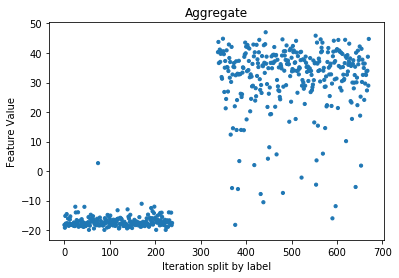

In [28]:
label1 = 0
label2 = 19
featurenamelist = ['AGR2', 'TMC5', 'PRR15L', 'AGR3', 'FA2H', 'LGALS4']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Adrenal  and  Testis


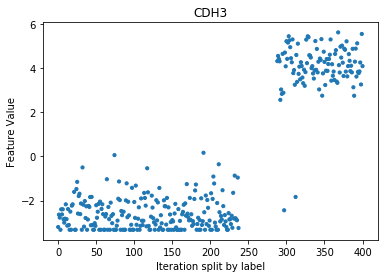

In [29]:
label1 = 0
label2 = 20
featurename = 'CDH3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Thyroid


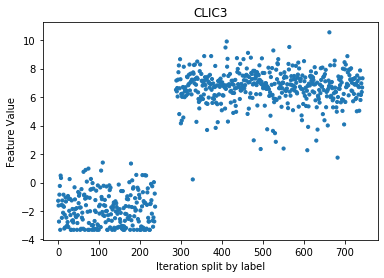

In [30]:
label1 = 0
label2 = 21
featurename = 'CLIC3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Adrenal  and  Uterus
['CDH3', 'CLDN4', 'IGSF9', 'SPINT1', 'GRHL2', 'ST14']
[0, 0, 0, 0, 0, 0]


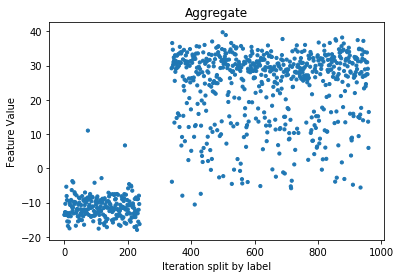

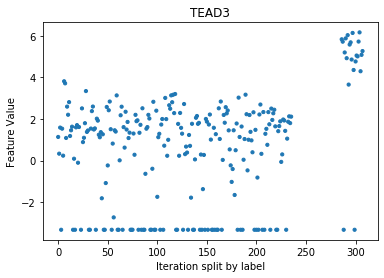

In [31]:
label1 = 0
label2 = 22
featurenamelist = ['CDH3', 'CLDN4', 'IGSF9', 'SPINT1', 'GRHL2', 'ST14']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < -1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TEAD3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Brain
['AQP4', 'MLC1', 'C1orf61', 'MT3', 'NCAN', 'LAD1']
[0, 0, 0, 0, 0, 1]


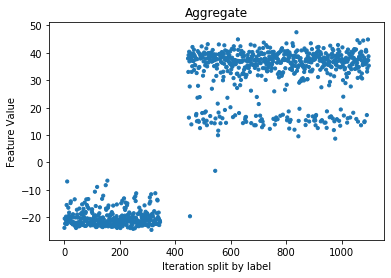

In [32]:
label1 = 1
label2 = 2
featurenamelist = ['AQP4', 'MLC1', 'C1orf61', 'MT3', 'NCAN', 'LAD1']
reverse = [0, 0, 0, 0, 0, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Bladder  and  Breast
['KIAA1324', 'PRLR', 'TMEM63C', 'LMX1B', 'LRIG1', 'GJB6']
[0, 0, 0, 0, 0, 1]


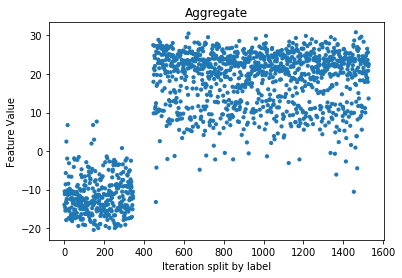

['SFRP1', 'MRAS', 'ZFP3', 'FZD7', 'MGP', 'AIF1L']
[0, 0, 0, 0, 0, 0]


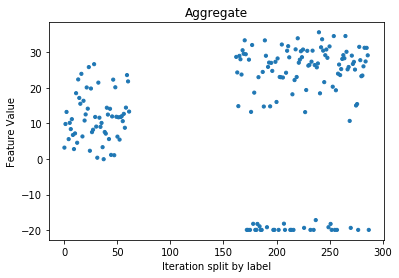

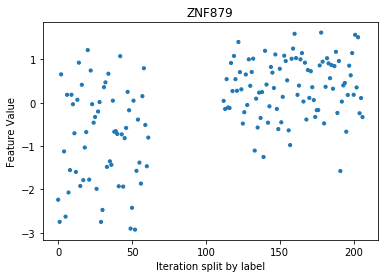

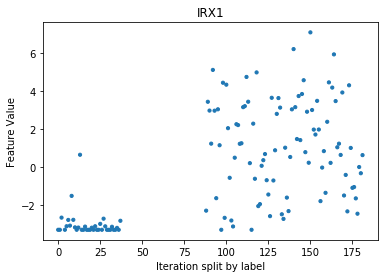

In [33]:
label1 = 1
label2 = 3
featurenamelist = ['KIAA1324', 'PRLR', 'TMEM63C', 'LMX1B', 'LRIG1', 'GJB6']
reverse = [0, 0, 0, 0, 0, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 9 and v > -7:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['SFRP1', 'MRAS', 'ZFP3', 'FZD7', 'MGP', 'AIF1L']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > -15:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZNF879'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > -1.3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'IRX1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Cervix
['PPARG', 'GATA3', 'MFAP3L', 'CAB39L', 'TBX3', 'TBX2']
[0, 0, 0, 0, 0, 0]


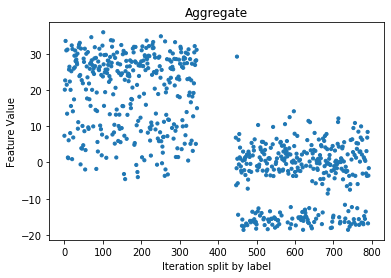

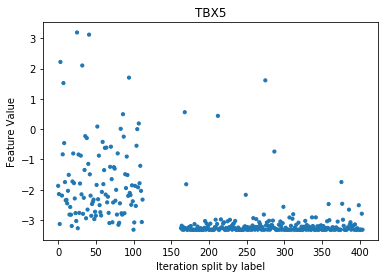

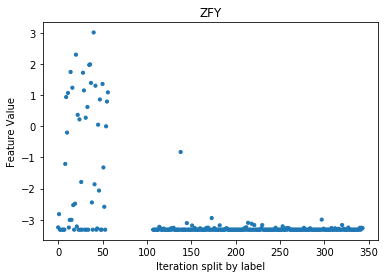

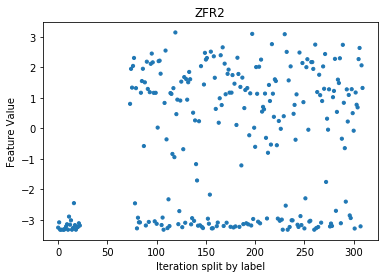

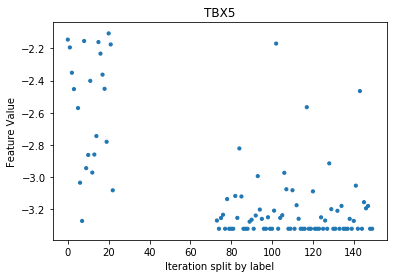

In [34]:
label1 = 1
label2 = 4
featurenamelist = ['PPARG', 'GATA3', 'MFAP3L', 'CAB39L', 'TBX3', 'TBX2']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 15 and v > -8:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TBX5'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -2.1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZFY'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -2.9:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZFR2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -2.2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TBX5'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Colon
['HNF1A', 'HNF4A', 'VIL1', 'GPR35', 'DDC', 'CDX1']
[0, 0, 0, 0, 0, 0]


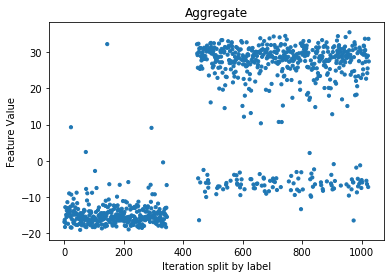

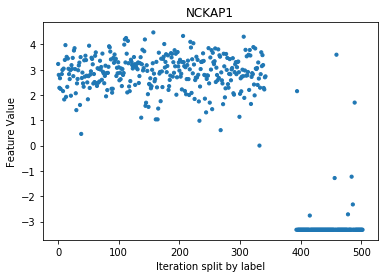

In [35]:
label1 = 1
label2 = 5
featurenamelist = ['HNF1A', 'HNF4A', 'VIL1', 'GPR35', 'DDC', 'CDX1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'NCKAP1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Esophagus
['POTEJ', 'POTEI', 'EIF3CL', 'F8A3', 'POTEE', 'MTRNR2L8']
[0, 0, 0, 0, 0, 0]


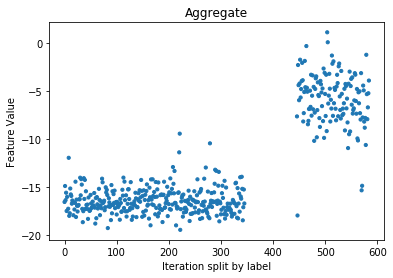

In [36]:
label1 = 1
label2 = 6
featurenamelist = ['POTEJ', 'POTEI', 'EIF3CL', 'F8A3', 'POTEE', 'MTRNR2L8']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Bladder  and  Head
['PTPRZ1', 'GOLT1A', 'GBP6', 'PPARG', 'GATA3', 'ACSF2']
[0, 1, 0, 1, 1, 1]


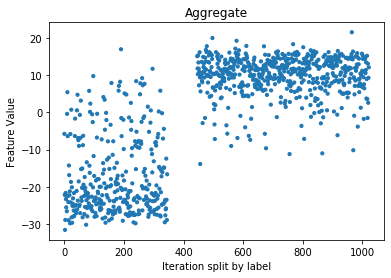

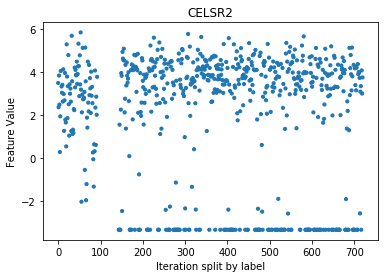

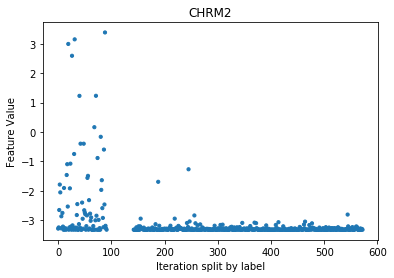

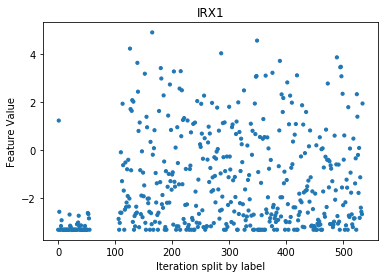

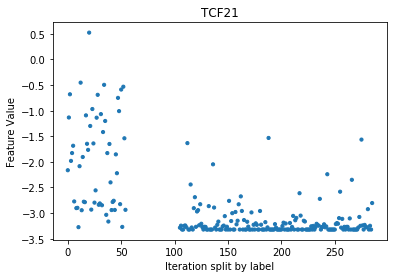

In [37]:
label1 = 1
label2 = 7
featurenamelist = ['PTPRZ1', 'GOLT1A', 'GBP6', 'PPARG', 'GATA3', 'ACSF2']
reverse = [0, 1, 0, 1, 1, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v > -13:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CELSR2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CHRM2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2.8:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'IRX1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2.2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TCF21'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Kidney


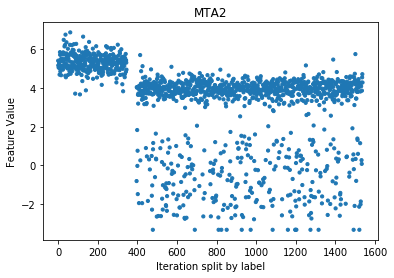

['CDH16', 'POU3F3', 'HPN', 'HGD', 'PAX2', 'SLC3A1']
[0, 0, 0, 0, 0, 0]


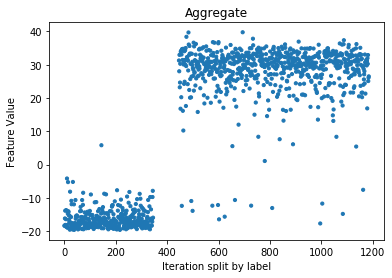

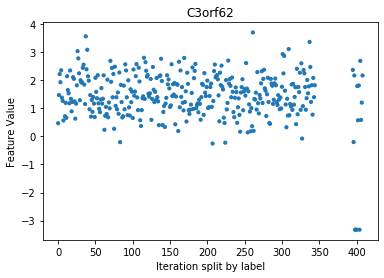

In [38]:
label1 = 1
label2 = 8
featurename = 'MTA2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 3.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['CDH16', 'POU3F3', 'HPN', 'HGD', 'PAX2', 'SLC3A1']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'C3orf62'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Leukemia


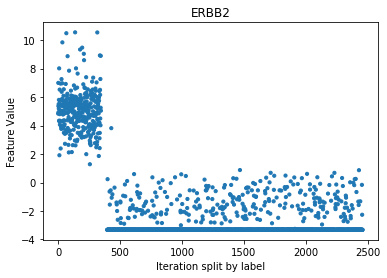

In [39]:
label1 = 1
label2 = 9
featurename = 'ERBB2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Liver


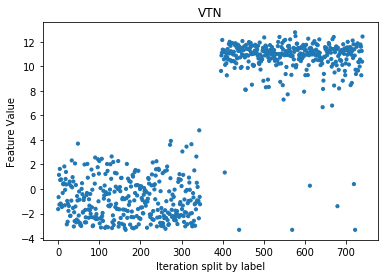

In [40]:
label1 = 1
label2 = 10
featurename = 'VTN'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Lung
['SLC34A2', 'SFTA3', 'SFTPA2', 'SLC22A31', 'SFTPB', 'SFTPA1']
[0, 0, 0, 0, 0, 0]


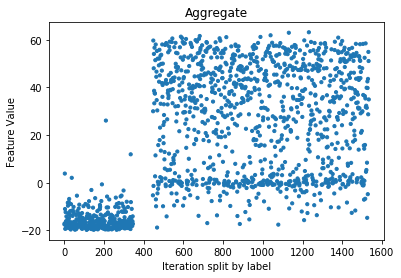

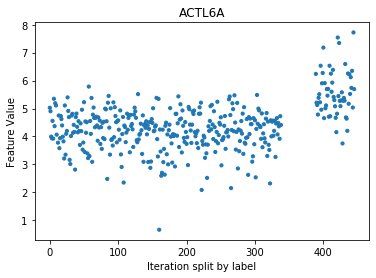

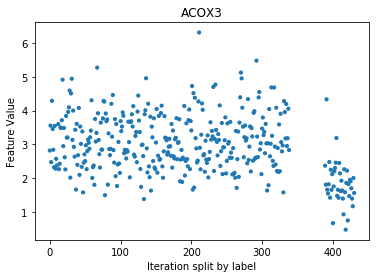

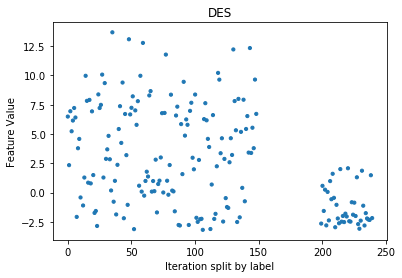

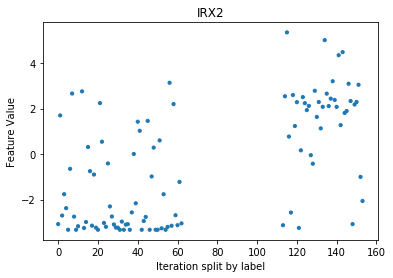

In [41]:
label1 = 1
label2 = 11
featurenamelist = ['SLC34A2', 'SFTA3', 'SFTPA2', 'SLC22A31', 'SFTPB', 'SFTPA1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < -4:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ACTL6A'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 6:

        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ACOX3'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 2.9:

        tmpindexlist.append(i)
indexlist = tmpindexlist

#plottop5features(df, bindf, label1, label2, indexlist)

#new value
featurename = 'DES'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 2.5:

        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'IRX2'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Lymph


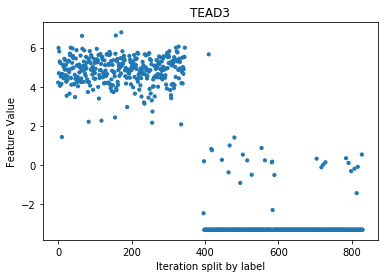

In [42]:
label1 = 1
label2 = 12
featurename = 'TEAD3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Ovarian
['ZNF467', 'WT1', 'SLC34A2', 'CRB2', 'S100P', 'FERMT1']
[0, 0, 0, 0, 1, 1]


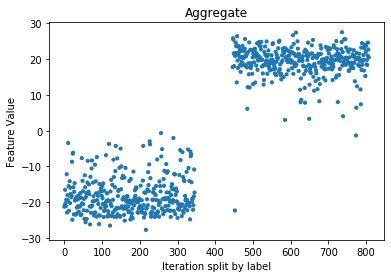

In [43]:
label1 = 1
label2 = 13
featurenamelist = ['ZNF467', 'WT1', 'SLC34A2', 'CRB2', 'S100P', 'FERMT1']
reverse = [0, 0, 0, 0, 1, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Bladder  and  Pancreas
['FOXA3', 'HNF1A', 'SLC6A20', 'TM4SF4', 'MYRF', 'HGD']
[0, 0, 0, 0, 0, 0]


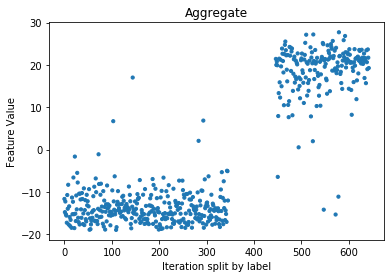

In [44]:
label1 = 1
label2 = 14
featurenamelist = ['FOXA3', 'HNF1A', 'SLC6A20', 'TM4SF4', 'MYRF', 'HGD']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Bladder  and  Peritoneum
['ESRP2', 'RAB25', 'GRHL2', 'KDF1', 'EPN3', 'ERBB3']
[0, 0, 0, 0, 0, 0]


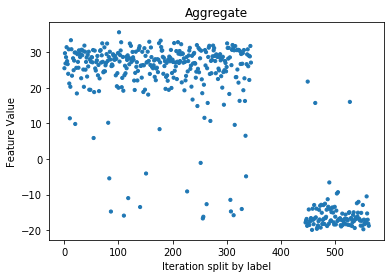

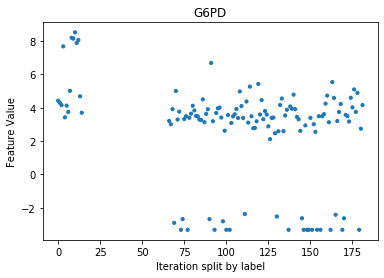

In [45]:
label1 = 1
label2 = 15
featurenamelist = ['ESRP2', 'RAB25', 'GRHL2', 'KDF1', 'EPN3', 'ERBB3']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'G6PD'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Prostate
['SLC45A3', 'STEAP2', 'CREB3L4', 'ABCC4', 'ANO7', 'KLK2']
[0, 0, 0, 0, 0, 0]


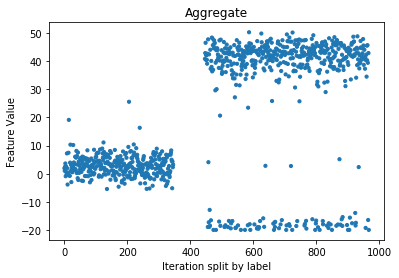

In [46]:
label1 = 1
label2 = 16
featurenamelist = ['SLC45A3', 'STEAP2', 'CREB3L4', 'ABCC4', 'ANO7', 'KLK2']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Bladder  and  Sarcoma


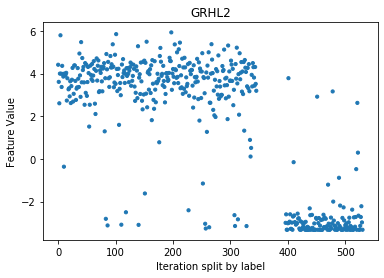

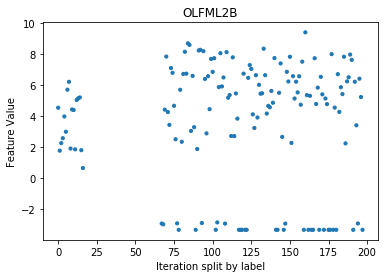

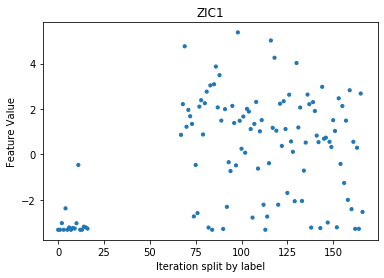

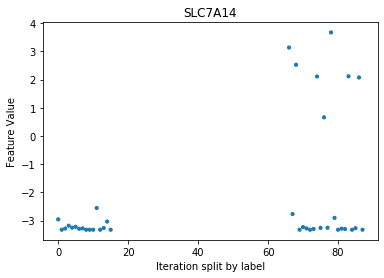

In [47]:
label1 = 1
label2 = 17
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist


#new value
featurename = 'OLFML2B'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZIC1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'SLC7A14'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Skin


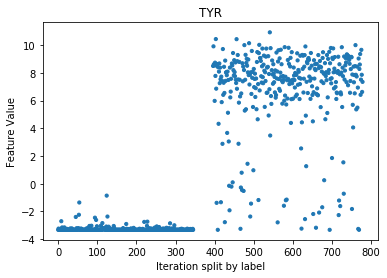

['KRT19', 'RAB25', 'AP1M2', 'TACSTD2', 'KDF1', 'ELF3']
[0, 0, 0, 0, 0, 0]


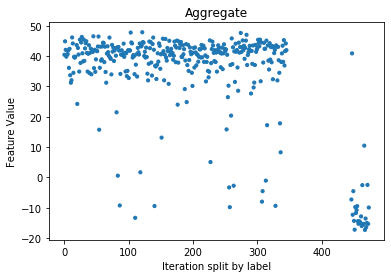

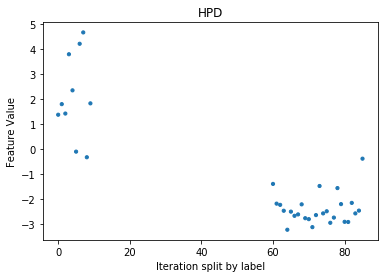

In [48]:
label1 = 1
label2 = 18
featurename = 'TYR'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['KRT19', 'RAB25', 'AP1M2', 'TACSTD2', 'KDF1', 'ELF3']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'HPD'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Stomach


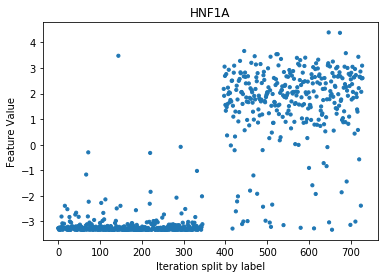

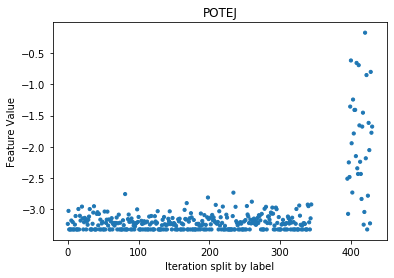

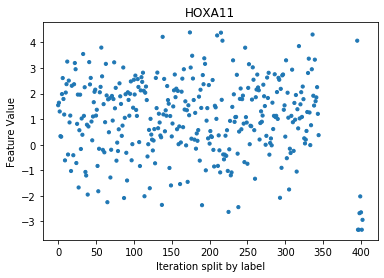

In [49]:
label1 = 1
label2 = 19
featurename = 'HNF1A'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'POTEJ'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2.65:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'HOXA11'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Testis
['PHC1', 'L1TD1', 'TET1', 'CACNA2D2', 'SLC4A8', 'VRTN']
[0, 0, 0, 0, 0, 0]


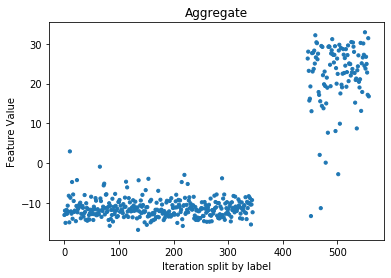

In [50]:
label1 = 1
label2 = 20
featurenamelist = ['PHC1', 'L1TD1', 'TET1', 'CACNA2D2', 'SLC4A8', 'VRTN']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Bladder  and  Thyroid


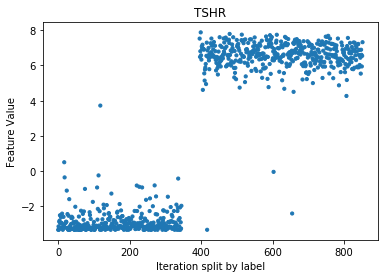

In [51]:
label1 = 1
label2 = 21
featurename = 'TSHR'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Bladder  and  Uterus
['SALL1', 'ASRGL1', 'STXBP6', 'SLC34A2', 'ARHGAP23', 'CSTA']
[0, 0, 0, 0, 1, 1]


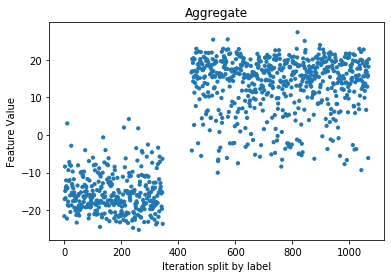

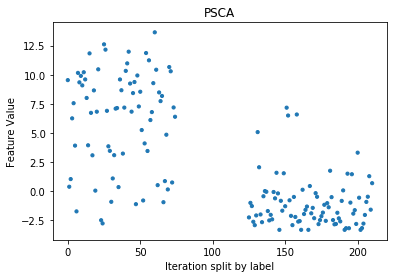

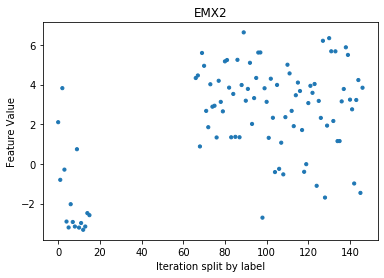

In [52]:
label1 = 1
label2 = 22
featurenamelist = ['SALL1', 'ASRGL1', 'STXBP6', 'SLC34A2', 'ARHGAP23', 'CSTA']
reverse = [0, 0, 0, 0, 1, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)


#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 5 and v > -12:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PSCA'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 2.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'EMX2'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Breast


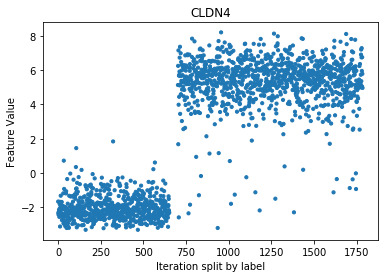

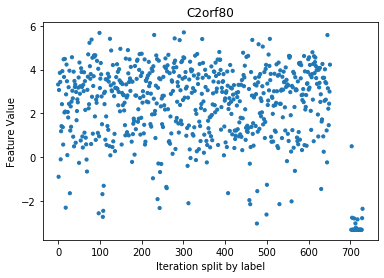

In [53]:
label1 = 2
label2 = 3
featurename = 'CLDN4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'C2orf80'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Cervix


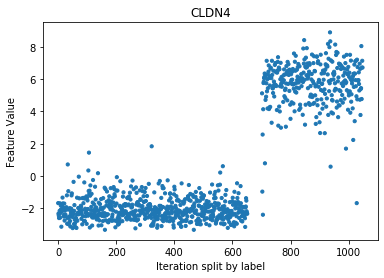

In [54]:
label1 = 2
label2 = 4
featurename = 'CLDN4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Colon


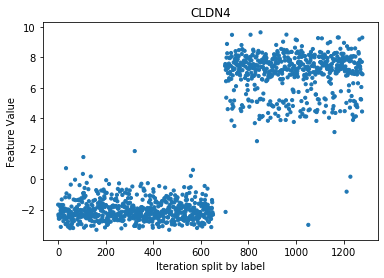

In [55]:
label1 = 2
label2 = 5
featurename = 'CLDN4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Esophagus


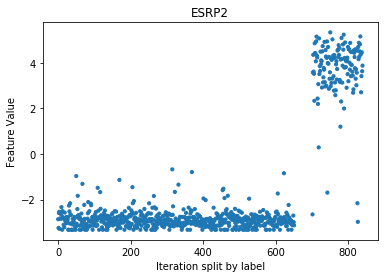

In [56]:
label1 = 2
label2 = 6
featurename = 'ESRP2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Head


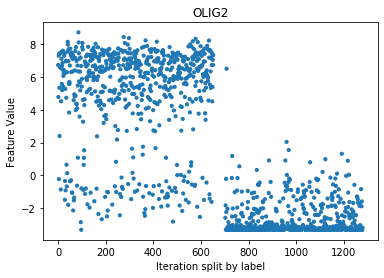

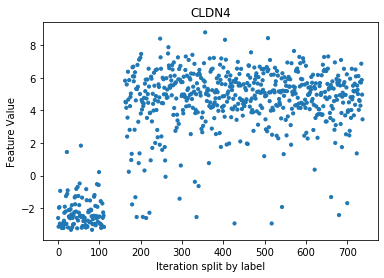

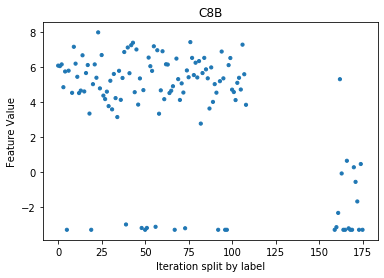

In [57]:
label1 = 2
label2 = 7
featurename = 'OLIG2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CLDN4'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'C8B'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Kidney


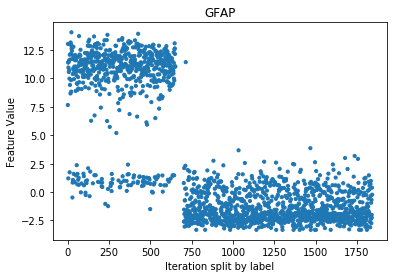

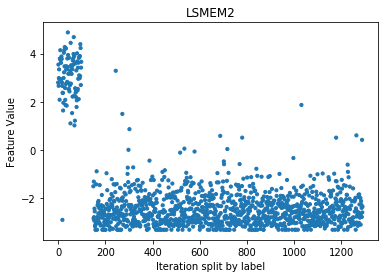

In [58]:
label1 = 2
label2 = 8
featurename = 'GFAP'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 4.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'LSMEM2'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Leukemia
['SPAG16', 'MAP1B', 'APC2', 'SMAD9', 'TLN2', 'OSBPL6']
[0, 0, 0, 0, 0, 0]


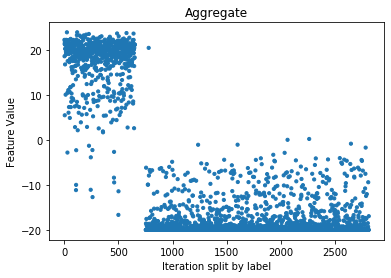

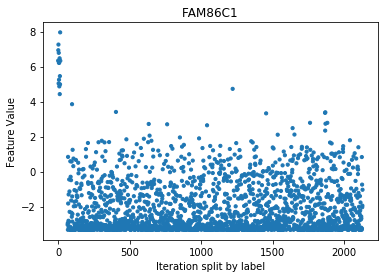

In [59]:
label1 = 2
label2 = 9
featurenamelist = ['SPAG16', 'MAP1B', 'APC2', 'SMAD9', 'TLN2', 'OSBPL6']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'FAM86C1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Liver
['SCRG1', 'PTPRZ1', 'C1orf61', 'AMBP', 'HNF4A', 'FAM181B']
[0, 0, 0, 1, 1, 0]


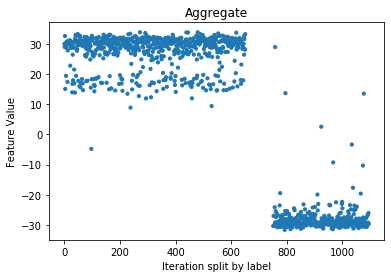

In [60]:
label1 = 2
label2 = 10
featurenamelist = ['SCRG1', 'PTPRZ1', 'C1orf61', 'AMBP', 'HNF4A', 'FAM181B']
reverse = [0, 0, 0, 1, 1, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Brain  and  Lung


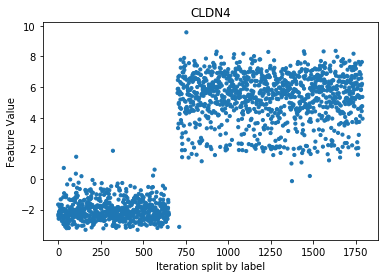

In [61]:
label1 = 2
label2 = 11
featurename = 'CLDN4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Lymph


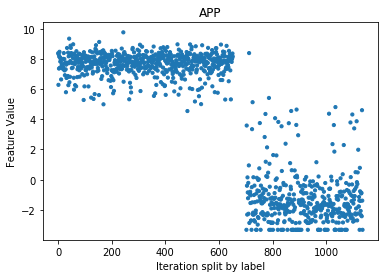

In [62]:
label1 = 2
label2 = 12
featurename = 'APP'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Ovarian


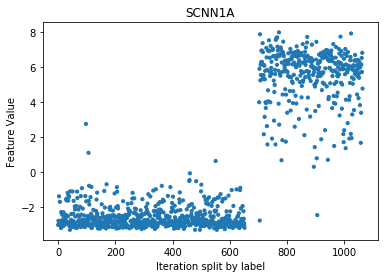

In [63]:
label1 = 2
label2 = 13
featurename = 'SCNN1A'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Pancreas


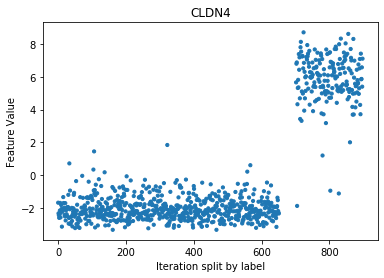

In [64]:
label1 = 2
label2 = 14
featurename = 'CLDN4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Peritoneum
['C2orf80', 'OLIG1', 'C1orf61', 'OLIG1', 'OLIG2', 'PTPRZ1']
[0, 0, 0, 0, 0, 0]


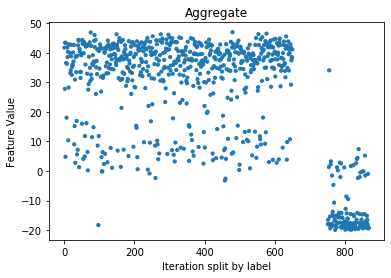

['EIF2B5', 'MSL3', 'C11orf71', 'NEMP2', 'ZBTB41', 'MCM8']
[0, 0, 0, 0, 0, 0]


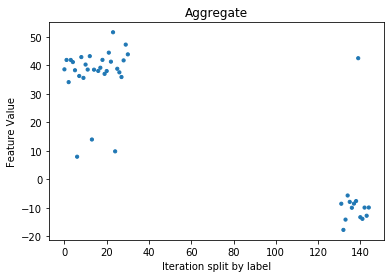

In [65]:
label1 = 2
label2 = 15
featurenamelist = ['C2orf80', 'OLIG1', 'C1orf61', 'OLIG1', 'OLIG2', 'PTPRZ1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 5 and v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['EIF2B5', 'MSL3', 'C11orf71', 'NEMP2', 'ZBTB41', 'MCM8']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Brain  and  Prostate
['SCNN1A', 'CLDN4', 'C1orf61', 'TACSTD2', 'AP1M2', 'PRR15L']
[0, 0, 1, 0, 0, 0]


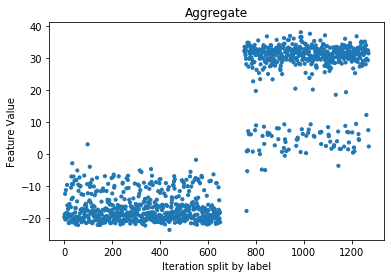

In [66]:
label1 = 2
label2 = 16
featurenamelist = ['SCNN1A', 'CLDN4', 'C1orf61', 'TACSTD2', 'AP1M2', 'PRR15L']
reverse = [0, 0, 1, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Brain  and  Sarcoma


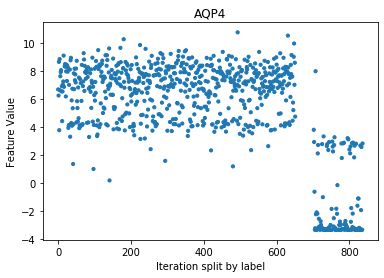

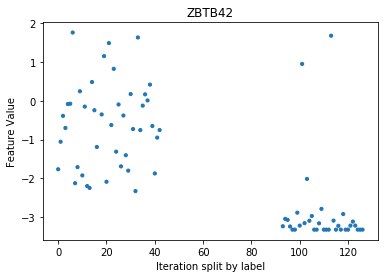

In [67]:
label1 = 2
label2 = 17
featurename = 'AQP4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 0.5 and v < 4:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZBTB42'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Skin
['AQP4', 'C1orf61', 'GRIK5', 'NCAN', 'GFAP', 'MLC1']
[0, 0, 0, 0, 0, 0]


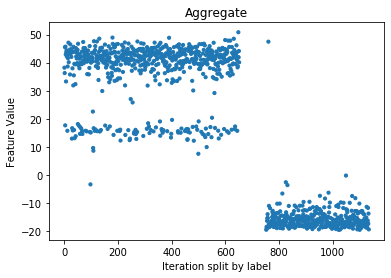

In [68]:
label1 = 2
label2 = 18
featurenamelist = ['AQP4', 'C1orf61', 'GRIK5', 'NCAN', 'GFAP', 'MLC1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Brain  and  Stomach
['AQP4', 'C1orf61', 'GRIK5', 'NCAN', 'GFAP', 'MLC1']
[0, 0, 0, 0, 0, 0]


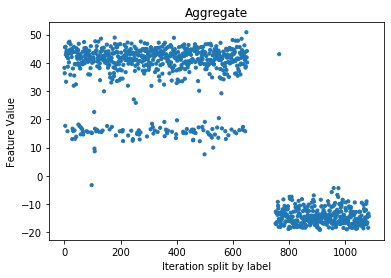

In [69]:
label1 = 2
label2 = 19
featurenamelist = ['AQP4', 'C1orf61', 'GRIK5', 'NCAN', 'GFAP', 'MLC1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Brain  and  Testis


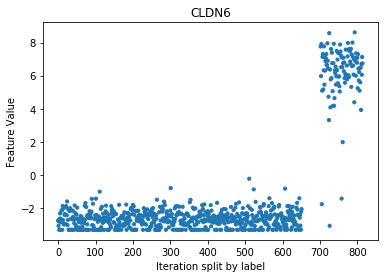

In [70]:
label1 = 2
label2 = 20
featurename = 'CLDN6'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Thyroid


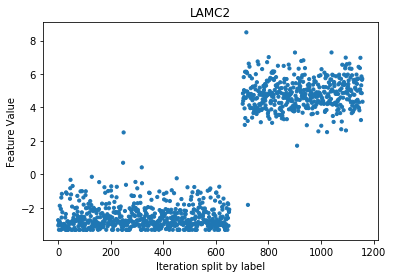

In [71]:
label1 = 2
label2 = 21
featurename = 'LAMC2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Brain  and  Uterus


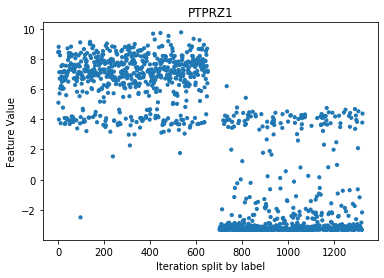

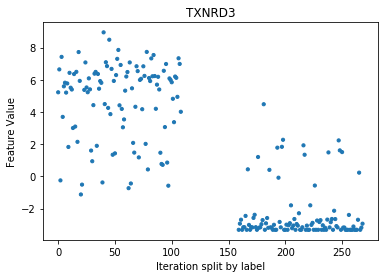

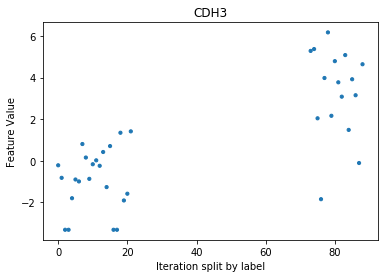

In [72]:
label1 = 2
label2 = 22
featurename = 'PTPRZ1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 5 and v > 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TXNRD3'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 3 and v > -1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CDH3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Breast  and  Cervix


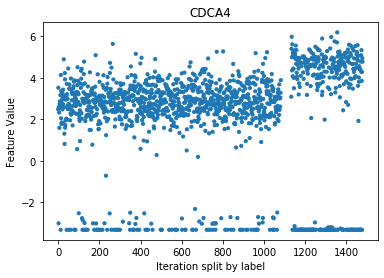

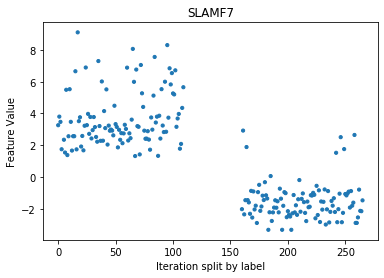

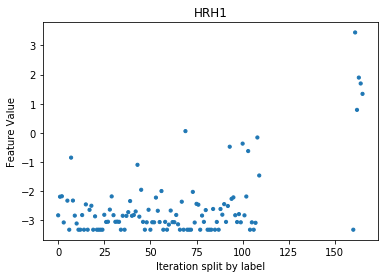

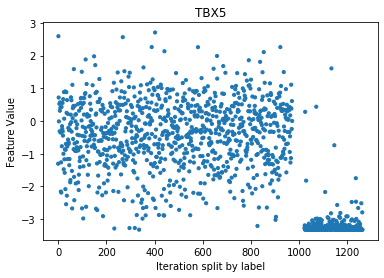

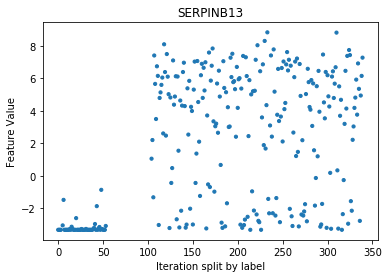

['AARD', 'TRPS1', 'ID1', 'ST6GALNAC1', 'TMPRSS4', 'PCSK9']
[0, 0, 1, 1, 1, 1]


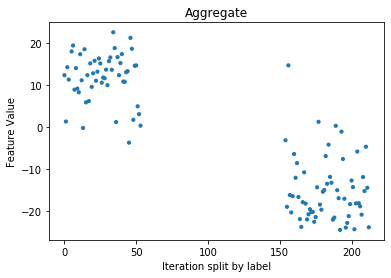

In [73]:
label1 = 3
label2 = 4
featurename = 'CDCA4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist2 = list()
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -1.5:
        
        tmpindexlist.append(i)
        
    if v > -1.5:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'SLAMF7'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'HRH1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#Other side of split
indexlist = tmpindexlist2

#new value
featurename = 'TBX5'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2.2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'SERPINB13'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['AARD', 'TRPS1', 'ID1', 'ST6GALNAC1', 'TMPRSS4', 'PCSK9']
reverse = [0, 0, 1, 1, 1, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Breast  and  Colon
['HNF4A', 'EPS8L3', 'VIL1', 'HNF1A', 'IHH', 'CDX2']
[0, 0, 0, 0, 0, 0]


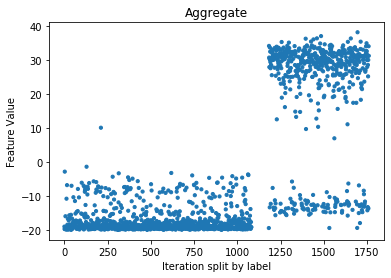

['SLC22A25', 'GANAB', 'ADGRE3', 'AIRE', 'OR5K1', 'FGF19']
[0, 1, 0, 0, 0, 0]


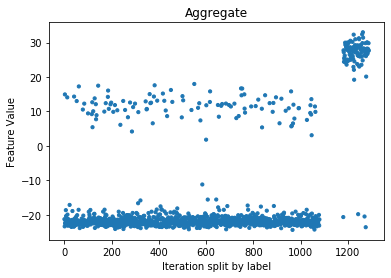

In [74]:
label1 = 3
label2 = 5
featurenamelist = ['HNF4A', 'EPS8L3', 'VIL1', 'HNF1A', 'IHH', 'CDX2']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['SLC22A25', 'GANAB', 'ADGRE3', 'AIRE', 'OR5K1', 'FGF19']
reverse = [0, 1, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Breast  and  Esophagus
['F8A3', 'GJD3', 'EIF3CL', 'RPS4Y1', 'DUOXA2', 'ZFY']
[0, 0, 0, 0, 0, 0]


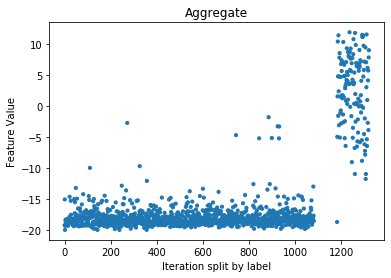

In [75]:
label1 = 3
label2 = 6
featurenamelist = ['F8A3', 'GJD3', 'EIF3CL', 'RPS4Y1', 'DUOXA2', 'ZFY']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Breast  and  Head
['IL1A', 'IL36G', 'C10orf99', 'SERPINB13', 'PLA2G4E', 'CERS3']
[0, 0, 0, 0, 0, 0]


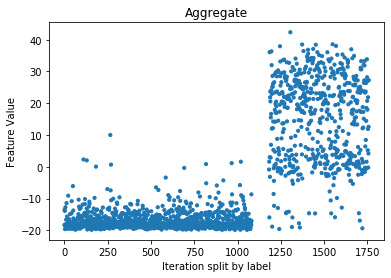

['ZNF24', 'WASL', 'SCAMP1', 'WAPL', 'SS18', 'UBA3']
[0, 0, 0, 0, 0, 0]


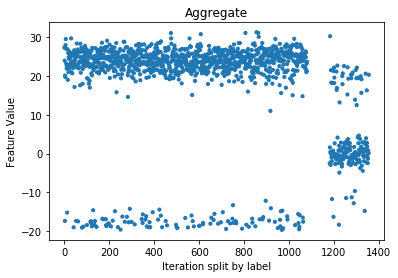

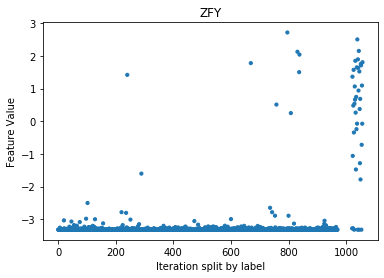

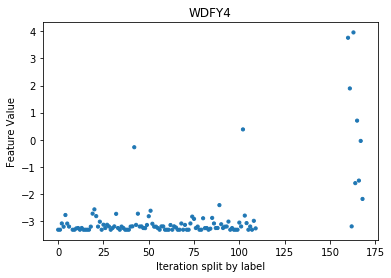

In [76]:
label1 = 3
label2 = 7
featurenamelist = ['IL1A', 'IL36G', 'C10orf99', 'SERPINB13', 'PLA2G4E', 'CERS3']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['ZNF24', 'WASL', 'SCAMP1', 'WAPL', 'SS18', 'UBA3']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > 9:
        
        tmpindexlist.append(i)
        
    if v < -9:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZFY'
graphpairfeature(df, featurename, label1, label2, indexlist)

indexlist = tmpindexlist2

#new value
featurename = 'WDFY4'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Breast  and  Kidney
['EMX2', 'SALL1', 'OGDHL', 'POU3F3', 'SLC22A2', 'SULT1C2']
[0, 0, 0, 0, 0, 0]


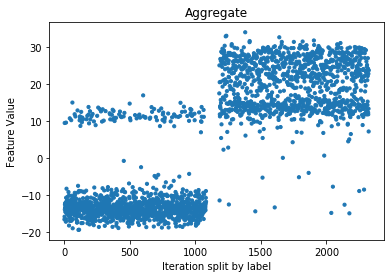

['CATSPER1', 'OR4F6', 'PTP4A2', 'ST3GAL5', 'LSMEM2', 'TAZ']
[0, 0, 1, 1, 0, 1]


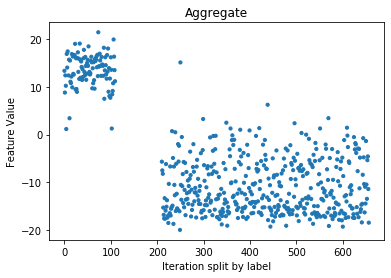

In [77]:
label1 = 3
label2 = 8
featurenamelist = ['EMX2', 'SALL1', 'OGDHL', 'POU3F3', 'SLC22A2', 'SULT1C2']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 17 and v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['CATSPER1', 'OR4F6', 'PTP4A2', 'ST3GAL5', 'LSMEM2', 'TAZ']
reverse = [0, 0, 1, 1, 0, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Breast  and  Leukemia
['FKBP10', 'COL4A2', 'CLDN4', 'TMEM54', 'COL3A1', 'COL1A2']
[0, 0, 0, 0, 0, 0]


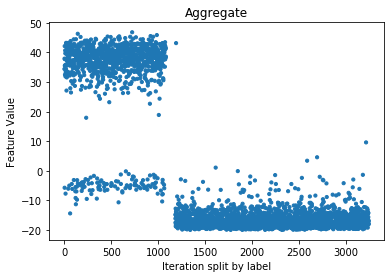

['MEP1A', 'GAPDHS', 'KLK10', 'DPYSL5', 'RHBG', 'DCT']
[0, 0, 0, 0, 0, 0]


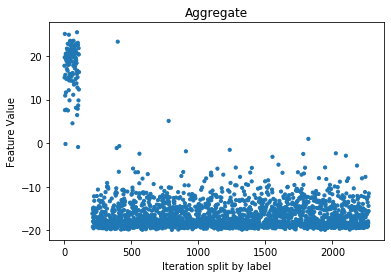

In [78]:
label1 = 3
label2 = 9
featurenamelist = ['FKBP10', 'COL4A2', 'CLDN4', 'TMEM54', 'COL3A1', 'COL1A2']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 15:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['MEP1A', 'GAPDHS', 'KLK10', 'DPYSL5', 'RHBG', 'DCT']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Breast  and  Liver


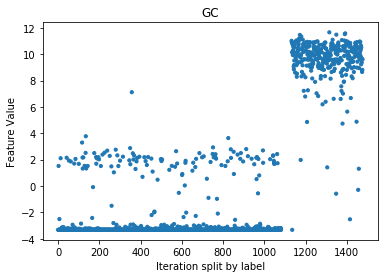

In [79]:
label1 = 3
label2 = 10
featurename = 'GC'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Breast  and  Lung
['FOXF1', 'TBX4', 'SFTPA1', 'SFTPB', 'SFTPC', 'KCNJ15']
[0, 0, 0, 0, 0, 0]


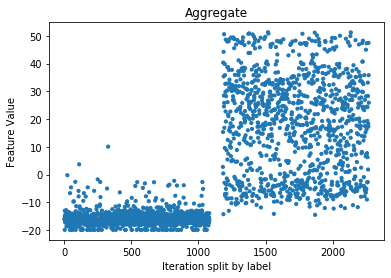

['CREB3L4', 'TSTD1', 'ARFIP2', 'DLG3', 'ERGIC1', 'SELENBP1']
[0, 0, 0, 0, 0, 0]


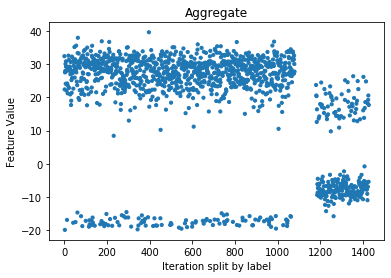

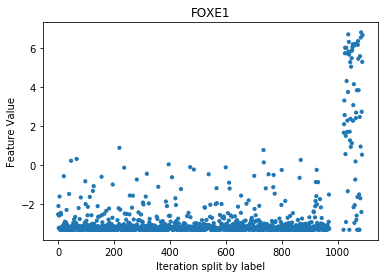

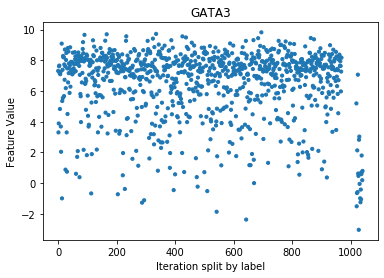

['SFTPB', 'SFTPA1', 'SFTPA2', 'WDR72', 'MAP3K19', 'ANKRD18B']
[0, 0, 0, 0, 0, 0]


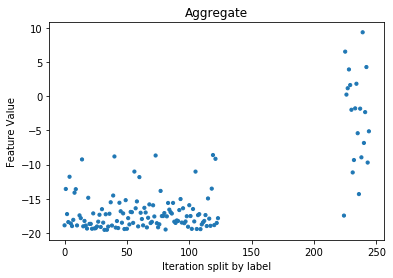

In [80]:
label1 = 3
label2 = 11
featurenamelist = ['FOXF1', 'TBX4', 'SFTPA1', 'SFTPB', 'SFTPC', 'KCNJ15']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['CREB3L4', 'TSTD1', 'ARFIP2', 'DLG3', 'ERGIC1', 'SELENBP1']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'FOXE1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:    
    v = list(df[featurename])[i]
    
    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'GATA3'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 4:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['SFTPB', 'SFTPA1', 'SFTPA2', 'WDR72', 'MAP3K19', 'ANKRD18B']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Breast  and  Lymph
['ST6GALNAC2', 'SLC2A10', 'IRX5', 'CCDC149', 'GATA3', 'HID1']
[0, 0, 0, 0, 0, 0]


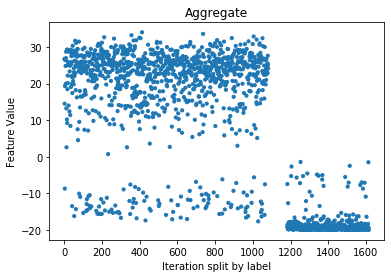

['TREML4', 'WNT7A', 'DPYSL5', 'ARL17A', 'MEP1A', 'OR4F6']
[0, 0, 0, 0, 0, 0]


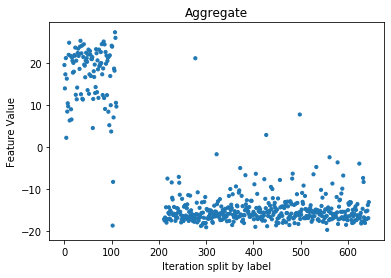

In [81]:
label1 = 3
label2 = 12
featurenamelist = ['ST6GALNAC2', 'SLC2A10', 'IRX5', 'CCDC149', 'GATA3', 'HID1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['TREML4', 'WNT7A', 'DPYSL5', 'ARL17A', 'MEP1A', 'OR4F6']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Breast  and  Ovarian
['EMX2', 'FAM181A', 'CLDN16', 'KLHL14', 'WNT7A', 'UPK3B']
[0, 0, 0, 0, 0, 0]


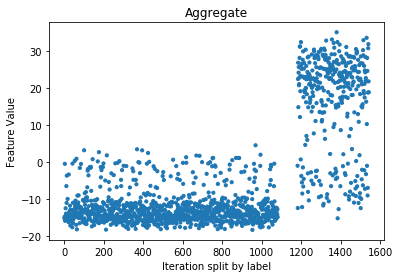

['SQSTM1', 'DCP1A', 'ANO10', 'TTLL8', 'SGTA', 'PPA2']
[0, 0, 0, 1, 0, 0]


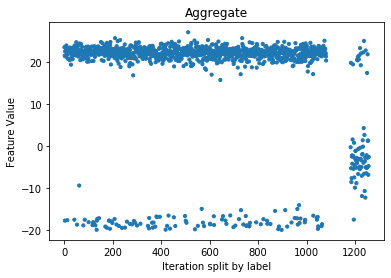

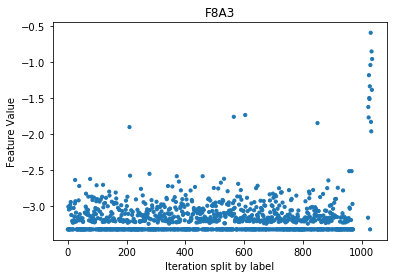

In [82]:
label1 = 3
label2 = 13
featurenamelist = ['EMX2', 'FAM181A', 'CLDN16', 'KLHL14', 'WNT7A', 'UPK3B']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['SQSTM1', 'DCP1A', 'ANO10', 'TTLL8', 'SGTA', 'PPA2']
reverse = [0, 0, 0, 1, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v > 10:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'F8A3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Breast  and  Pancreas


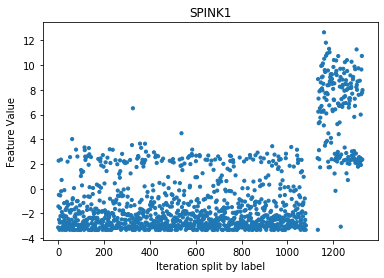

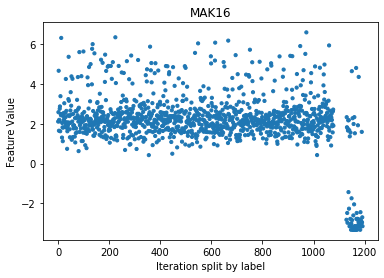

['USH1C', 'SMIM24', 'FOXA2', 'HKDC1', 'LGALS4', 'HHLA2']
[0, 0, 0, 0, 0, 0]


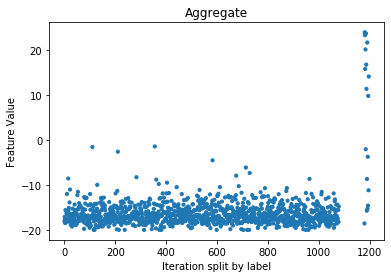

In [83]:
label1 = 3
label2 = 14
featurename = 'SPINK1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 4:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'MAK16'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['USH1C', 'SMIM24', 'FOXA2', 'HKDC1', 'LGALS4', 'HHLA2']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Breast  and  Peritoneum


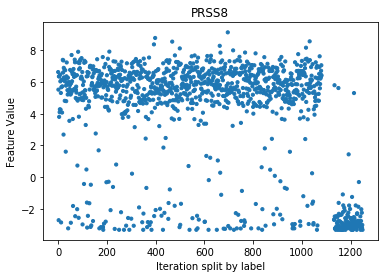

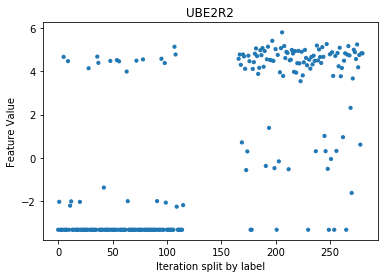

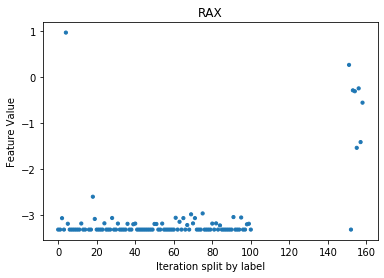

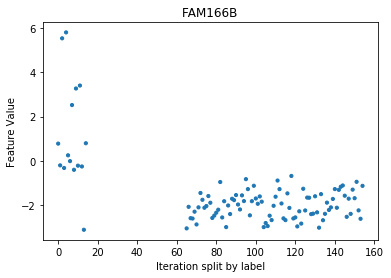

In [84]:
label1 = 3
label2 = 15
featurename = 'PRSS8'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'UBE2R2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -1:
        
        tmpindexlist.append(i)
        
    if v > 3:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'RAX'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'FAM166B'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Breast  and  Prostate


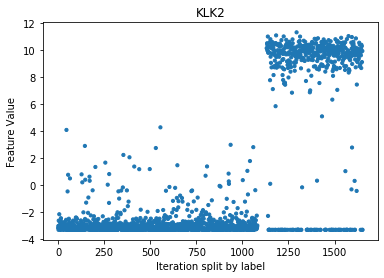

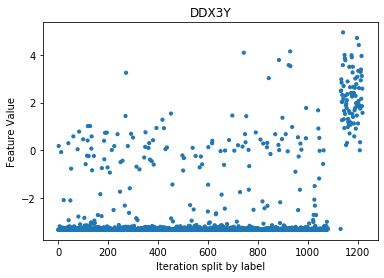

['TMEFF2', 'SRL', 'TBX19', 'AGBL4', 'RHAG', 'WNK3']
[0, 0, 0, 0, 0, 0]


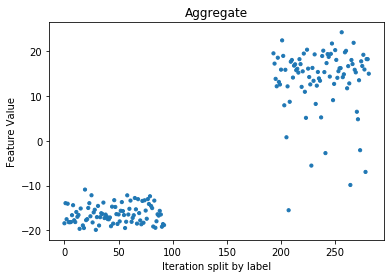

In [85]:
label1 = 3
label2 = 16
featurename = 'KLK2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'DDX3Y'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['TMEFF2', 'SRL', 'TBX19', 'AGBL4', 'RHAG', 'WNK3']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Breast  and  Sarcoma


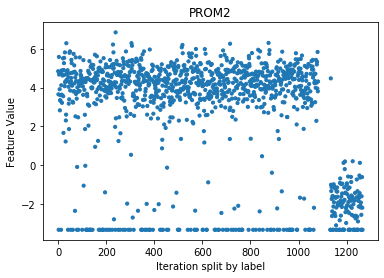

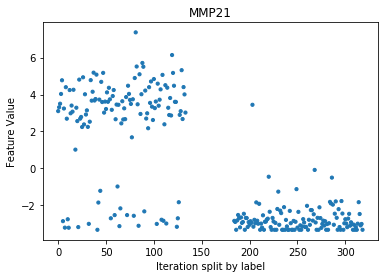

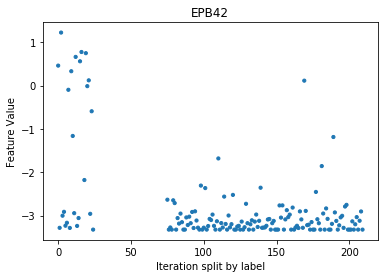

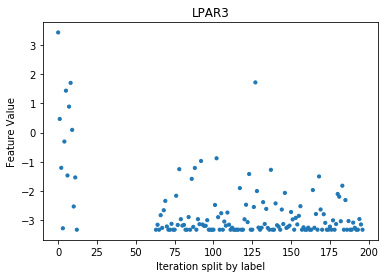

In [86]:
label1 = 3
label2 = 17
featurename = 'PROM2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'MMP21'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'EPB42'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'LPAR3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Breast  and  Skin


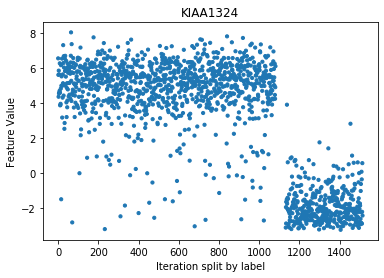

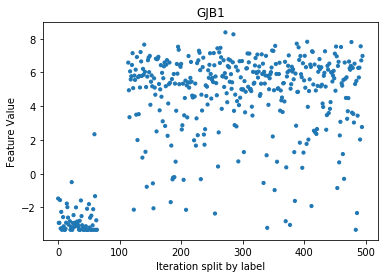

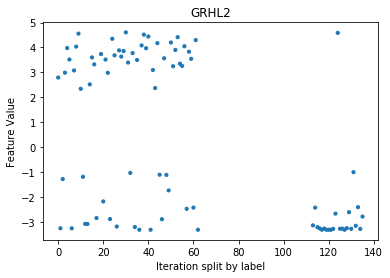

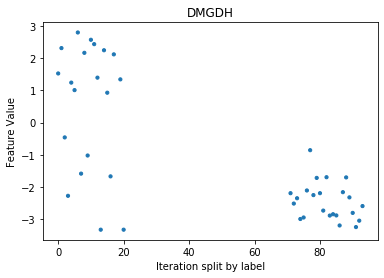

In [87]:
label1 = 3
label2 = 18
featurename = 'KIAA1324'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'GJB1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'GRHL2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'DMGDH'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Breast  and  Stomach
['FOXF1', 'ISL1', 'LGALS4', 'GJD3', 'CDHR5', 'CTSE']
[0, 0, 0, 0, 0, 0]


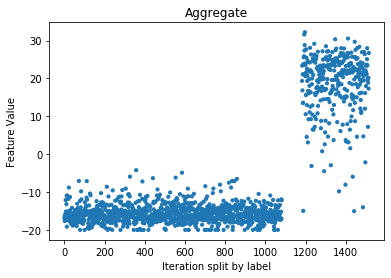

In [88]:
label1 = 3
label2 = 19
featurenamelist = ['FOXF1', 'ISL1', 'LGALS4', 'GJD3', 'CDHR5', 'CTSE']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Breast  and  Testis


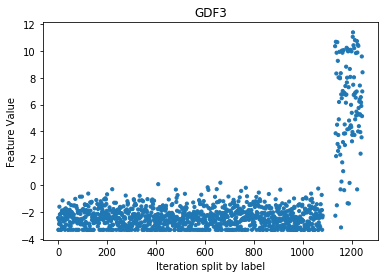

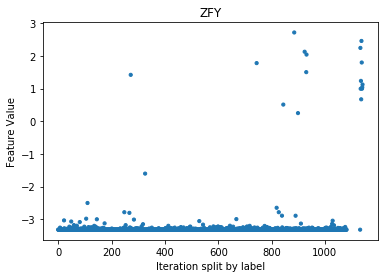

In [89]:
label1 = 3
label2 = 20
featurename = 'GDF3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZFY'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Breast  and  Thyroid


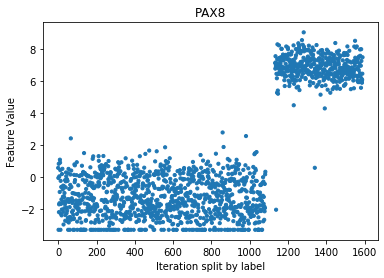

In [90]:
label1 = 3
label2 = 21
featurename = 'PAX8'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Breast  and  Uterus
['MECOM', 'SOX17', 'MEIS1', 'CFI', 'FGF18', 'ID1']
[0, 0, 0, 0, 0, 0]


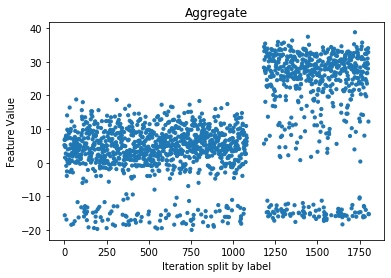

['IRX2', 'C5orf38', 'AZGP1', 'LMX1B', 'KIAA1324', 'CLMN']
[0, 0, 0, 0, 0, 0]


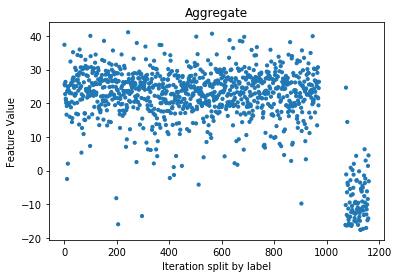

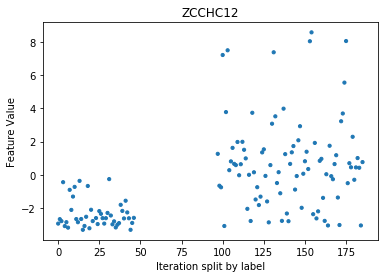

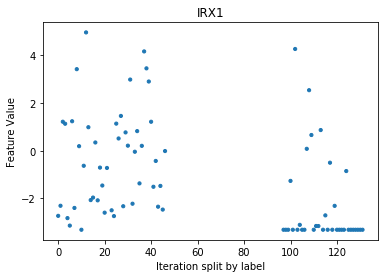

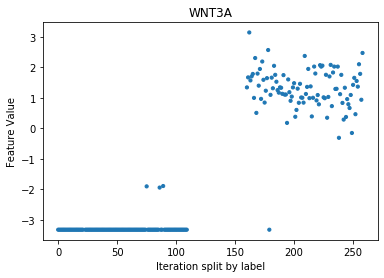

In [91]:
label1 = 3
label2 = 22
featurenamelist = ['MECOM', 'SOX17', 'MEIS1', 'CFI', 'FGF18', 'ID1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist2 = list()
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 20 and v > -10:
        
        tmpindexlist.append(i)
        
    if v < -10:
        
        tmpindexlist2.append(i)
        
indexlist = tmpindexlist

#new value
featurenamelist = ['IRX2', 'C5orf38', 'AZGP1', 'LMX1B', 'KIAA1324', 'CLMN']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 10:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZCCHC12'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist


#new value
featurename = 'IRX1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'WNT3A'
graphpairfeature(df, featurename, label1, label2, indexlist)


Labels being compared: Cervix  and  Colon
['ISX', 'FABP1', 'SLC39A5', 'GUCA2A', 'NR1I2', 'CDX2']
[0, 0, 0, 0, 0, 0]


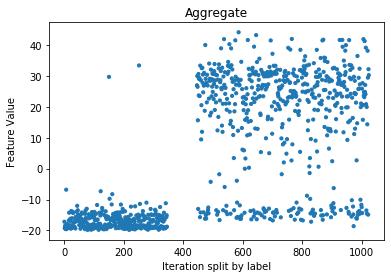

['MATN3', 'TMEM106C', 'TMEM232', 'SLC22A25', 'INPP5E', 'CTRL']
[0, 1, 0, 0, 1, 0]


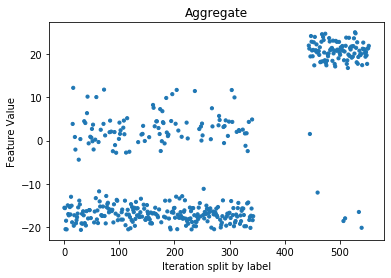

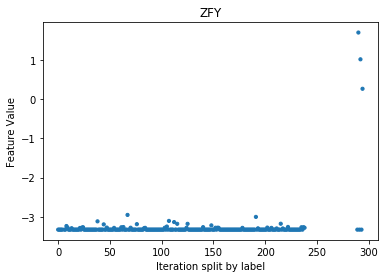

In [92]:
label1 = 4
label2 = 5
featurenamelist = ['ISX', 'FABP1', 'SLC39A5', 'GUCA2A', 'NR1I2', 'CDX2']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < -5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['MATN3', 'TMEM106C', 'TMEM232', 'SLC22A25', 'INPP5E', 'CTRL']
reverse = [0, 1, 0, 0, 1, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < -9:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZFY'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Cervix  and  Esophagus
['F8A3', 'EIF3CL', 'GJD3', 'POTEI', 'NPIPB12', 'RPS4Y1']
[0, 0, 0, 0, 0, 0]


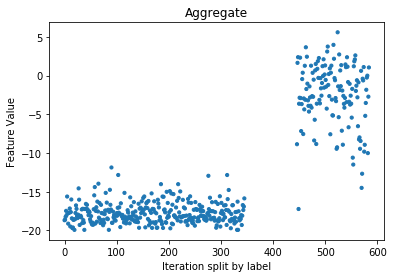

In [93]:
label1 = 4
label2 = 6
featurenamelist = ['F8A3', 'EIF3CL', 'GJD3', 'POTEI', 'NPIPB12', 'RPS4Y1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Cervix  and  Head


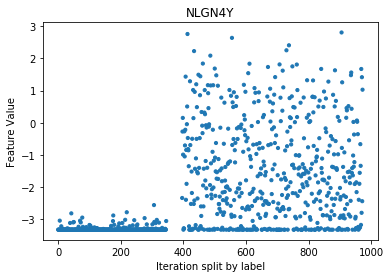

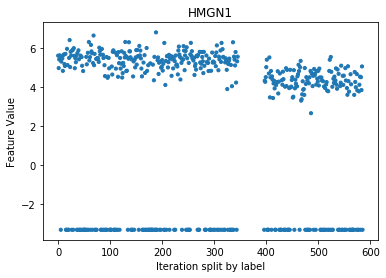

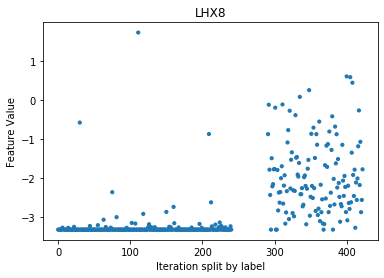

['E2F1', 'DSN1', 'UBE2T', 'RFC4', 'CDC25C', 'LIG1']
[0, 0, 0, 0, 0, 0]


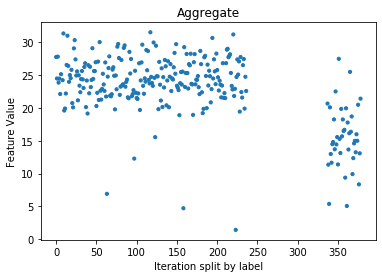

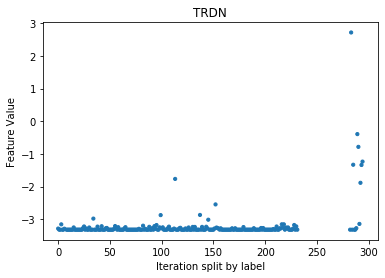

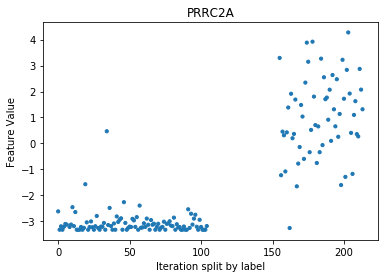

In [94]:
label1 = 4
label2 = 7
featurename = 'NLGN4Y'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'HMGN1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist2 = list()
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 0:
        
        tmpindexlist.append(i)
        
    if v < 0:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'LHX8'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist


#new value
featurenamelist = ['E2F1', 'DSN1', 'UBE2T', 'RFC4', 'CDC25C', 'LIG1']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v > 17.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TRDN'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'PRRC2A'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Cervix  and  Kidney
['PITX1', 'HPN', 'KLK10', 'SERPINB3', 'KIF2C', 'EMX2']
[0, 1, 0, 0, 0, 1]


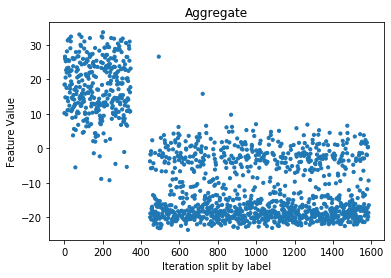

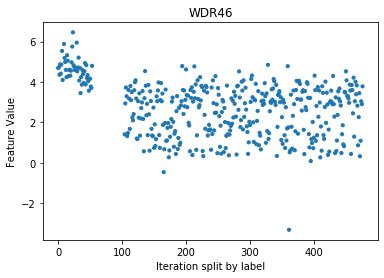

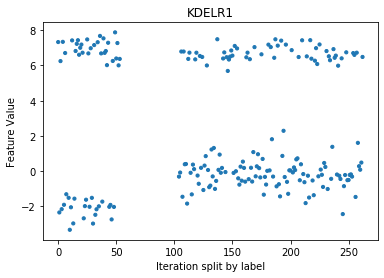

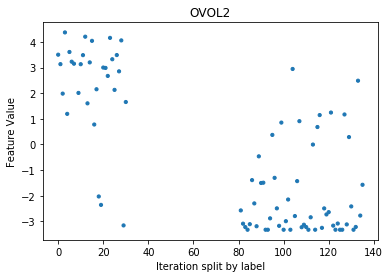

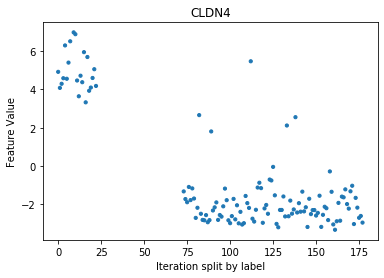

In [95]:
label1 = 4
label2 = 8
featurenamelist = ['PITX1', 'HPN', 'KLK10', 'SERPINB3', 'KIF2C', 'EMX2']
reverse = [0, 1, 0, 0, 0, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 10 and v > -10:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'WDR46'
#plottop5features(df, bindf, label1, label2, indexlist)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'KDELR1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 4:
        
        tmpindexlist.append(i)
        
    if v < 4:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'OVOL2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'CLDN4'
graphpairfeature(df, featurename, label1, label2, indexlist)


Labels being compared: Cervix  and  Leukemia
['CLDN4', 'HRH1', 'RAB25', 'RND3', 'KLK10', 'TMPRSS4']
[0, 0, 0, 0, 0, 0]


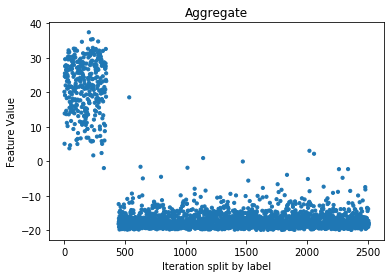

In [96]:
label1 = 4
label2 = 9
featurenamelist = ['CLDN4', 'HRH1', 'RAB25', 'RND3', 'KLK10', 'TMPRSS4']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Cervix  and  Liver


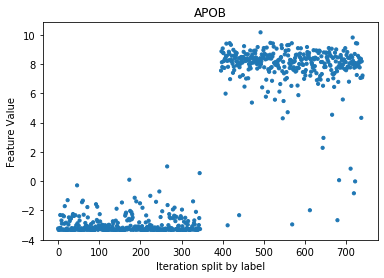

In [97]:
label1 = 4
label2 = 10
featurename = 'APOB'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Cervix  and  Lung
['TBX5', 'SCN7A', 'TCF21', 'SFTPA2', 'TMEM119', 'TBX4']
[0, 0, 0, 0, 0, 0]


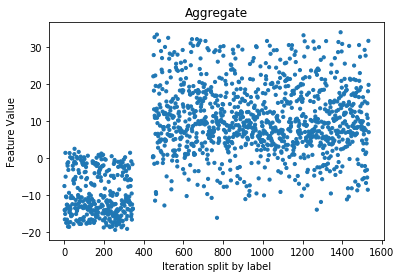

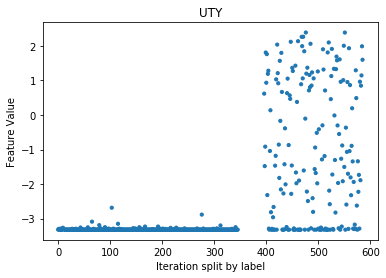

['DHRS1', 'SLC25A28', 'PPDPF', 'ACTB', 'CAPZB', 'MAT2B']
[0, 0, 0, 0, 0, 0]


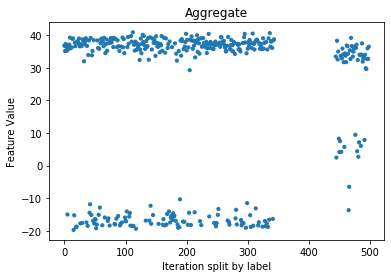

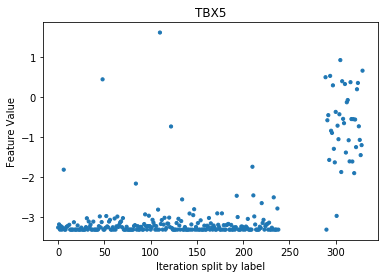

In [98]:
label1 = 4
label2 = 11
featurenamelist = ['TBX5', 'SCN7A', 'TCF21', 'SFTPA2', 'TMEM119', 'TBX4']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'UTY'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['DHRS1', 'SLC25A28', 'PPDPF', 'ACTB', 'CAPZB', 'MAT2B']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > 20:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TBX5'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Cervix  and  Lymph


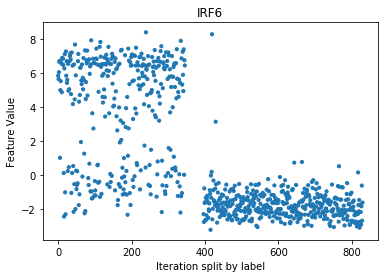

['BMP6', 'ADAM12', 'PLOD3', 'SP6', 'UNC119B', 'MEP1A']
[0, 0, 0, 0, 0, 0]


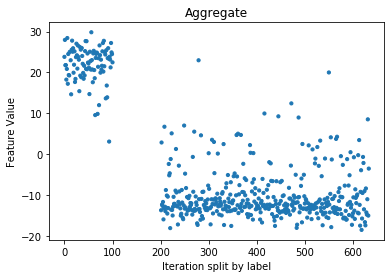

In [99]:
label1 = 4
label2 = 12
featurename = 'IRF6'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['BMP6', 'ADAM12', 'PLOD3', 'SP6', 'UNC119B', 'MEP1A']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Cervix  and  Ovarian


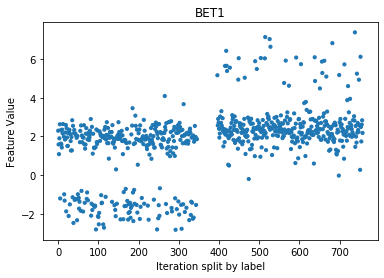

['ZBTB20', 'WT1', 'SERPINB3', 'DOK5', 'ZNF467', 'SERPINB4']
[0, 0, 1, 0, 0, 1]


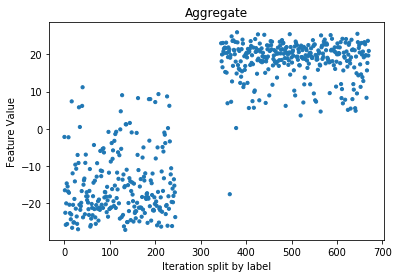

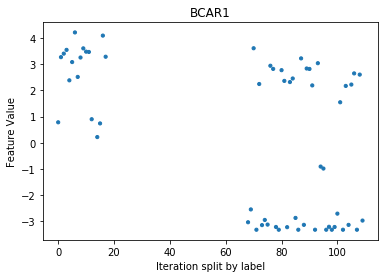

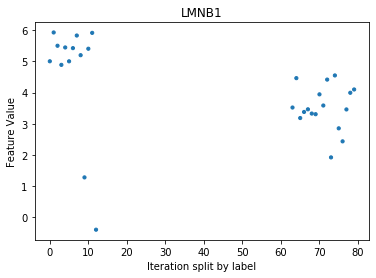

In [100]:
label1 = 4
label2 = 13
featurename = 'BET1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 4 and v > -0.2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['ZBTB20', 'WT1', 'SERPINB3', 'DOK5', 'ZNF467', 'SERPINB4']
reverse = [0, 0, 1, 0, 0, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 12 and v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'BCAR1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 1.8:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'LMNB1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Cervix  and  Pancreas


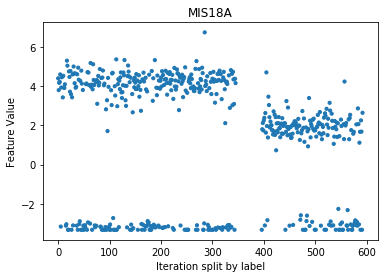

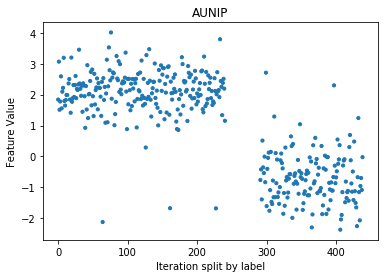

['NUBP1', 'ATAD3B', 'SLC33A1', 'PIP5K1C', 'ERBB4', 'TRABD']
[0, 0, 0, 0, 1, 1]


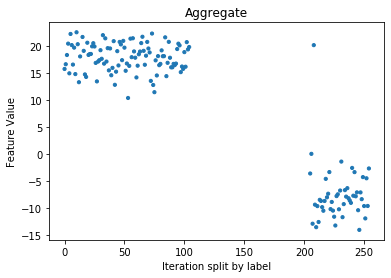

In [101]:
label1 = 4
label2 = 14
featurename = 'MIS18A'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist2 = list()
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 0:
        
        tmpindexlist.append(i)
        
    if v < 0:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'AUNIP'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurenamelist = ['NUBP1', 'ATAD3B', 'SLC33A1', 'PIP5K1C', 'ERBB4', 'TRABD']
reverse = [0, 0, 0, 0, 1, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Cervix  and  Peritoneum
['SPINT2', 'LSR', 'MAPK13', 'PRRG2', 'HMGA1', 'ABHD17C']
[0, 0, 0, 0, 0, 0]


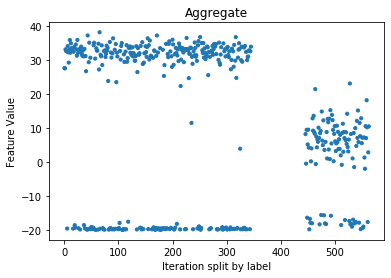

['CCDC126', 'CD22', 'DCAF12L2', 'FAM216A', 'MED1', 'CLDN4']
[0, 0, 0, 0, 0, 1]


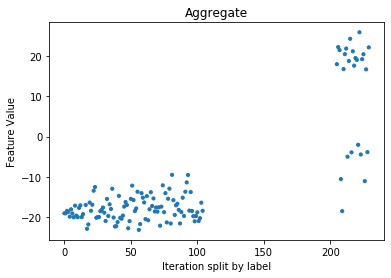

In [102]:
label1 = 4
label2 = 15
featurenamelist = ['SPINT2', 'LSR', 'MAPK13', 'PRRG2', 'HMGA1', 'ABHD17C']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < -10:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['CCDC126', 'CD22', 'DCAF12L2', 'FAM216A', 'MED1', 'CLDN4']
reverse = [0, 0, 0, 0, 0, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Cervix  and  Prostate
['DDX3Y', 'USP9Y', 'CUX2', 'KDM5D', 'KIF2C', 'EIF1AY']
[0, 0, 0, 0, 1, 0]


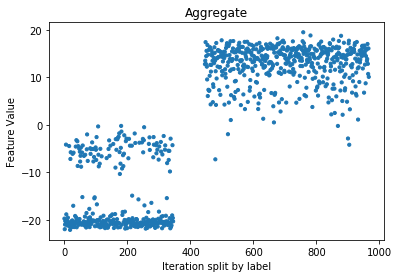

In [103]:
label1 = 4
label2 = 16
featurenamelist = ['DDX3Y', 'USP9Y', 'CUX2', 'KDM5D', 'KIF2C', 'EIF1AY']
reverse = [0, 0, 0, 0, 1, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Cervix  and  Sarcoma


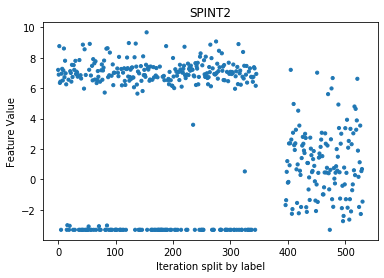

In [104]:
label1 = 4
label2 = 17
featurename = 'SPINT2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Cervix  and  Skin


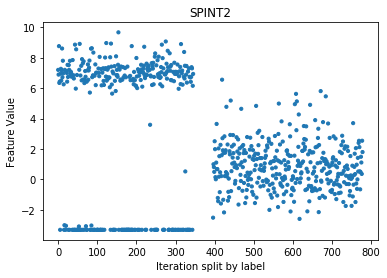

In [105]:
label1 = 4
label2 = 18
featurename = 'SPINT2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Cervix  and  Stomach


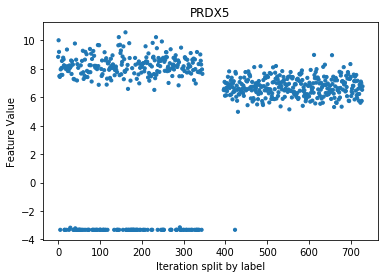

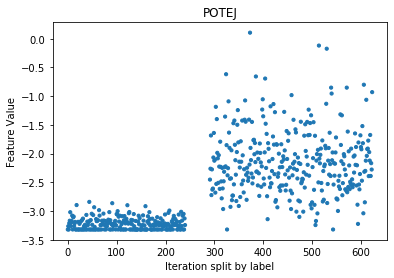

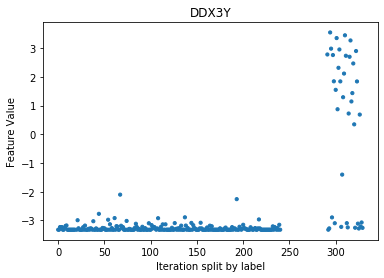

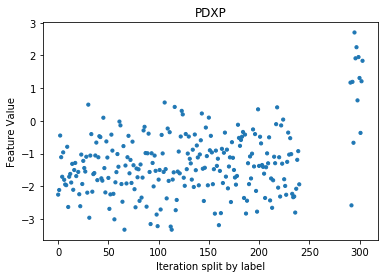

In [106]:
label1 = 4
label2 = 19
featurename = 'PRDX5'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'POTEJ'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2.75:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'DDX3Y'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PDXP'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Cervix  and  Testis


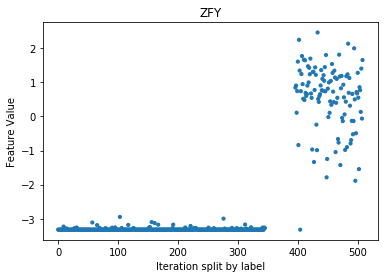

In [107]:
label1 = 4
label2 = 20
featurename = 'ZFY'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Cervix  and  Thyroid


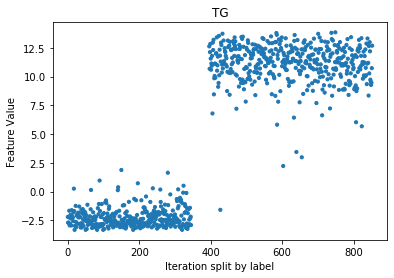

In [108]:
label1 = 4
label2 = 21
featurename = 'TG'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Cervix  and  Uterus


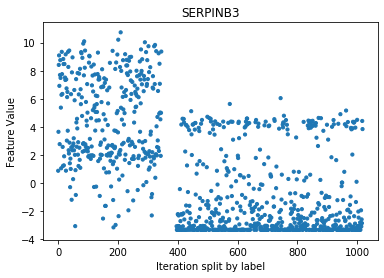

['ZSCAN18', 'ZNF610', 'ZNF43', 'VPS37D', 'ZNF135', 'CHST10']
[0, 0, 0, 0, 0, 0]


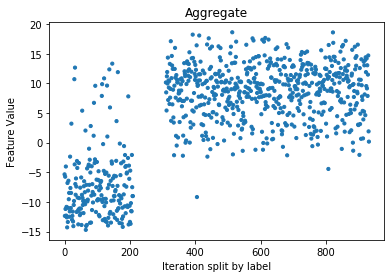

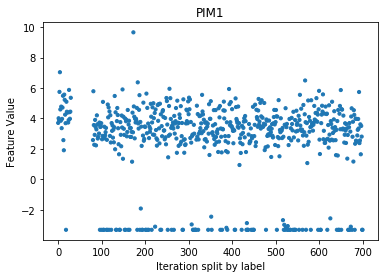

['ZNF541', 'SYCP2', 'SMC1B', 'ITGA2B', 'KLHL35', 'ZFR2']
[0, 0, 0, 0, 0, 0]


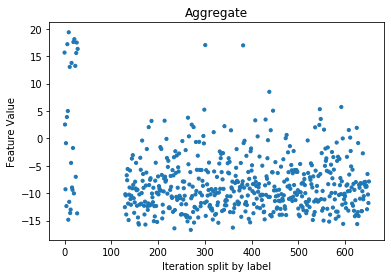

In [109]:
label1 = 4
label2 = 22
featurename = 'SERPINB3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 6:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['ZSCAN18', 'ZNF610', 'ZNF43', 'VPS37D', 'ZNF135', 'CHST10']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > -3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PIM1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['ZNF541', 'SYCP2', 'SMC1B', 'ITGA2B', 'KLHL35', 'ZFR2']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Colon  and  Esophagus
['POTEI', 'EEF1G', 'DUOX1', 'F8A3', 'NBPF26', 'EIF3CL']
[0, 0, 0, 0, 0, 0]


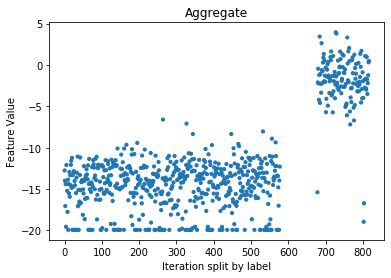

In [110]:
label1 = 5
label2 = 6
featurenamelist = ['POTEI', 'EEF1G', 'DUOX1', 'F8A3', 'NBPF26', 'EIF3CL']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Colon  and  Head


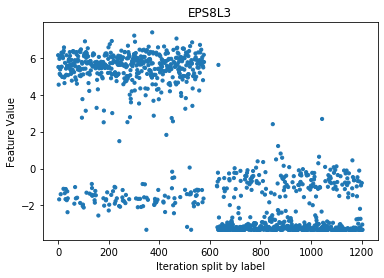

['EXOC6', 'AIRE', 'RFNG', 'LUZP2', 'RPS6KA4', 'GANAB']
[0, 0, 1, 0, 1, 1]


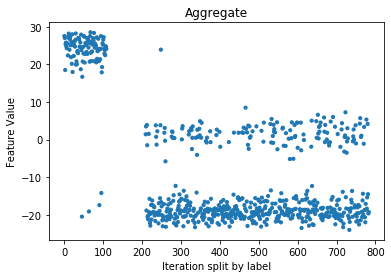

In [111]:
label1 = 5
label2 = 7
featurename = 'EPS8L3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['EXOC6', 'AIRE', 'RFNG', 'LUZP2', 'RPS6KA4', 'GANAB']
reverse = [0, 0, 1, 0, 1, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Colon  and  Kidney


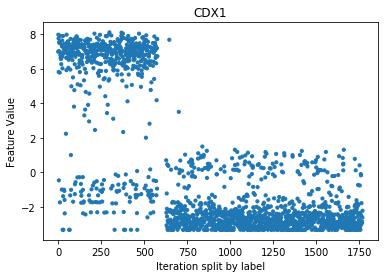

['RRP7A', 'RSPH3', 'COX10', 'HEATR5A', 'TMEM164', 'EOMES']
[0, 0, 0, 1, 0, 0]


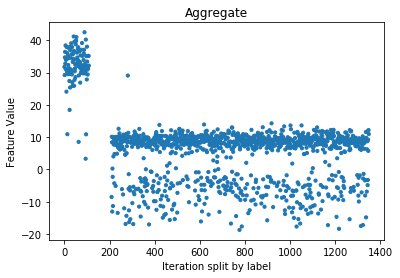

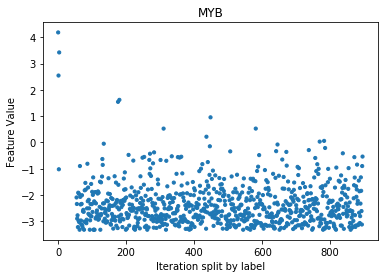

In [112]:
label1 = 5
label2 = 8
featurename = 'CDX1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['RRP7A', 'RSPH3', 'COX10', 'HEATR5A', 'TMEM164', 'EOMES']
reverse = [0, 0, 0, 1, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > 0 and v < 17:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'MYB'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Colon  and  Leukemia


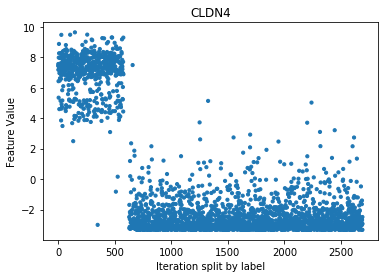

In [113]:
label1 = 5
label2 = 9
featurename = 'CLDN4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Colon  and  Liver


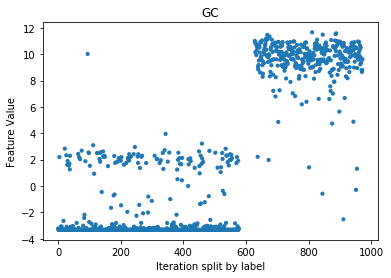

In [114]:
label1 = 5
label2 = 10
featurename = 'GC'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Colon  and  Lung


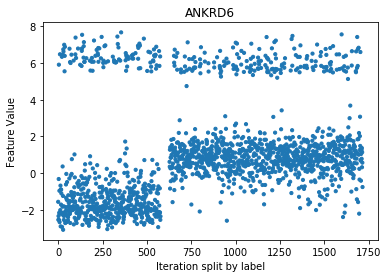

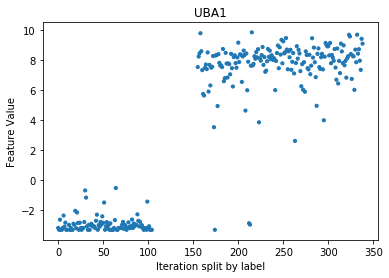

['CDX1', 'CDX2', 'PHGR1', 'MOGAT3', 'CLRN3', 'FABP1']
[0, 0, 0, 0, 0, 0]


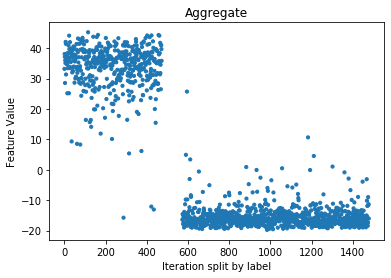

In [115]:
label1 = 5
label2 = 11
featurename = 'ANKRD6'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist2 = list()
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 4.25:
        
        tmpindexlist.append(i)
        
    if v < 4.25:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'UBA1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurenamelist = ['CDX1', 'CDX2', 'PHGR1', 'MOGAT3', 'CLRN3', 'FABP1']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Colon  and  Lymph


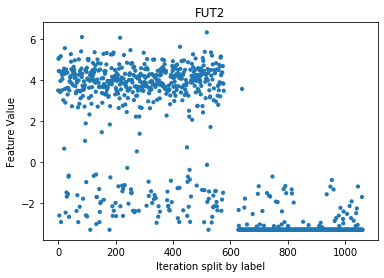

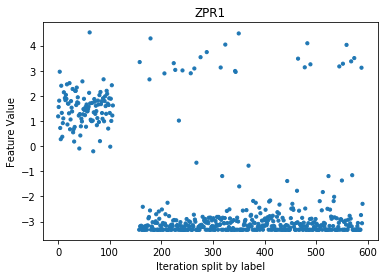

In [116]:
label1 = 5
label2 = 12
featurename = 'FUT2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZPR1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Colon  and  Ovarian
['EMX2', 'SLC34A2', 'SCGB1D2', 'EPS8L3', 'HNF4A', 'KLHL14']
[0, 0, 0, 1, 1, 0]


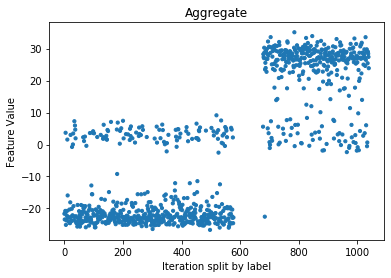

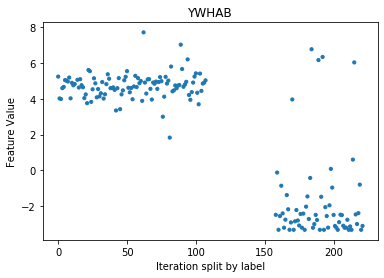

In [117]:
label1 = 5
label2 = 13
featurenamelist = ['EMX2', 'SLC34A2', 'SCGB1D2', 'EPS8L3', 'HNF4A', 'KLHL14']
reverse = [0, 0, 0, 1, 1, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 10 and v > -5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'YWHAB'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Colon  and  Pancreas


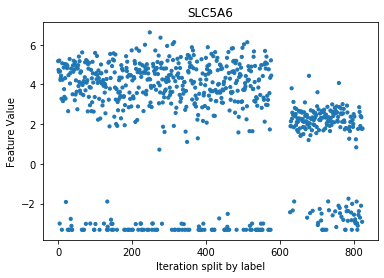

['MYB', 'TRABD2A', 'CDX1', 'PDSS1', 'CDX2', 'NOX1']
[0, 0, 0, 0, 0, 0]


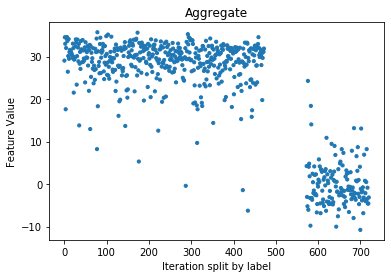

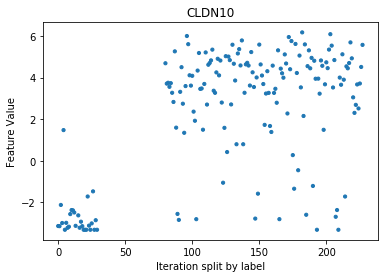

['WDR34', 'RTEL1-TNFRSF6B', 'PJA2', 'GNL3L', 'LMAN2L', 'OLFM3']
[0, 0, 0, 0, 1, 0]


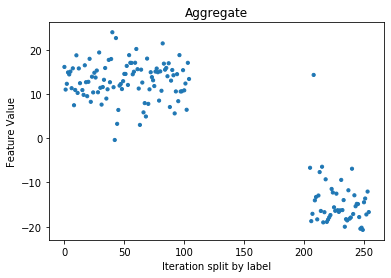

In [118]:
label1 = 5
label2 = 14
featurename = 'SLC5A6'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 0:
        
        tmpindexlist.append(i)
        
    if v < 0:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['MYB', 'TRABD2A', 'CDX1', 'PDSS1', 'CDX2', 'NOX1']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 20:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CLDN10'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurenamelist = ['WDR34', 'RTEL1-TNFRSF6B', 'PJA2', 'GNL3L', 'LMAN2L', 'OLFM3']
reverse = [0, 0, 0, 0, 1, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Colon  and  Peritoneum


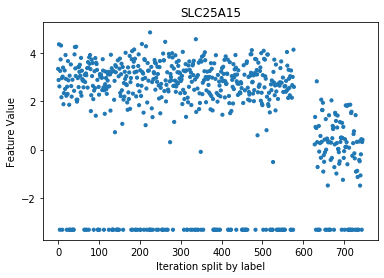

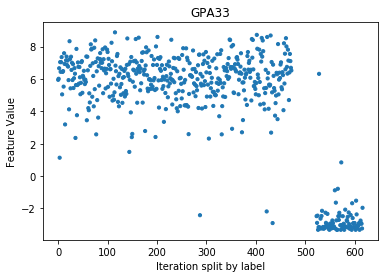

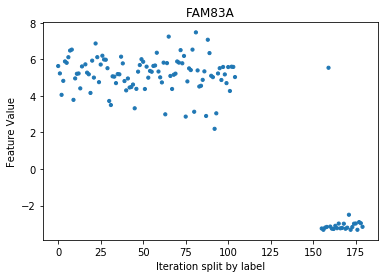

In [119]:
label1 = 5
label2 = 15
featurename = 'SLC25A15'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist2 = list()
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -2.25:
        
        tmpindexlist.append(i)
    
    if v < -2.25:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'GPA33'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'FAM83A'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Colon  and  Prostate


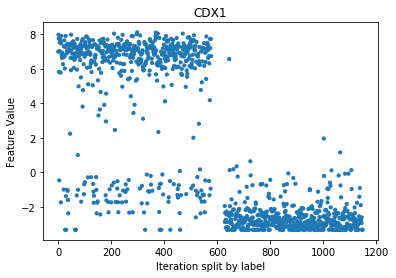

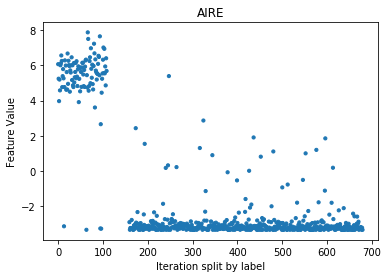

['SUOX', 'DLG2', 'TUBGCP2', 'FXYD5', 'IL15RA', 'SUGT1']
[0, 0, 0, 1, 1, 1]


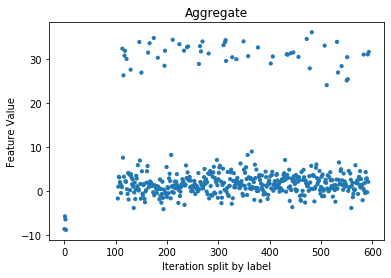

In [120]:
label1 = 5
label2 = 16
featurename = 'CDX1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'AIRE'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['SUOX', 'DLG2', 'TUBGCP2', 'FXYD5', 'IL15RA', 'SUGT1']
reverse = [0, 0, 0, 1, 1, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Colon  and  Sarcoma


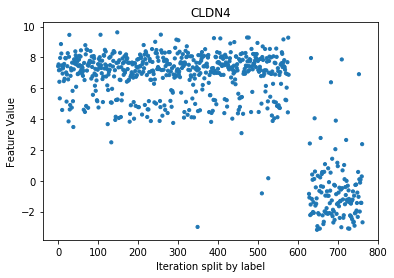

In [121]:
label1 = 5
label2 = 17
featurename = 'CLDN4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Colon  and  Skin


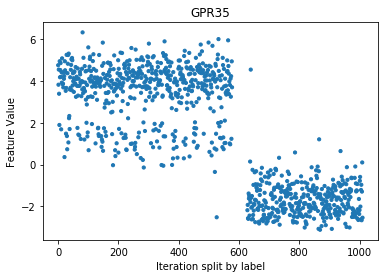

In [122]:
label1 = 5
label2 = 18
featurename = 'GPR35'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Colon  and  Stomach


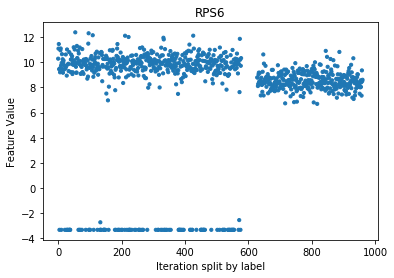

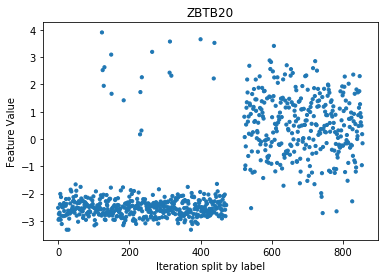

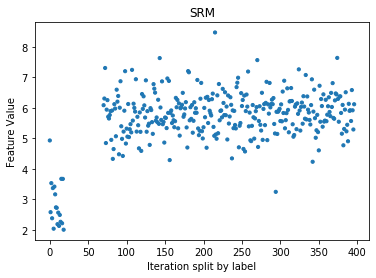

In [123]:
label1 = 5
label2 = 19
featurename = 'RPS6'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZBTB20'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -1.7:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'SRM'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Colon  and  Testis
['RND2', 'TUBB4A', 'SLC7A3', 'ZNF667', 'DPPA4', 'WNK3']
[0, 0, 0, 0, 0, 0]


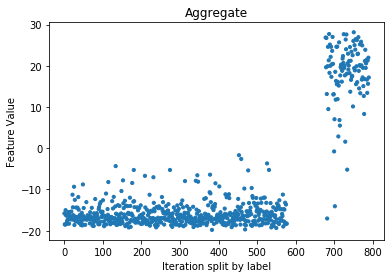

In [124]:
label1 = 5
label2 = 20
featurenamelist = ['RND2', 'TUBB4A', 'SLC7A3', 'ZNF667', 'DPPA4', 'WNK3']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Colon  and  Thyroid


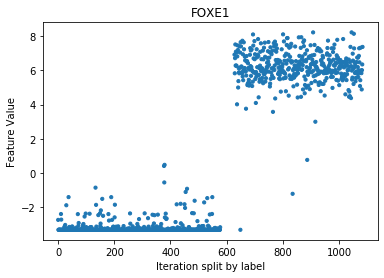

In [125]:
label1 = 5
label2 = 21
featurename = 'FOXE1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Colon  and  Uterus
['EMX2', 'CDX1', 'DLX5', 'PHGR1', 'SLC34A2', 'KCTD1']
[0, 1, 0, 1, 0, 0]


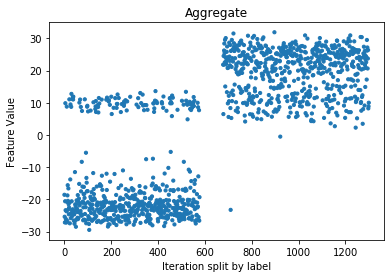

['OTUD3', 'EIF4E3', 'LMTK2', 'FSD1L', 'NDUFA7', 'SIK3']
[0, 0, 0, 0, 0, 0]


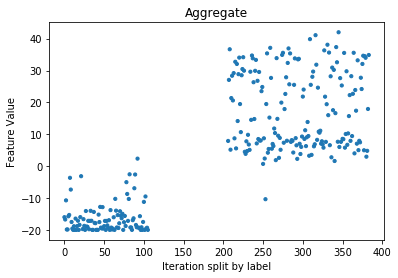

In [126]:
label1 = 5
label2 = 22
featurenamelist = ['EMX2', 'CDX1', 'DLX5', 'PHGR1', 'SLC34A2', 'KCTD1']
reverse = [0, 1, 0, 1, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 15 and v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['OTUD3', 'EIF4E3', 'LMTK2', 'FSD1L', 'NDUFA7', 'SIK3']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Esophagus  and  Head
['GJD3', 'EIF3CL', 'SPDYE5', 'TRAPPC5', 'POTEI', 'TSSK3']
[0, 0, 0, 0, 0, 0]


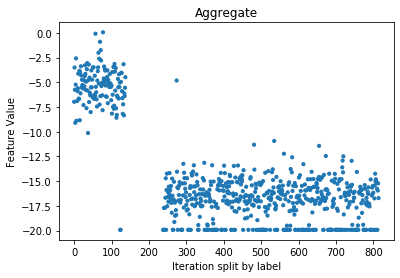

In [127]:
label1 = 6
label2 = 7
featurenamelist = ['GJD3', 'EIF3CL', 'SPDYE5', 'TRAPPC5', 'POTEI', 'TSSK3']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Esophagus  and  Kidney


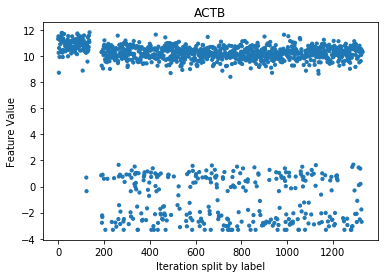

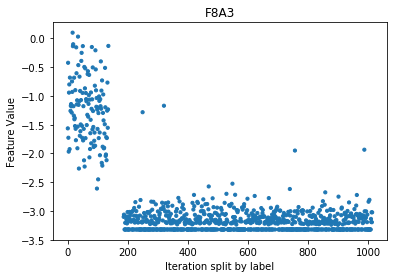

In [128]:
label1 = 6
label2 = 8
featurename = 'ACTB'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'F8A3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Esophagus  and  Leukemia


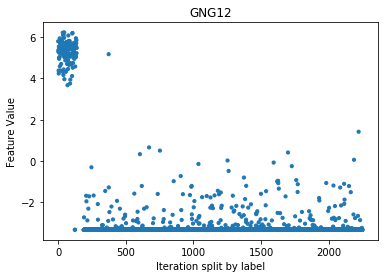

In [129]:
label1 = 6
label2 = 9
featurename = 'GNG12'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Esophagus  and  Liver
['GAN', 'CMIP', 'ZNF460', 'STYK1', 'SERPINB5', 'POMK']
[0, 0, 0, 0, 0, 0]


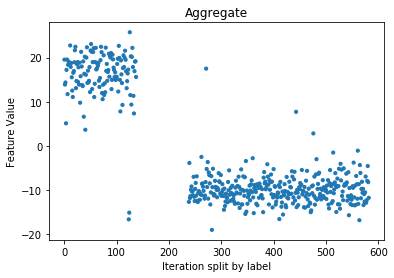

In [130]:
label1 = 6
label2 = 10
featurenamelist = ['GAN', 'CMIP', 'ZNF460', 'STYK1', 'SERPINB5', 'POMK']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Esophagus  and  Lung
['GJD3', 'TRAPPC5', 'EIF3CL', 'CTU1', 'POTEI', 'ZFPM1']
[0, 0, 0, 0, 0, 0]


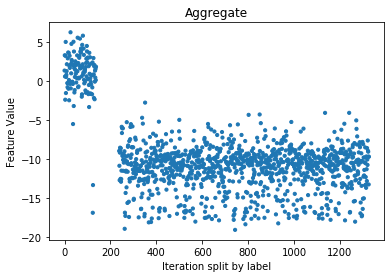

In [131]:
label1 = 6
label2 = 11
featurenamelist = ['GJD3', 'TRAPPC5', 'EIF3CL', 'CTU1', 'POTEI', 'ZFPM1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Esophagus  and  Lymph


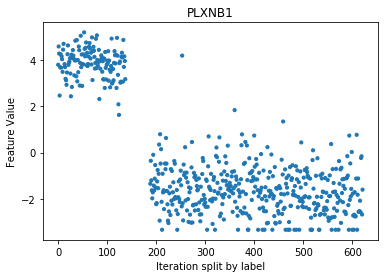

In [132]:
label1 = 6
label2 = 12
featurename = 'PLXNB1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Esophagus  and  Ovarian
['PAX8', 'SOX17', 'FGF18', 'NPR1', 'SPON1', 'BCAM']
[0, 0, 0, 0, 0, 0]


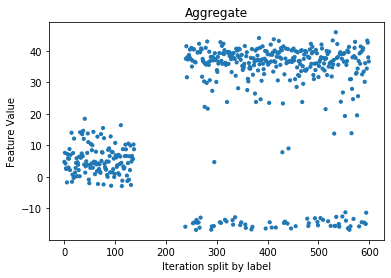

In [133]:
label1 = 6
label2 = 13
featurenamelist = ['PAX8', 'SOX17', 'FGF18', 'NPR1', 'SPON1', 'BCAM']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Esophagus  and  Pancreas
['GJD3', 'EIF3CL', 'ZNF460', 'STMN2', 'TICRR', 'TRAPPC5']
[0, 0, 0, 1, 0, 0]


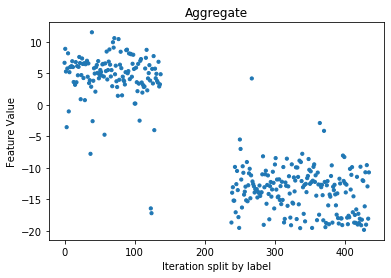

In [134]:
label1 = 6
label2 = 14
featurenamelist = ['GJD3', 'EIF3CL', 'ZNF460', 'STMN2', 'TICRR', 'TRAPPC5']
reverse = [0, 0, 0, 1, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Esophagus  and  Peritoneum


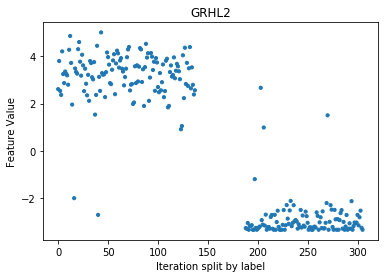

In [135]:
label1 = 6
label2 = 15
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Esophagus  and  Prostate
['DYNLL2', 'ADI1', 'MAGED2', 'CBY1', 'CREB3', 'ERGIC1']
[0, 0, 0, 0, 0, 0]


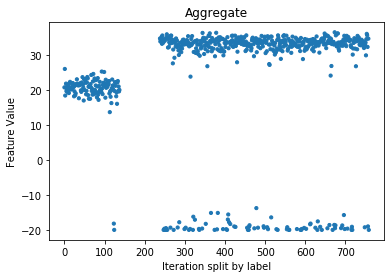

In [136]:
label1 = 6
label2 = 16
featurenamelist = ['DYNLL2', 'ADI1', 'MAGED2', 'CBY1', 'CREB3', 'ERGIC1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Esophagus  and  Sarcoma


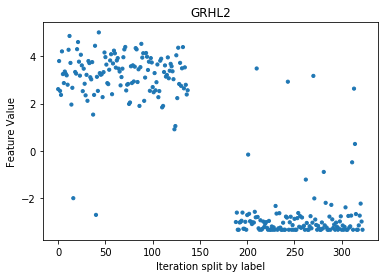

In [137]:
label1 = 6
label2 = 17
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Esophagus  and  Skin
['F8A3', 'GJD3', 'MARVELD3', 'EPCAM', 'GRHL2', 'POTEJ']
[0, 0, 0, 0, 0, 0]


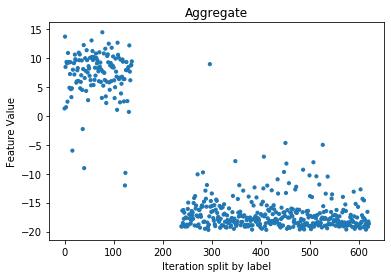

In [138]:
label1 = 6
label2 = 18
featurenamelist = ['F8A3', 'GJD3', 'MARVELD3', 'EPCAM', 'GRHL2', 'POTEJ']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Esophagus  and  Stomach


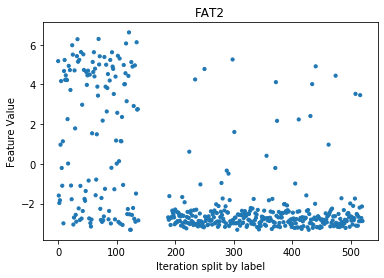

['DUOX1', 'DUOXA1', 'DUOX2', 'TFR2', 'IL1RL2', 'GPRC5C']
[0, 0, 0, 0, 0, 0]


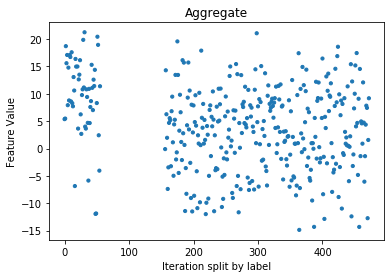

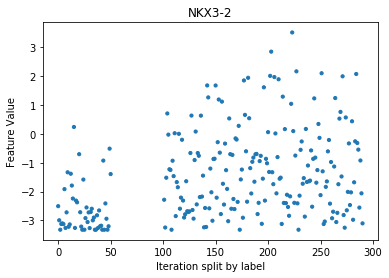

['TBX5', 'NKX6-1', 'TUBD1', 'SPTB', 'TTLL9', 'NOXRED1']
[0, 0, 0, 0, 0, 0]


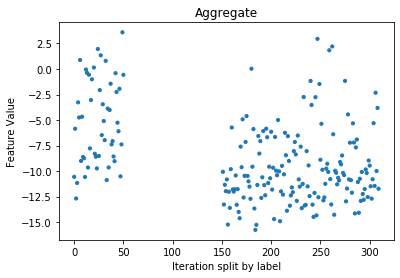

In [139]:
label1 = 6
label2 = 19
featurename = 'FAT2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['DUOX1', 'DUOXA1', 'DUOX2', 'TFR2', 'IL1RL2', 'GPRC5C']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'NKX3-2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0.4:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['TBX5', 'NKX6-1', 'TUBD1', 'SPTB', 'TTLL9', 'NOXRED1']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Esophagus  and  Testis


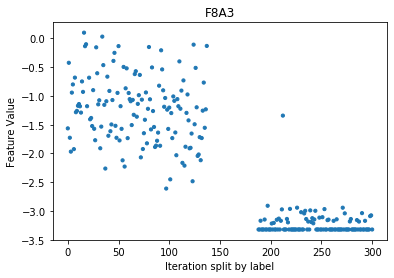

In [140]:
label1 = 6
label2 = 20
featurename = 'F8A3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Esophagus  and  Thyroid


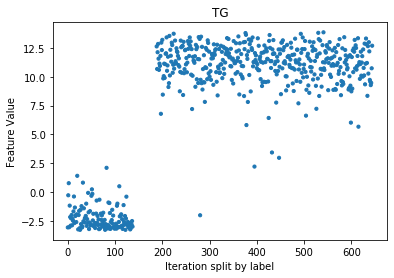

In [141]:
label1 = 6
label2 = 21
featurename = 'TG'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Esophagus  and  Uterus
['EIF3CL', 'POTEI', 'POTEJ', 'SERPINB5', 'GJD3', 'ZFY']
[0, 0, 0, 0, 0, 0]


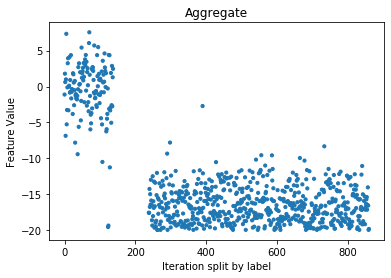

In [142]:
label1 = 6
label2 = 22
featurenamelist = ['EIF3CL', 'POTEI', 'POTEJ', 'SERPINB5', 'GJD3', 'ZFY']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Head  and  Kidney
['PITX1', 'EMX2', 'DSG3', 'SERPINB13', 'KLK10', 'CLCA2']
[0, 1, 0, 0, 0, 0]


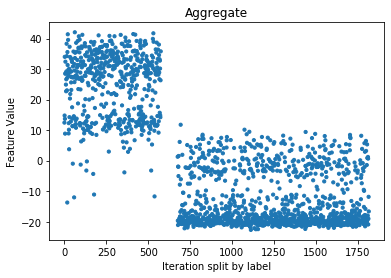

['PHOX2B', 'FAM181A', 'GDAP1L1', 'SEL1L2', 'OR4F6', 'GH2']
[0, 0, 0, 0, 0, 0]


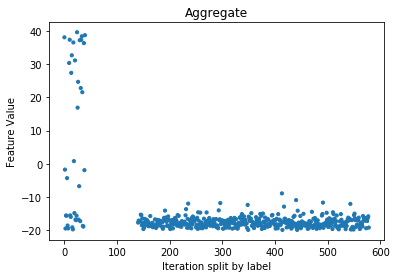

['PITX1', 'KLF16', 'PHF8', 'PELP1', 'PFN2', 'MRPS11']
[0, 0, 0, 0, 0, 0]


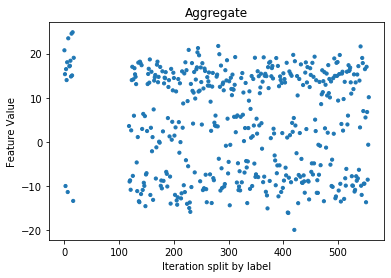

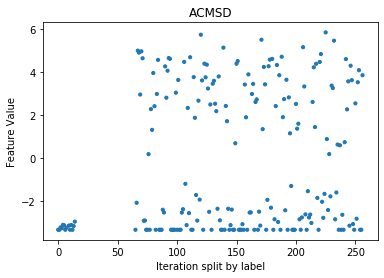

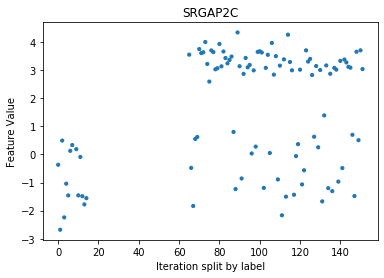

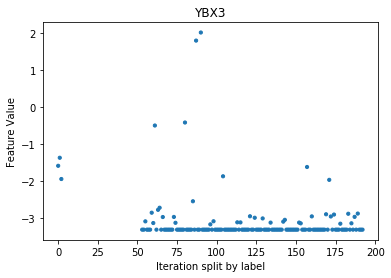

In [143]:
label1 = 7
label2 = 8
featurenamelist = ['PITX1', 'EMX2', 'DSG3', 'SERPINB13', 'KLK10', 'CLCA2']
reverse = [0, 1, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 10 and v > -15:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['PHOX2B', 'FAM181A', 'GDAP1L1', 'SEL1L2', 'OR4F6', 'GH2']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < -8:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['PITX1', 'KLF16', 'PHF8', 'PELP1', 'PFN2', 'MRPS11']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist2 = list()
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v > 10:
        
        tmpindexlist.append(i)
        
    if v < -5:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ACMSD'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'SRGAP2C'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'YBX3'
graphpairfeature(df, featurename, label1, label2, indexlist)


Labels being compared: Head  and  Leukemia
['RND3', 'DSC3', 'RIPK4', 'EFNB2', 'GNG12', 'KRT5']
[0, 0, 0, 0, 0, 0]


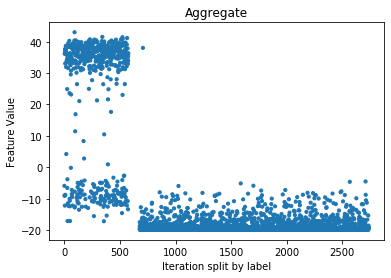

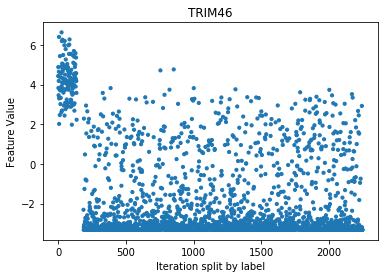

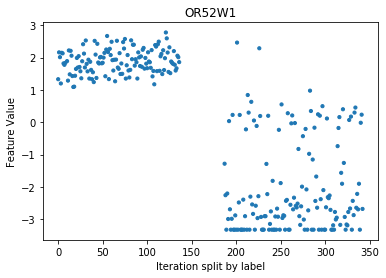

In [144]:
label1 = 7
label2 = 9
featurenamelist = ['RND3', 'DSC3', 'RIPK4', 'EFNB2', 'GNG12', 'KRT5']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < -5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TRIM46'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'OR52W1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Head  and  Liver


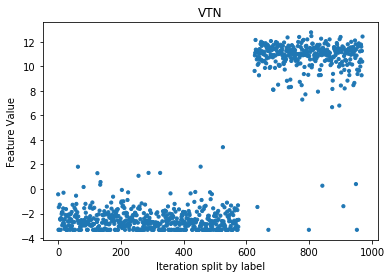

In [145]:
label1 = 7
label2 = 10
featurename = 'VTN'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Head  and  Lung
['SFTPA2', 'SFTPA1', 'SFTA3', 'SLC34A2', 'SFTPB', 'SFTPC']
[0, 0, 0, 0, 0, 0]


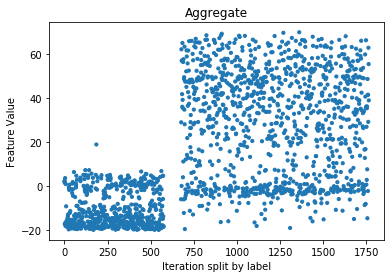

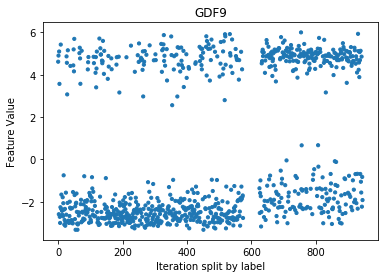

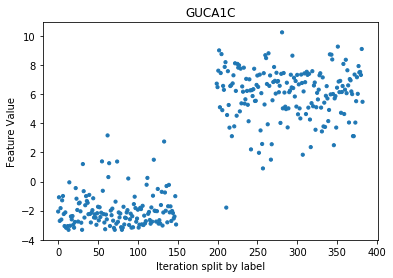

['TBX5', 'TCF21', 'TBX4', 'TMEM130', 'SFTPB', 'DNAH14']
[0, 0, 0, 0, 0, 0]


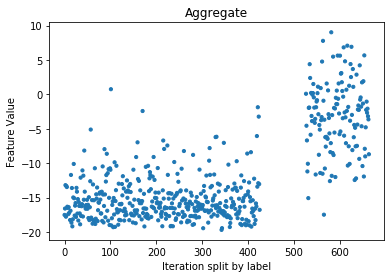

In [146]:
label1 = 7
label2 = 11
featurenamelist = ['SFTPA2', 'SFTPA1', 'SFTA3', 'SLC34A2', 'SFTPB', 'SFTPC']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 10:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'GDF9'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist2 = list()
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 1.5:
        
        tmpindexlist.append(i)
        
    if v < 1.5:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'GUCA1C'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurenamelist = ['TBX5', 'TCF21', 'TBX4', 'TMEM130', 'SFTPB', 'DNAH14']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Head  and  Lymph


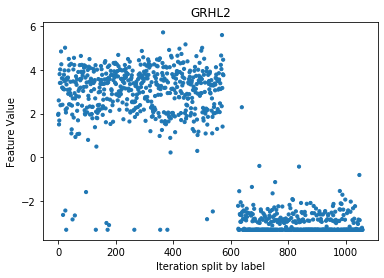

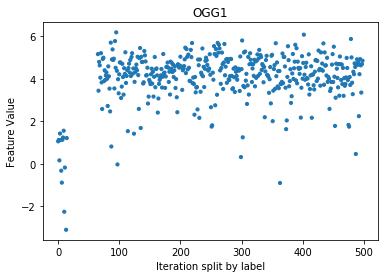

In [147]:
label1 = 7
label2 = 12
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'OGG1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Head  and  Ovarian
['EMX2', 'DSG3', 'KLHL14', 'TP63', 'CLCA2', 'SCGB1D2']
[0, 1, 0, 1, 1, 0]


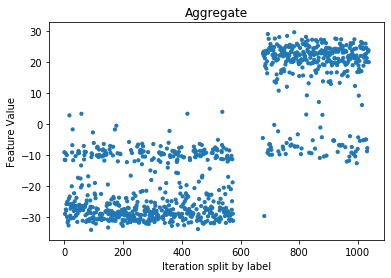

['SLC22A23', 'RPL7', 'NONO', 'MRPL47', 'AMFR', 'NDUFB2']
[0, 1, 1, 1, 1, 1]


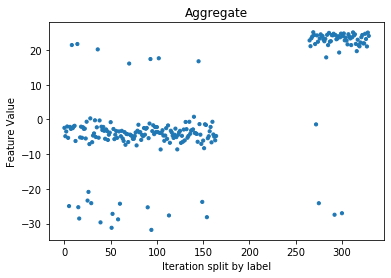

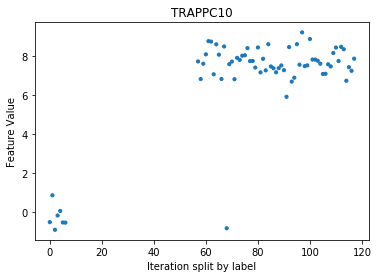

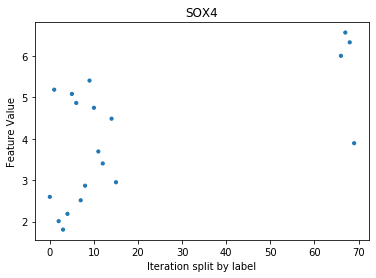

In [148]:
label1 = 7
label2 = 13
featurenamelist = ['EMX2', 'DSG3', 'KLHL14', 'TP63', 'CLCA2', 'SCGB1D2']
reverse = [0, 1, 0, 1, 1, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 5 and v > -15:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist


#new value
featurenamelist = ['SLC22A23', 'RPL7', 'NONO', 'MRPL47', 'AMFR', 'NDUFB2']
reverse = [0, 1, 1, 1, 1, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > 5:
        
        tmpindexlist.append(i)
        
    if v < -15:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TRAPPC10'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'SOX4'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Head  and  Pancreas


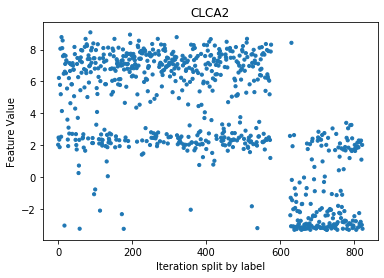

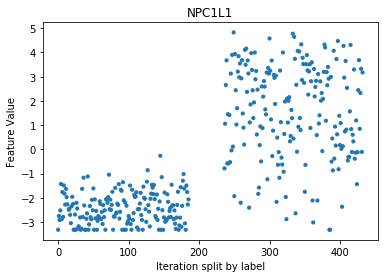

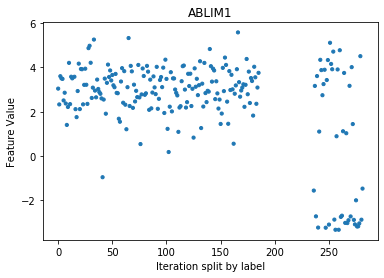

['MSLN', 'S100P', 'MUC1', 'CTSE', 'GPRC5A', 'KCNN4']
[0, 0, 0, 0, 0, 0]


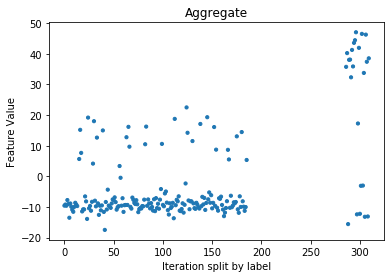

In [149]:
label1 = 7
label2 = 14
featurename = 'CLCA2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 3.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'NPC1L1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ABLIM1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['MSLN', 'S100P', 'MUC1', 'CTSE', 'GPRC5A', 'KCNN4']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Head  and  Peritoneum


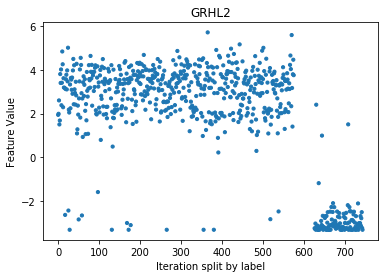

In [150]:
label1 = 7
label2 = 15
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Head  and  Prostate


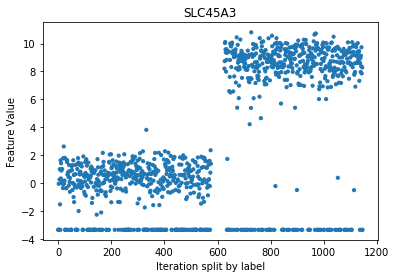

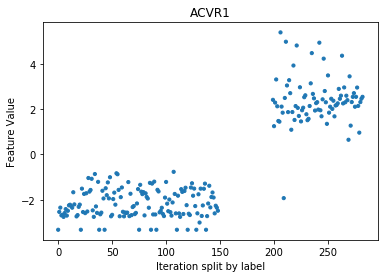

In [151]:
label1 = 7
label2 = 16
featurename = 'SLC45A3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ACVR1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Head  and  Sarcoma


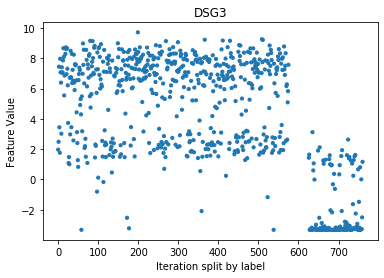

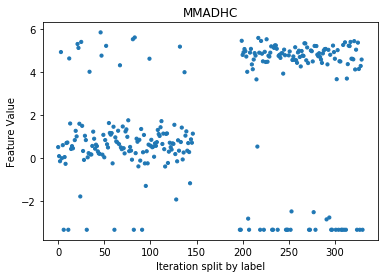

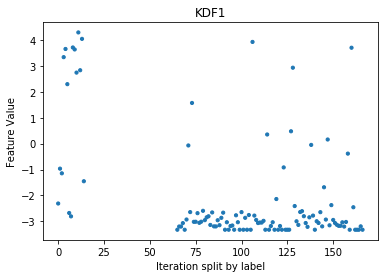

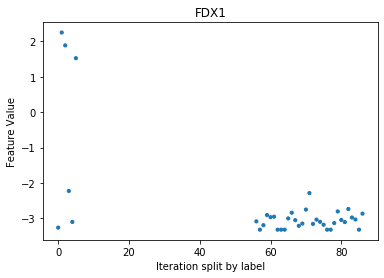

In [152]:
label1 = 7
label2 = 17
featurename = 'DSG3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'MMADHC'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 2.5:
        
        tmpindexlist.append(i)
        
    if v < -2:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'KDF1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of the split
indexlist = tmpindexlist2

#new value
featurename = 'FDX1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Head  and  Skin
['FMN1', 'MITF', 'LZTS1', 'SLC16A4', 'DAAM2', 'BEST1']
[0, 0, 0, 0, 0, 0]


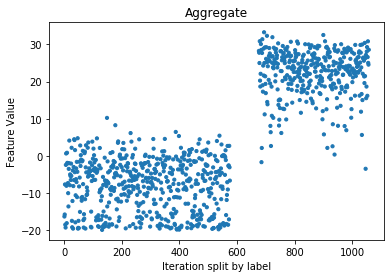

In [153]:
label1 = 7
label2 = 18
featurenamelist = ['FMN1', 'MITF', 'LZTS1', 'SLC16A4', 'DAAM2', 'BEST1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Head  and  Stomach
['ZFPM1', 'TMEM238', 'DDAH1', 'SMAD6', 'PBLD', 'ADAP1']
[0, 0, 0, 0, 0, 0]


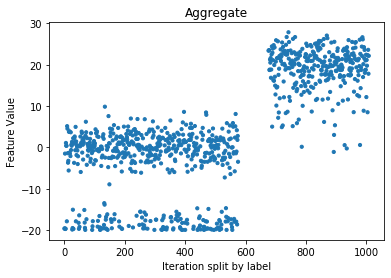

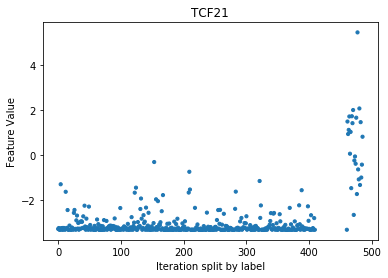

In [154]:
label1 = 7
label2 = 19
featurenamelist = ['ZFPM1', 'TMEM238', 'DDAH1', 'SMAD6', 'PBLD', 'ADAP1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 11 and v > -5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TCF21'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Head  and  Testis


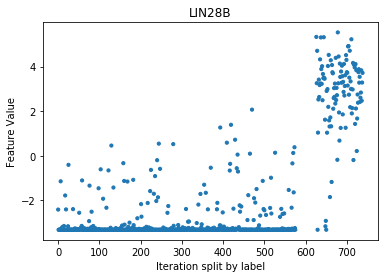

In [155]:
label1 = 7
label2 = 20
featurename = 'LIN28B'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Head  and  Thyroid


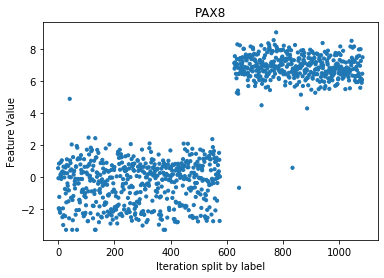

In [156]:
label1 = 7
label2 = 21
featurename = 'PAX8'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Head  and  Uterus


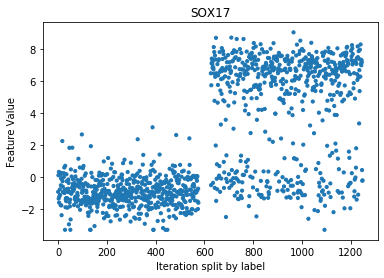

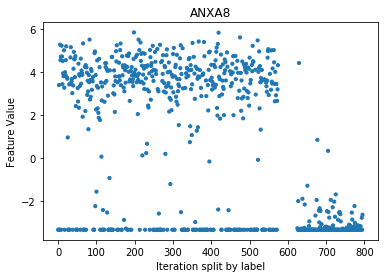

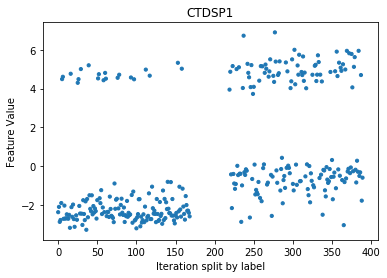

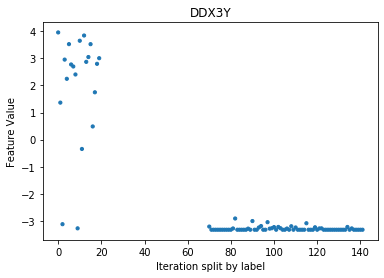

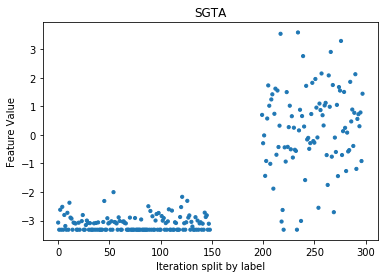

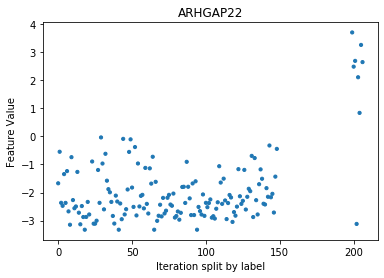

In [157]:
label1 = 7
label2 = 22
featurename = 'SOX17'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ANXA8'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CTDSP1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 2:
        
        tmpindexlist.append(i)
        
    if v < 2:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'DDX3Y'
graphpairfeature(df, featurename, label1, label2, indexlist)

indexlist = tmpindexlist2

#new value
featurename = 'SGTA'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -1.8:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ARHGAP22'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Leukemia
['CYB5D2', 'BRD7', 'SLC33A1', 'GATC', 'MTR', 'IFT46']
[0, 0, 0, 0, 0, 0]


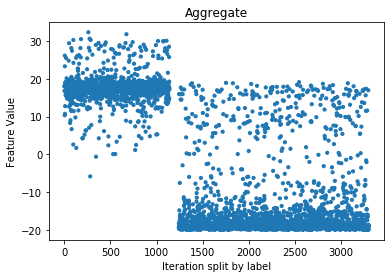

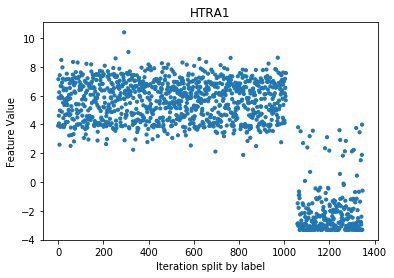

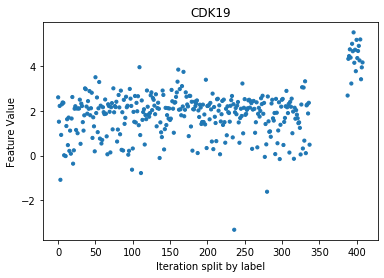

In [158]:
label1 = 8
label2 = 9
featurenamelist = ['CYB5D2', 'BRD7', 'SLC33A1', 'GATC', 'MTR', 'IFT46']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 20 and v > -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'HTRA1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 5 and v > 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CDK19'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Liver


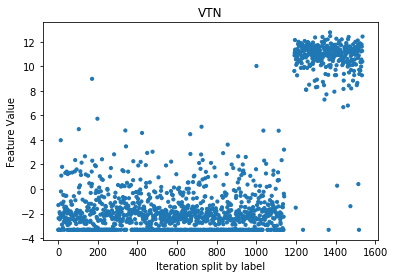

In [159]:
label1 = 8
label2 = 10
featurename = 'VTN'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Lung
['CEACAM6', 'ST6GALNAC1', 'SDR16C5', 'CEACAM5', 'EMX2', 'FAM83E']
[0, 0, 0, 0, 1, 0]


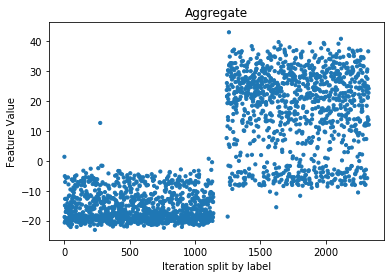

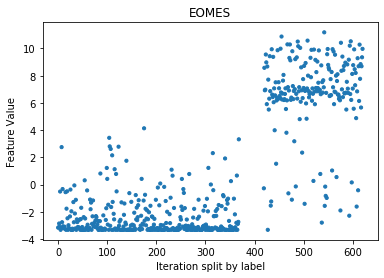

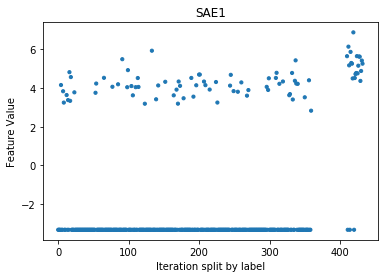

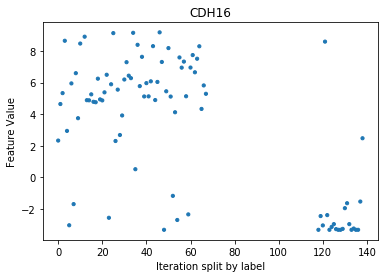

In [160]:
label1 = 8
label2 = 11
featurenamelist = ['CEACAM6', 'ST6GALNAC1', 'SDR16C5', 'CEACAM5', 'EMX2', 'FAM83E']
reverse = [0, 0, 0, 0, 1, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 0 and v > -14:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'EOMES'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'SAE1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CDH16'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Lymph


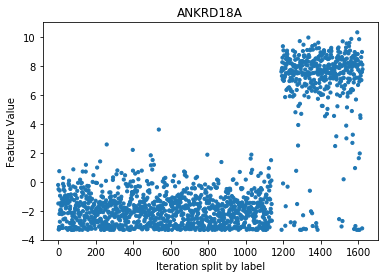

['GRK6', 'RELB', 'TRIM11', 'TACC3', 'CARD11', 'DHX34']
[0, 0, 0, 0, 0, 0]


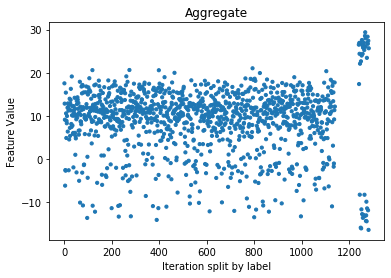

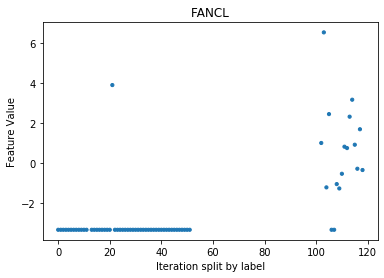

In [161]:
label1 = 8
label2 = 12
featurename = 'ANKRD18A'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 4:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['GRK6', 'RELB', 'TRIM11', 'TACC3', 'CARD11', 'DHX34']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < -5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'FANCL'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Ovarian
['MUC16', 'LPAR3', 'KLK11', 'FAM181A', 'KLK5', 'UPK3B']
[0, 0, 0, 1, 0, 0]


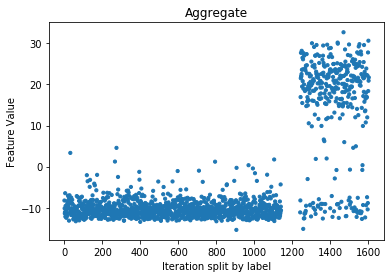

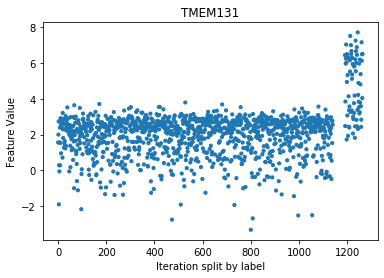

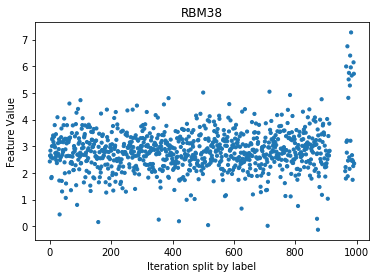

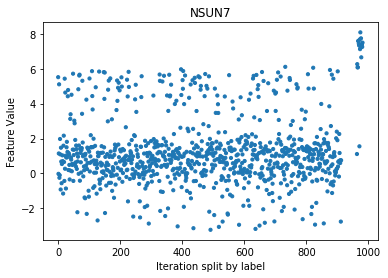

In [162]:
label1 = 8
label2 = 13
featurenamelist = ['MUC16', 'LPAR3', 'KLK11', 'FAM181A', 'KLK5', 'UPK3B']
reverse = [0, 0, 0, 1, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 6:

        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TMEM131'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 4 and v > 1:

        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'RBM38'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 5.1:

        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'NSUN7'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Pancreas


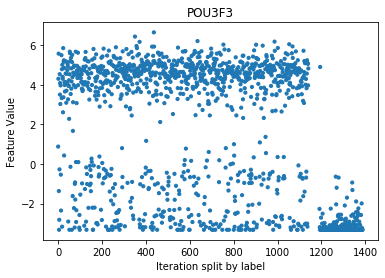

['CCDC102A', 'RAB1A', 'TRIM47', 'GLCE', 'RALGAPB', 'ZNF174']
[0, 0, 0, 0, 0, 0]


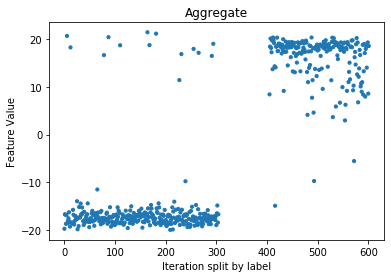

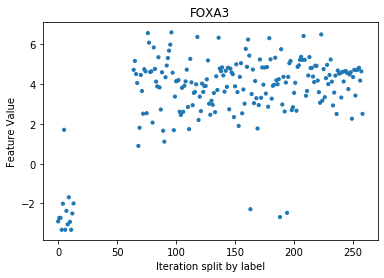

In [163]:
label1 = 8
label2 = 14
featurename = 'POU3F3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['CCDC102A', 'RAB1A', 'TRIM47', 'GLCE', 'RALGAPB', 'ZNF174']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v > -7.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'FOXA3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Peritoneum


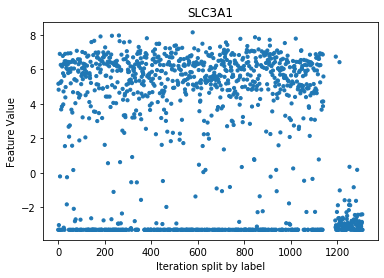

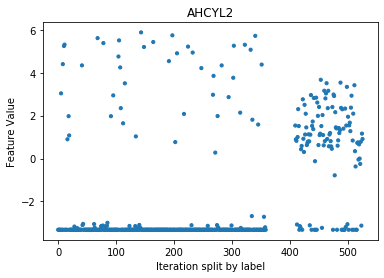

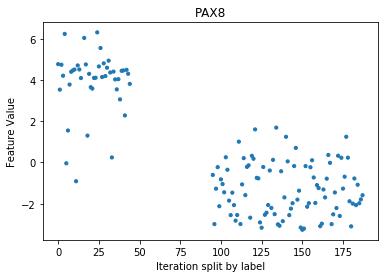

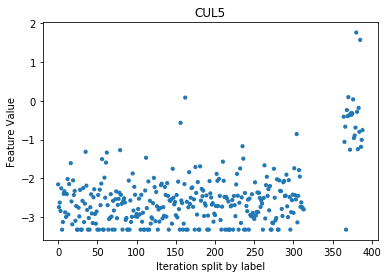

In [164]:
label1 = 8
label2 = 15
featurename = 'SLC3A1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'AHCYL2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -2:
        
        tmpindexlist.append(i)
        
    if v < -2:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PAX8'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'CUL5'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Prostate
['ST6GALNAC1', 'CUX2', 'TTC6', 'LRRC26', 'TMEFF2', 'C9orf152']
[0, 0, 0, 0, 0, 0]


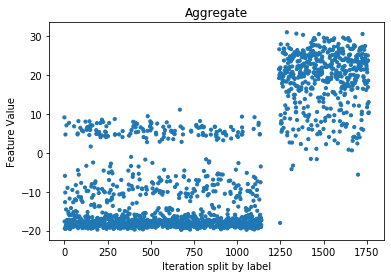

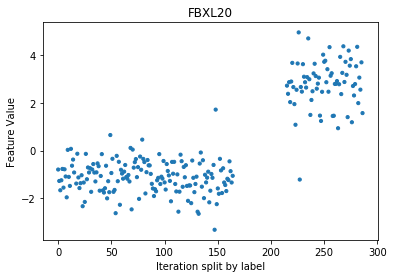

In [165]:
label1 = 8
label2 = 16
featurenamelist = ['ST6GALNAC1', 'CUX2', 'TTC6', 'LRRC26', 'TMEFF2', 'C9orf152']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 10 and v > -5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'FBXL20'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Sarcoma
['SHOX2', 'HPN', 'CRB3', 'KLHDC7A', 'CDH16', 'C1orf210']
[0, 1, 1, 1, 1, 1]


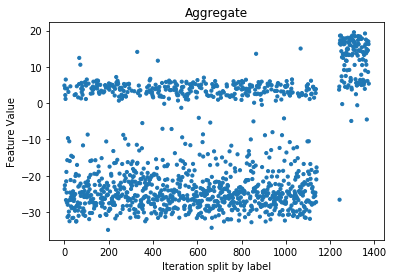

['PLCXD1', 'SLC25A25', 'MOB1A', 'ARIH2', 'C9orf16', 'METTL17']
[0, 0, 0, 0, 0, 0]


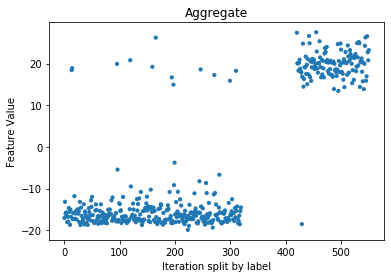

In [166]:
label1 = 8
label2 = 17
featurenamelist = ['SHOX2', 'HPN', 'CRB3', 'KLHDC7A', 'CDH16', 'C1orf210']
reverse = [0, 1, 1, 1, 1, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)

graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['PLCXD1', 'SLC25A25', 'MOB1A', 'ARIH2', 'C9orf16', 'METTL17']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Kidney  and  Skin


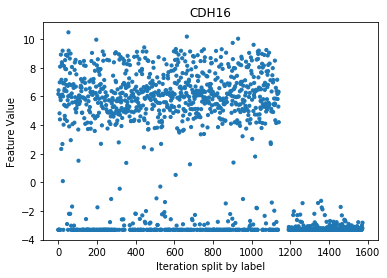

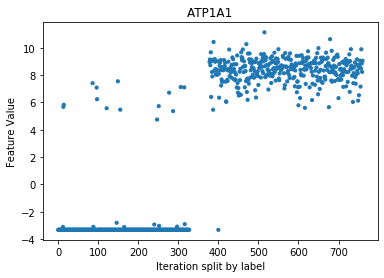

['PAX3', 'GPM6B', 'CCDC140', 'EDNRB', 'RGS20', 'SGCD']
[0, 0, 0, 0, 0, 0]


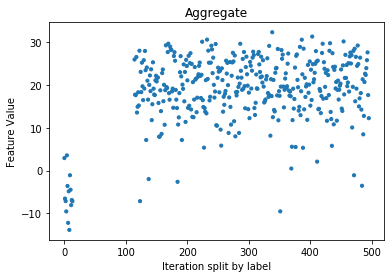

In [167]:
label1 = 8
label2 = 18
featurename = 'CDH16'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ATP1A1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -2:

        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['PAX3', 'GPM6B', 'CCDC140', 'EDNRB', 'RGS20', 'SGCD']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Kidney  and  Stomach
['EMX2', 'PITX1', 'PAX2', 'ST6GALNAC1', 'CEACAM6', 'FOXA1']
[0, 1, 0, 1, 1, 1]


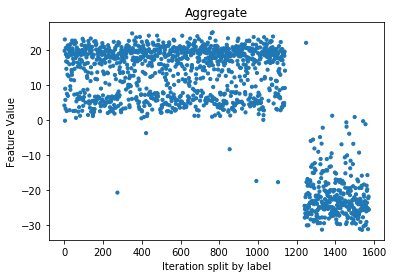

In [168]:
label1 = 8
label2 = 19
featurenamelist = ['EMX2', 'PITX1', 'PAX2', 'ST6GALNAC1', 'CEACAM6', 'FOXA1']
reverse = [0, 1, 0, 1, 1, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Kidney  and  Testis


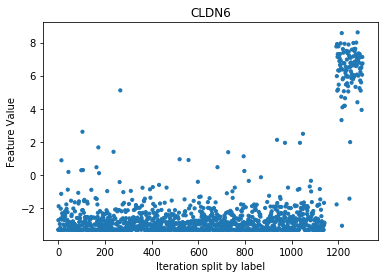

In [169]:
label1 = 8
label2 = 20
featurename = 'CLDN6'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Thyroid


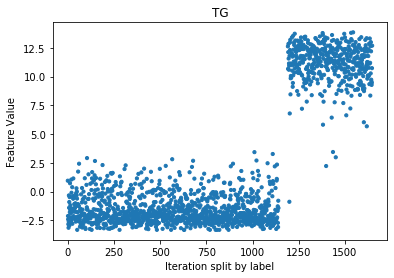

In [170]:
label1 = 8
label2 = 21
featurename = 'TG'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Kidney  and  Uterus
['IGSF9', 'ALDH3B2', 'RCOR2', 'LGR5', 'SIX4', 'AQP5']
[0, 0, 0, 0, 0, 0]


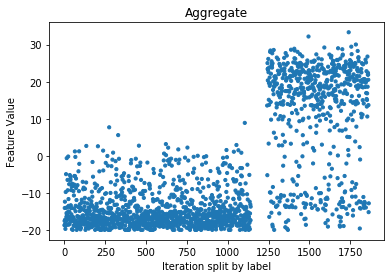

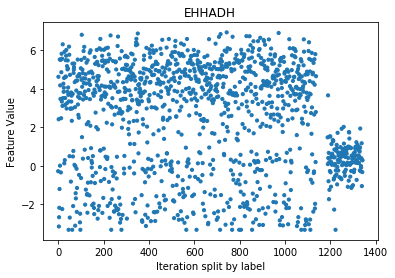

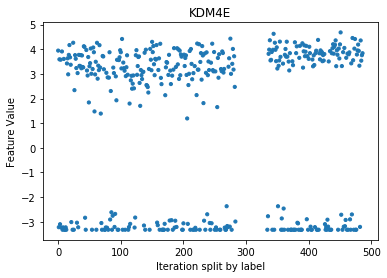

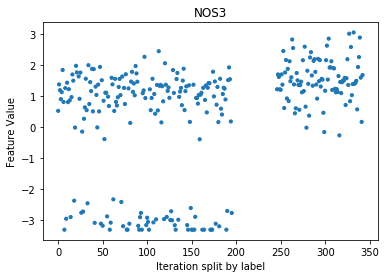

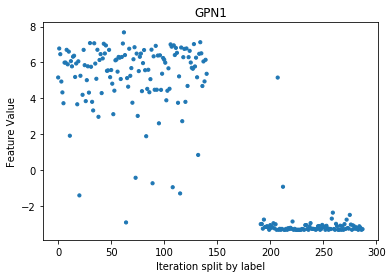

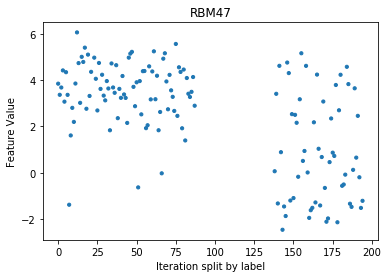

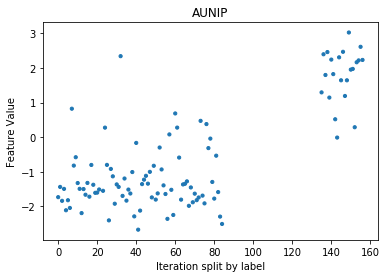

In [171]:
label1 = 8
label2 = 22
featurenamelist = ['IGSF9', 'ALDH3B2', 'RCOR2', 'LGR5', 'SIX4', 'AQP5']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'EHHADH'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 2.5 and v > -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'KDM4E'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 0:
        
        tmpindexlist.append(i)
        
    if v < 0:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'NOS3'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'GPN1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'RBM47'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'AUNIP'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Leukemia  and  Liver


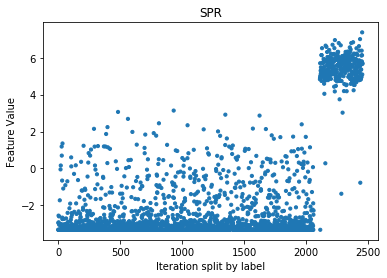

In [172]:
label1 = 9
label2 = 10
featurename = 'SPR'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Leukemia  and  Lung
['CLDN4', 'RAB25', 'HID1', 'EDNRA', 'NUPR1', 'EPS8L2']
[0, 0, 0, 0, 0, 0]


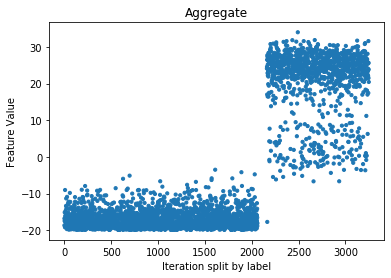

In [173]:
label1 = 9
label2 = 11
featurenamelist = ['CLDN4', 'RAB25', 'HID1', 'EDNRA', 'NUPR1', 'EPS8L2']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Leukemia  and  Lymph


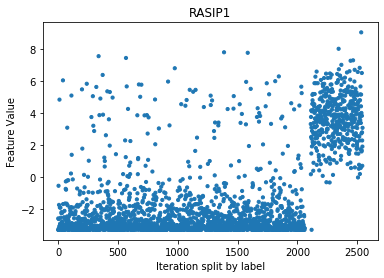

['CD2BP2', 'MRPS23', 'CST3', 'OXA1L', 'SLC1A5', 'PCMT1']
[0, 0, 0, 0, 0, 0]


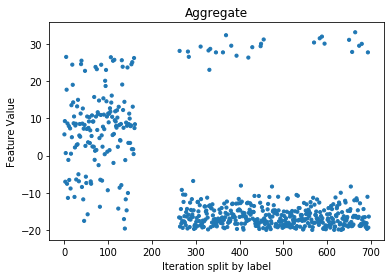

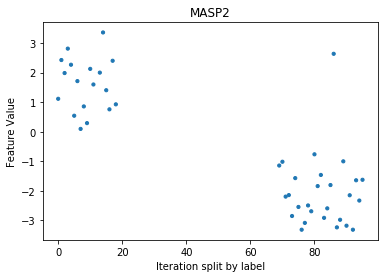

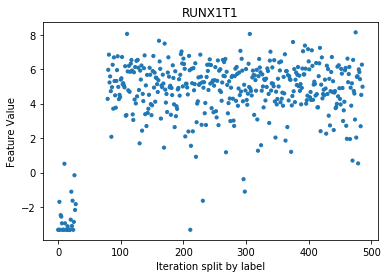

In [174]:
label1 = 9
label2 = 12
featurename = 'RASIP1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > -0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['CD2BP2', 'MRPS23', 'CST3', 'OXA1L', 'SLC1A5', 'PCMT1']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v > 22:
        
        tmpindexlist.append(i)
        
    if v < -5:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'MASP2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurename = 'RUNX1T1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Leukemia  and  Ovarian


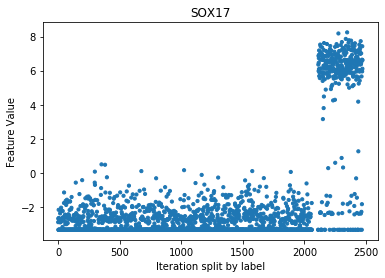

['ADCY5', 'USHBP1', 'KCNK3', 'NHLH2', 'MEP1A', 'MAGEB17']
[0, 0, 0, 0, 0, 0]


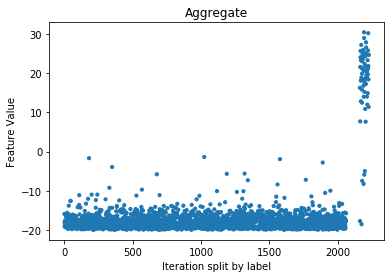

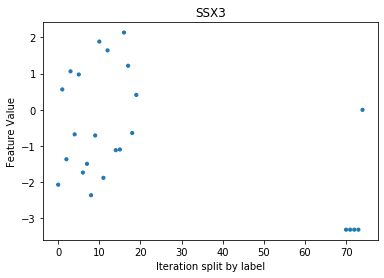

In [175]:
label1 = 9
label2 = 13
featurename = 'SOX17'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['ADCY5', 'USHBP1', 'KCNK3', 'NHLH2', 'MEP1A', 'MAGEB17']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v > -11 and v < 3:
        
        tmpindexlist.append(i)
        
indexlist = tmpindexlist

#new value
featurename = 'SSX3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Leukemia  and  Pancreas
['FKBP10', 'CLDN4', 'SORBS2', 'RNF180', 'CADPS2', 'COL13A1']
[0, 0, 0, 0, 0, 0]


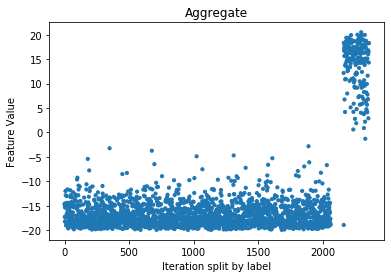

In [176]:
label1 = 9
label2 = 14
featurenamelist = ['FKBP10', 'CLDN4', 'SORBS2', 'RNF180', 'CADPS2', 'COL13A1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Leukemia  and  Peritoneum


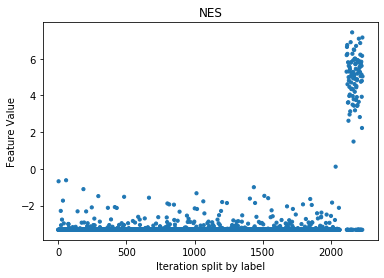

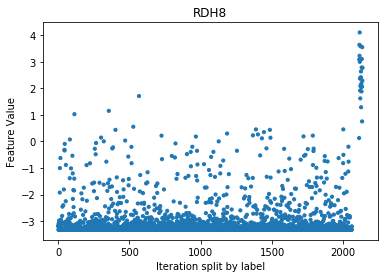

In [177]:
label1 = 9
label2 = 15
featurename = 'NES'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'RDH8'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Leukemia  and  Prostate


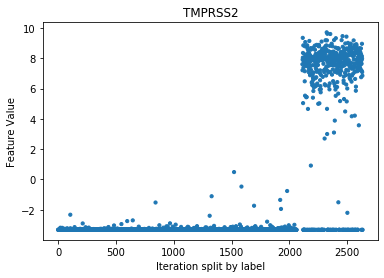

['TRIM55', 'EFCAB3', 'GIPR', 'SLC6A20', 'CYP8B1', 'ALLC']
[0, 0, 0, 0, 0, 0]


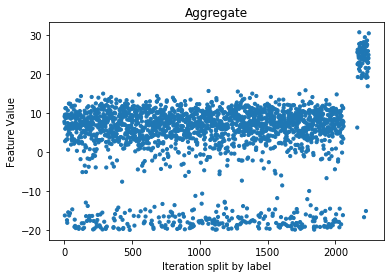

In [178]:
label1 = 9
label2 = 16
featurename = 'TMPRSS2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['TRIM55', 'EFCAB3', 'GIPR', 'SLC6A20', 'CYP8B1', 'ALLC']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Leukemia  and  Sarcoma
['YAP1', 'SPARCL1', 'EGFR', 'TJP1', 'BGN', 'ADGRL4']
[0, 0, 0, 0, 0, 0]


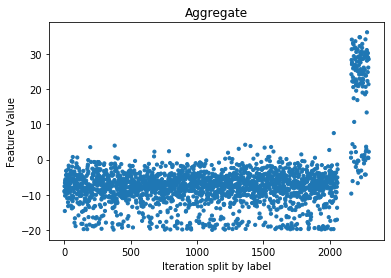

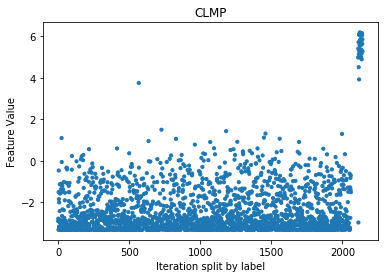

In [179]:
label1 = 9
label2 = 17
featurenamelist = ['YAP1', 'SPARCL1', 'EGFR', 'TJP1', 'BGN', 'ADGRL4']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 7.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CLMP'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Leukemia  and  Skin


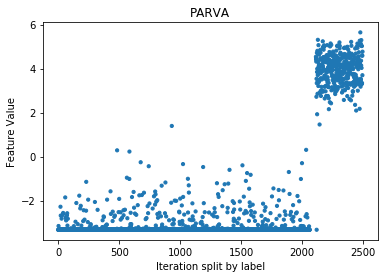

In [180]:
label1 = 9
label2 = 18
featurename = 'PARVA'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Leukemia  and  Stomach


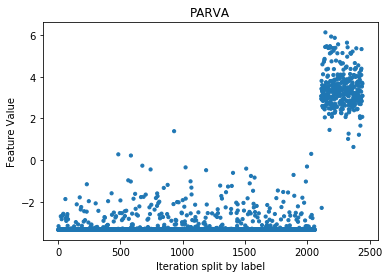

In [181]:
label1 = 9
label2 = 19
featurename = 'PARVA'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Leukemia  and  Testis


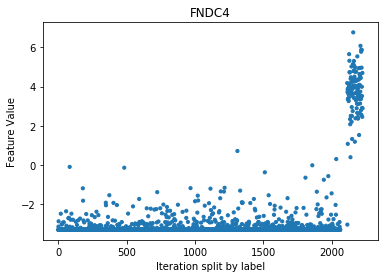

In [182]:
label1 = 9
label2 = 20
featurename = 'FNDC4'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Leukemia  and  Thyroid


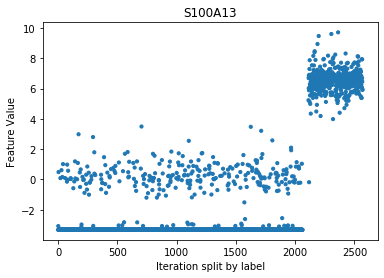

In [183]:
label1 = 9
label2 = 21
featurename = 'S100A13'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Leukemia  and  Uterus
['NUPR1', 'SELENOM', 'COL4A2', 'HID1', 'DLL4', 'PARVA']
[0, 0, 0, 0, 0, 0]


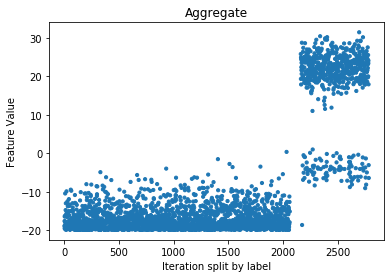

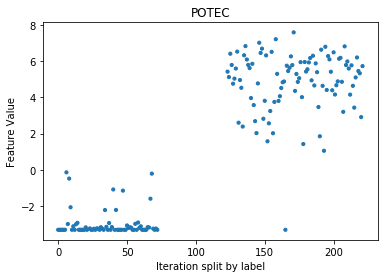

In [184]:
label1 = 9
label2 = 22
featurenamelist = ['NUPR1', 'SELENOM', 'COL4A2', 'HID1', 'DLL4', 'PARVA']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 5 and v > -10:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'POTEC'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Liver  and  Lung


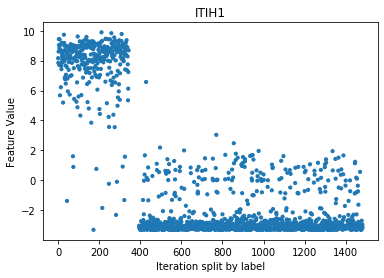

In [185]:
label1 = 10
label2 = 11
featurename = 'ITIH1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Liver  and  Lymph


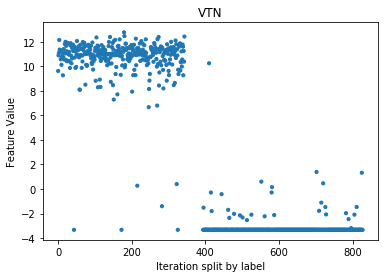

In [186]:
label1 = 10
label2 = 12
featurename = 'VTN'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Liver  and  Ovarian


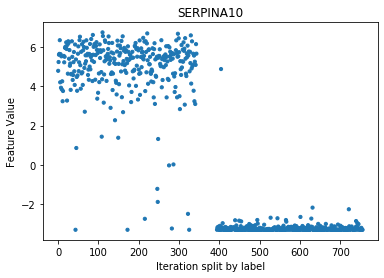

In [187]:
label1 = 10
label2 = 13
featurename = 'SERPINA10'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Liver  and  Pancreas


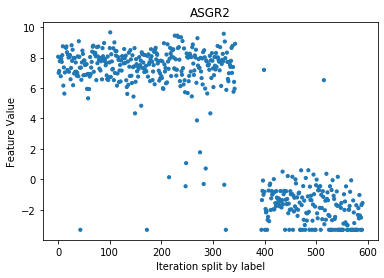

In [188]:
label1 = 10
label2 = 14
featurename = 'ASGR2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Liver  and  Peritoneum


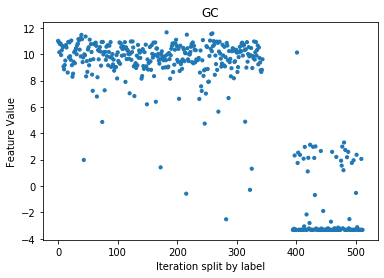

In [189]:
label1 = 10
label2 = 15
featurename = 'GC'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Liver  and  Prostate
['TMEFF2', 'NWD1', 'ITIH2', 'APOB', 'OR51E2', 'HNF4A']
[0, 0, 1, 1, 0, 1]


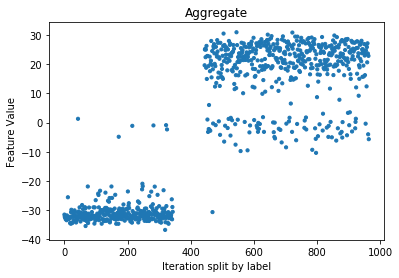

In [190]:
label1 = 10
label2 = 16
featurenamelist = ['TMEFF2', 'NWD1', 'ITIH2', 'APOB', 'OR51E2', 'HNF4A']
reverse = [0, 0, 1, 1, 0, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Liver  and  Sarcoma


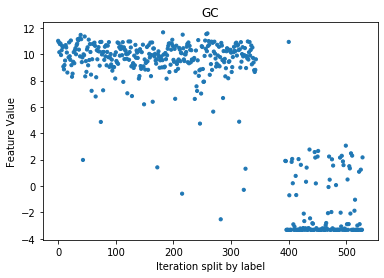

In [191]:
label1 = 10
label2 = 17
featurename = 'GC'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Liver  and  Skin


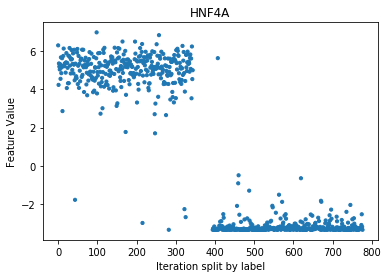

In [192]:
label1 = 10
label2 = 18
featurename = 'HNF4A'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Liver  and  Stomach


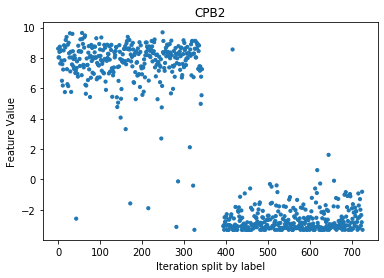

In [193]:
label1 = 10
label2 = 19
featurename = 'CPB2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Liver  and  Testis
['SLC4A8', 'ADD2', 'L1TD1', 'INA', 'RIMS4', 'CDH3']
[0, 0, 0, 0, 0, 0]


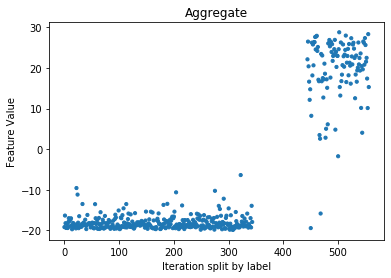

In [194]:
label1 = 10
label2 = 20
featurenamelist = ['SLC4A8', 'ADD2', 'L1TD1', 'INA', 'RIMS4', 'CDH3']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Liver  and  Thyroid


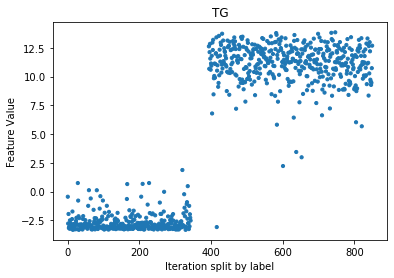

In [195]:
label1 = 10
label2 = 21
featurename = 'TG'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Liver  and  Uterus


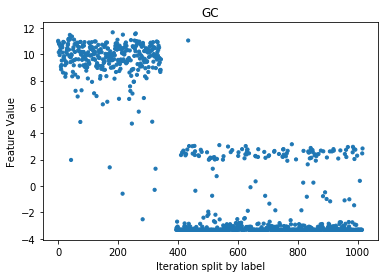

In [196]:
label1 = 10
label2 = 22
featurename = 'GC'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lung  and  Lymph


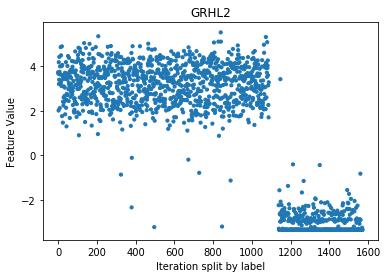

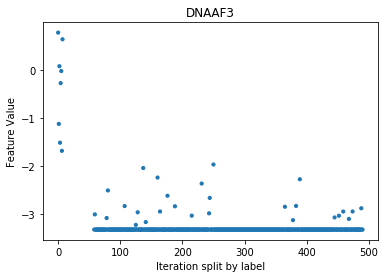

In [197]:
label1 = 11
label2 = 12
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'DNAAF3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lung  and  Ovarian
['PAX8', 'KLHL14', 'SOX17', 'APOA1', 'SCGB1D2', 'EMX2']
[0, 0, 0, 0, 0, 0]


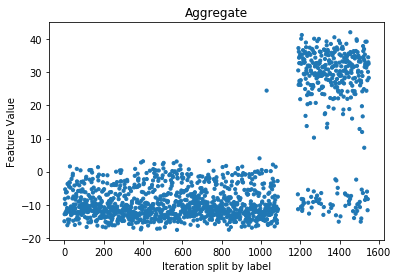

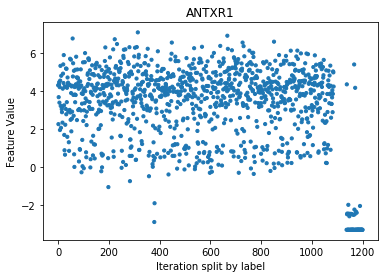

In [198]:
label1 = 11
label2 = 13
featurenamelist = ['PAX8', 'KLHL14', 'SOX17', 'APOA1', 'SCGB1D2', 'EMX2']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ANTXR1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lung  and  Pancreas


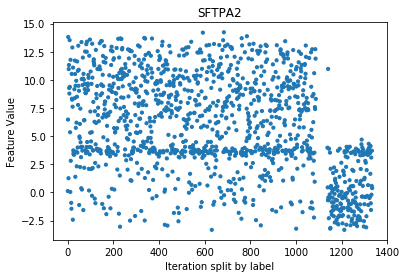

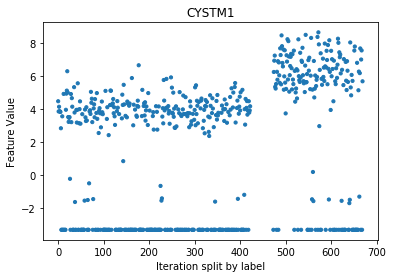

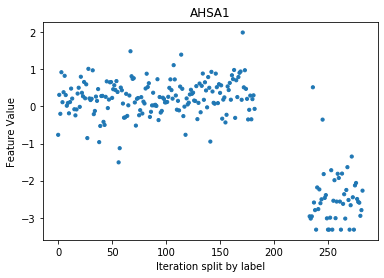

['SFTPB', 'SFTPA1', 'SFTPA2', 'SFTA3', 'TBX5', 'SLC22A31']
[0, 0, 0, 0, 0, 0]


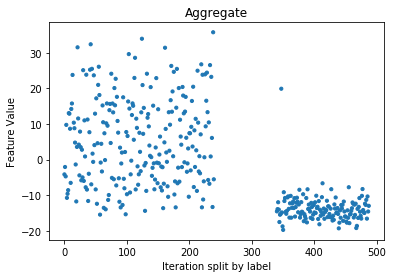

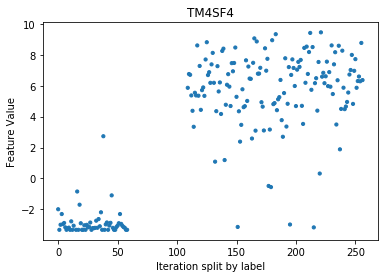

In [199]:
label1 = 11
label2 = 14
featurename = 'SFTPA2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CYSTM1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist2 = list()
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 1.5:
        
        tmpindexlist.append(i)
        
    if v > 1.5:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'AHSA1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurenamelist = ['SFTPB', 'SFTPA1', 'SFTPA2', 'SFTA3', 'TBX5', 'SLC22A31']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < -5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TM4SF4'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lung  and  Peritoneum
['GRHL2', 'MARVELD3', 'RAB25', 'CLDN4', 'PERP', 'LAD1']
[0, 0, 0, 0, 0, 0]


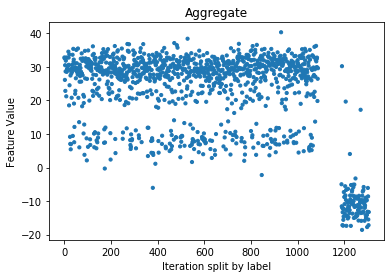

In [200]:
label1 = 11
label2 = 15
featurenamelist = ['GRHL2', 'MARVELD3', 'RAB25', 'CLDN4', 'PERP', 'LAD1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Lung  and  Prostate
['CAB39L', 'PLPP1', 'ABCC4', 'SLC45A3', 'ZNF613', 'TBX3']
[0, 0, 0, 0, 0, 0]


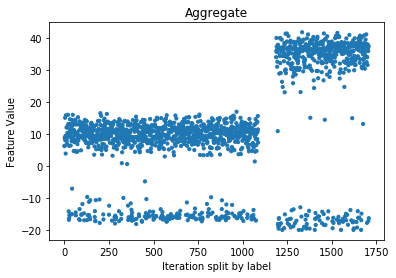

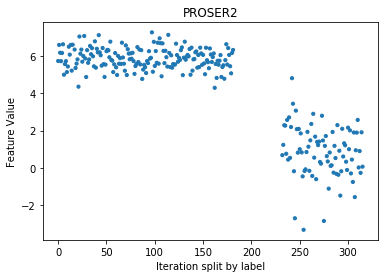

In [201]:
label1 = 11
label2 = 16
featurenamelist = ['CAB39L', 'PLPP1', 'ABCC4', 'SLC45A3', 'ZNF613', 'TBX3']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < -5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PROSER2'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lung  and  Sarcoma


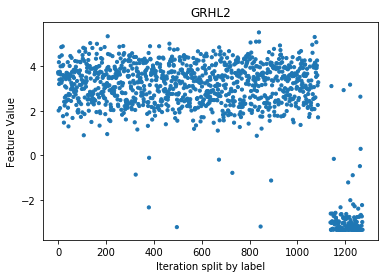

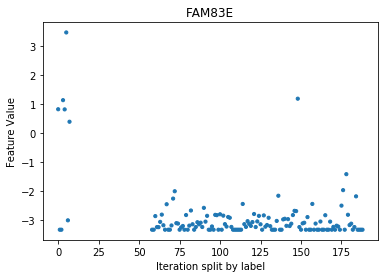

In [202]:
label1 = 11
label2 = 17
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'FAM83E'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lung  and  Skin


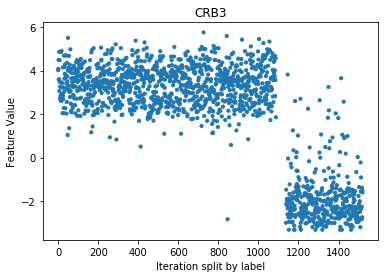

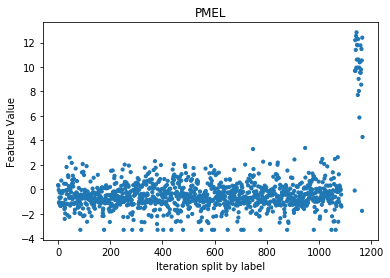

In [203]:
label1 = 11
label2 = 18
featurename = 'CRB3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PMEL'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lung  and  Stomach


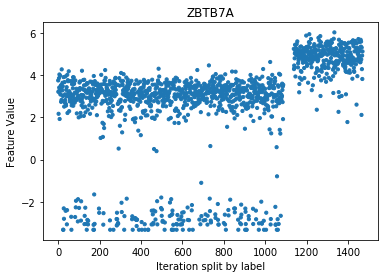

['F8A3', 'EIF3CL', 'POTEJ', 'GJD3', 'MTRNR2L8', 'ZFPM1']
[0, 0, 0, 0, 1, 0]


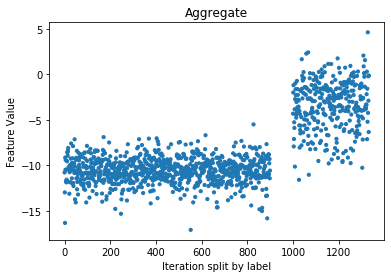

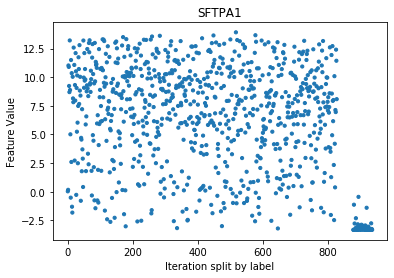

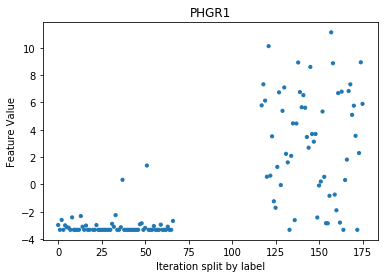

In [204]:
label1 = 11
label2 = 19
featurename = 'ZBTB7A'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['F8A3', 'EIF3CL', 'POTEJ', 'GJD3', 'MTRNR2L8', 'ZFPM1']
reverse = [0, 0, 0, 0, 1, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < -6 and v > -12.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'SFTPA1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PHGR1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lung  and  Testis


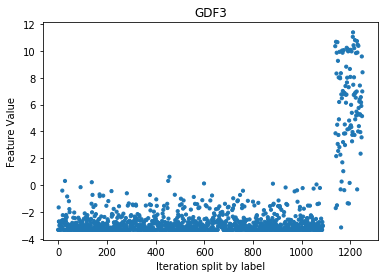

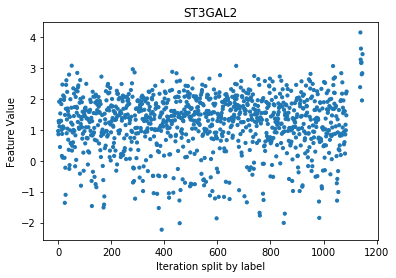

In [205]:
label1 = 11
label2 = 20
featurename = 'GDF3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ST3GAL2'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lung  and  Thyroid


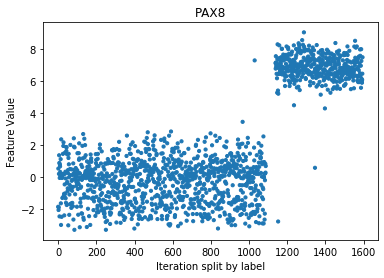

In [206]:
label1 = 11
label2 = 21
featurename = 'PAX8'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lung  and  Uterus


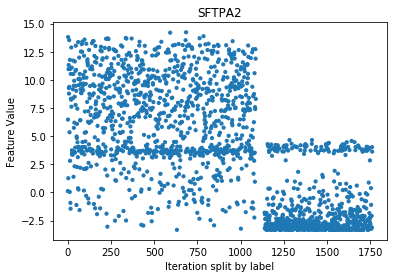

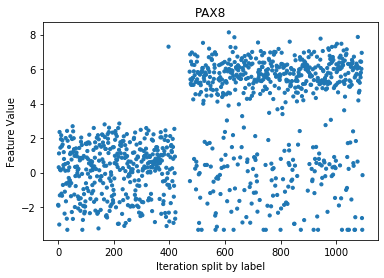

['ADGRE3', 'PLET1', 'CD300LB', 'EEF2', 'SF3A2', 'PTPN23']
[0, 0, 0, 1, 1, 1]


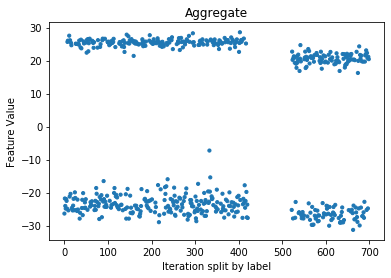

['ELMO2', 'CFAP65', 'NOL3', 'TAAR2', 'ZBTB45', 'CREBRF']
[0, 0, 0, 1, 1, 0]


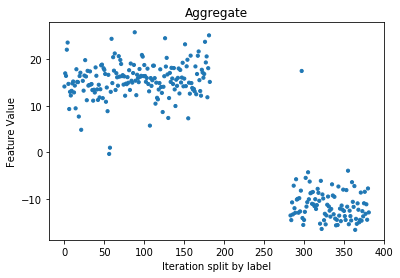

['EMX2', 'LEFTY2', 'HOXD3', 'ZCCHC12', 'MAPK13', 'DES']
[0, 0, 0, 0, 1, 0]


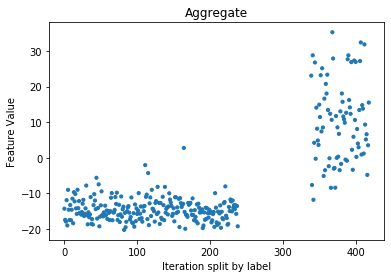

In [207]:
label1 = 11
label2 = 22
featurename = 'SFTPA2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PAX8'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['ADGRE3', 'PLET1', 'CD300LB', 'EEF2', 'SF3A2', 'PTPN23']
reverse = [0, 0, 0, 1, 1, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v > 2:
        
        tmpindexlist.append(i)
        
    if v < 2:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['ELMO2', 'CFAP65', 'NOL3', 'TAAR2', 'ZBTB45', 'CREBRF']
reverse = [0, 0, 0, 1, 1, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurenamelist = ['EMX2', 'LEFTY2', 'HOXD3', 'ZCCHC12', 'MAPK13', 'DES']
reverse = [0, 0, 0, 0, 1, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Lymph  and  Ovarian
['JMJD6', 'PLIN3', 'ACLY', 'SGTA', 'ZPR1', 'TRIM11']
[0, 0, 0, 0, 0, 0]


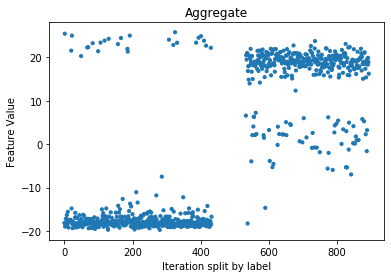

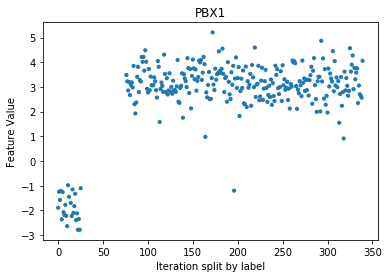

In [208]:
label1 = 12
label2 = 13
featurenamelist = ['JMJD6', 'PLIN3', 'ACLY', 'SGTA', 'ZPR1', 'TRIM11']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > 17:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PBX1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lymph  and  Pancreas
['TNFRSF11A', 'CAPN5', 'FUT2', 'PROS1', 'HGD', 'LRRC66']
[0, 0, 0, 0, 0, 0]


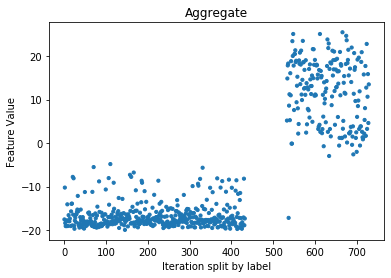

In [209]:
label1 = 12
label2 = 14
featurenamelist = ['TNFRSF11A', 'CAPN5', 'FUT2', 'PROS1', 'HGD', 'LRRC66']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Lymph  and  Peritoneum


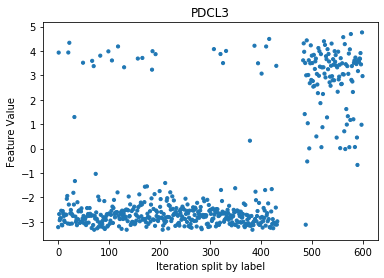

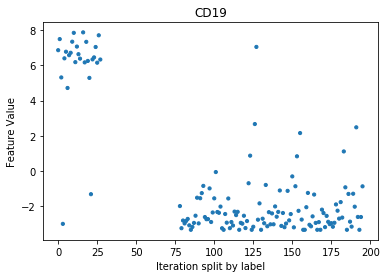

In [210]:
label1 = 12
label2 = 15
featurename = 'PDCL3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > -0.75:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CD19'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lymph  and  Prostate


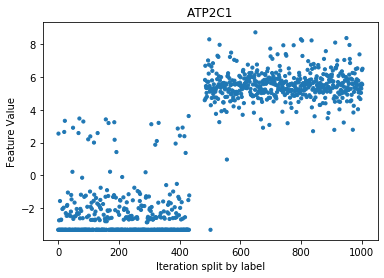

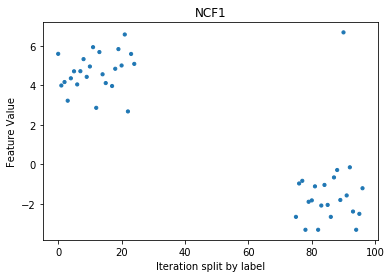

In [211]:
label1 = 12
label2 = 16
featurename = 'ATP2C1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 1.5 and v < 4:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'NCF1'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lymph  and  Sarcoma


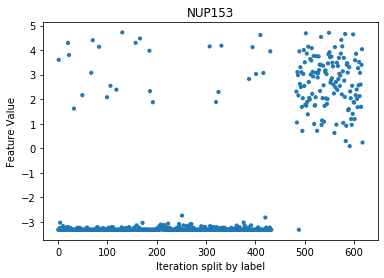

['FKBP7', 'FKBP9', 'FKBP10', 'LAPTM4B', 'PPIC', 'SYDE1']
[0, 0, 0, 0, 0, 0]


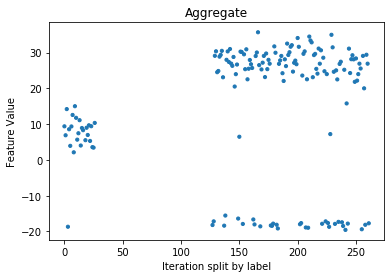

In [212]:
label1 = 12
label2 = 17
featurename = 'NUP153'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['FKBP7', 'FKBP9', 'FKBP10', 'LAPTM4B', 'PPIC', 'SYDE1']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Lymph  and  Skin


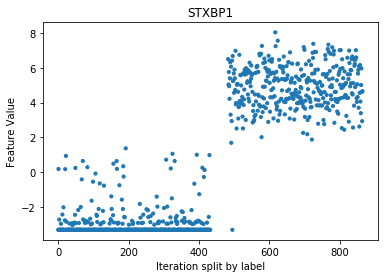

In [213]:
label1 = 12
label2 = 18
featurename = 'STXBP1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lymph  and  Stomach


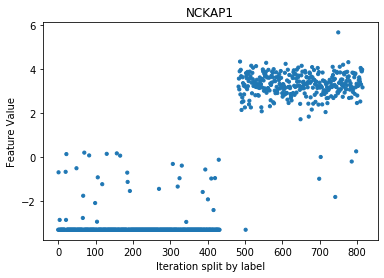

In [214]:
label1 = 12
label2 = 19
featurename = 'NCKAP1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lymph  and  Testis


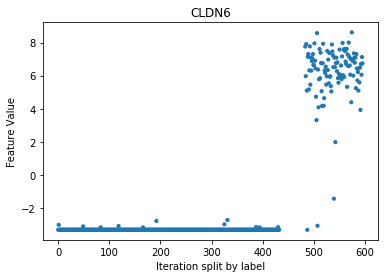

In [215]:
label1 = 12
label2 = 20
featurename = 'CLDN6'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lymph  and  Thyroid


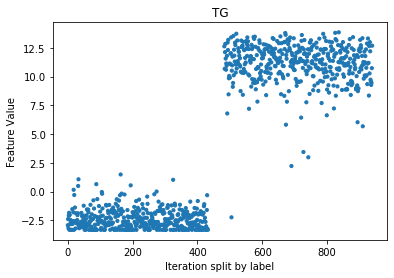

In [216]:
label1 = 12
label2 = 21
featurename = 'TG'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Lymph  and  Uterus


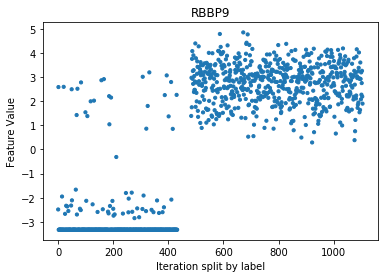

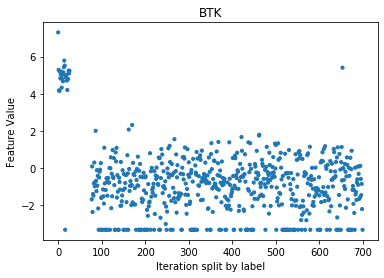

In [217]:
label1 = 12
label2 = 22
featurename = 'RBBP9'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > -0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'BTK'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Ovarian  and  Pancreas


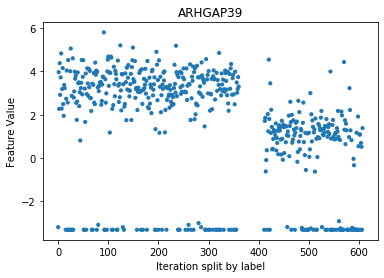

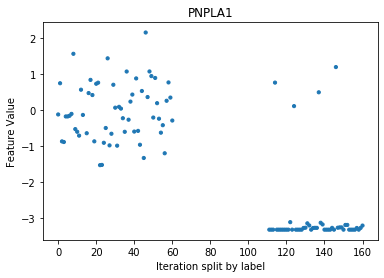

['ZNF771', 'CTU1', 'SOX17', 'CTXN1', 'HNF4A', 'SOX12']
[0, 0, 0, 0, 1, 0]


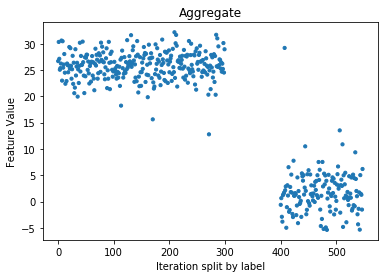

In [218]:
label1 = 13
label2 = 14
featurename = 'ARHGAP39'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
tmpindexlist2 = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -2:
        
        tmpindexlist.append(i)
        
    if v > -2:
        
        tmpindexlist2.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PNPLA1'
graphpairfeature(df, featurename, label1, label2, indexlist)
#other side of split
indexlist = tmpindexlist2

#new value
featurenamelist = ['ZNF771', 'CTU1', 'SOX17', 'CTXN1', 'HNF4A', 'SOX12']
reverse = [0, 0, 0, 0, 1, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Ovarian  and  Peritoneum
['SLC34A2', 'CLDN3', 'CLDN7', 'SCNN1A', 'AP1M2', 'GRB7']
[0, 0, 0, 0, 0, 0]


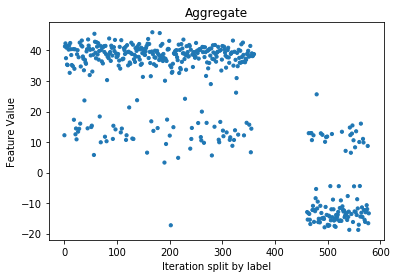

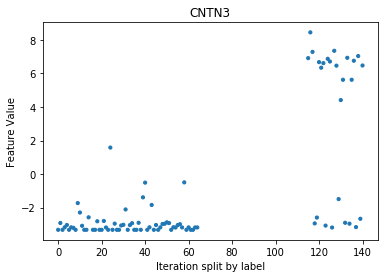

In [219]:
label1 = 13
label2 = 15
featurenamelist = ['SLC34A2', 'CLDN3', 'CLDN7', 'SCNN1A', 'AP1M2', 'GRB7']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 22 and v > 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CNTN3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Ovarian  and  Prostate


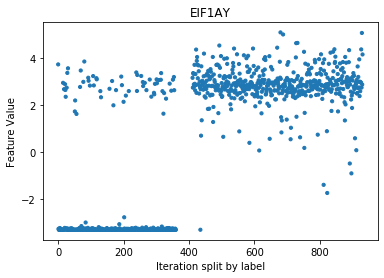

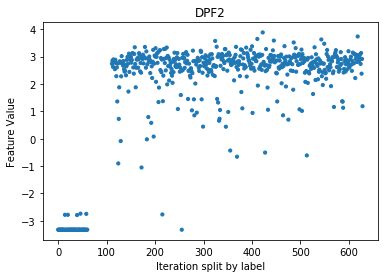

In [220]:
label1 = 13
label2 = 16
featurename = 'EIF1AY'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > -0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'DPF2'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Ovarian  and  Sarcoma
['TMPRSS3', 'CLDN3', 'OVOL2', 'SCNN1A', 'AP1M2', 'KLK8']
[0, 0, 0, 0, 0, 0]


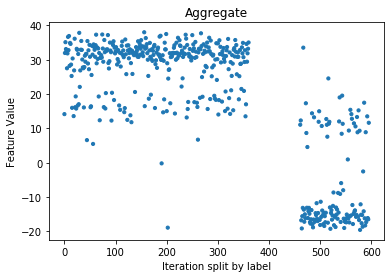

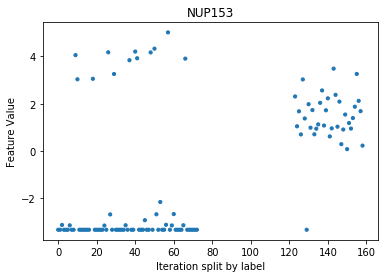

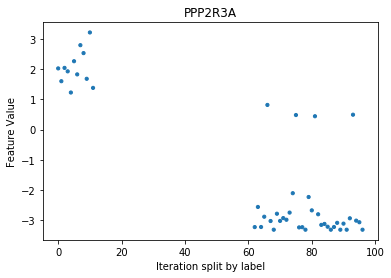

In [221]:
label1 = 13
label2 = 17
featurenamelist = ['TMPRSS3', 'CLDN3', 'OVOL2', 'SCNN1A', 'AP1M2', 'KLK8']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 25 and v > 3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist


#new value
featurename = 'NUP153'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > -1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PPP2R3A'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Ovarian  and  Skin
['MEIS1', 'SOX17', 'EPCAM', 'ATP6V1B1', 'SRGAP3', 'ESR1']
[0, 0, 0, 0, 0, 0]


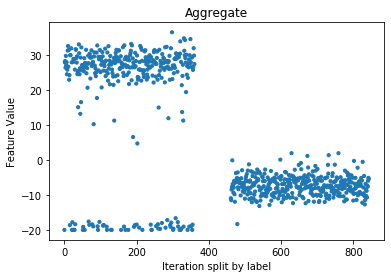

In [222]:
label1 = 13
label2 = 18
featurenamelist = ['MEIS1', 'SOX17', 'EPCAM', 'ATP6V1B1', 'SRGAP3', 'ESR1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Ovarian  and  Stomach
['EMX2', 'WT1', 'SCGB1D2', 'EPS8L3', 'HNF4A', 'FAM181A']
[0, 0, 0, 1, 1, 0]


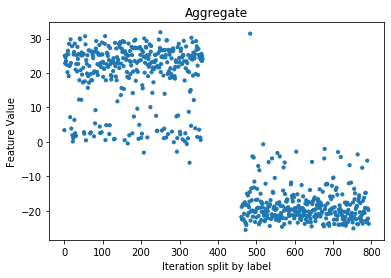

In [223]:
label1 = 13
label2 = 19
featurenamelist = ['EMX2', 'WT1', 'SCGB1D2', 'EPS8L3', 'HNF4A', 'FAM181A']
reverse = [0, 0, 0, 1, 1, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Ovarian  and  Testis


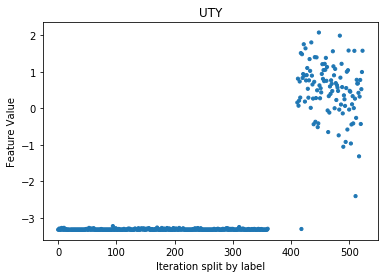

In [224]:
label1 = 13
label2 = 20
featurename = 'UTY'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Ovarian  and  Thyroid


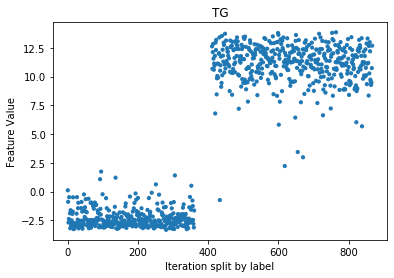

In [225]:
label1 = 13
label2 = 21
featurename = 'TG'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Ovarian  and  Uterus


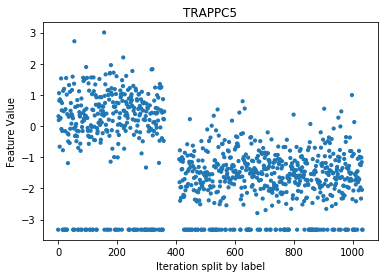

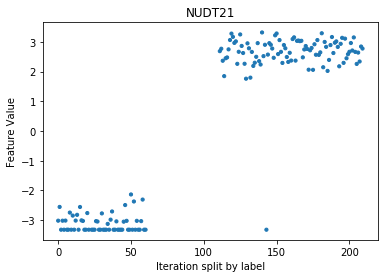

['TRAPPC5', 'F8A3', 'CTU1', 'CMC4', 'RPL18A', 'ZNF771']
[0, 0, 0, 0, 0, 0]


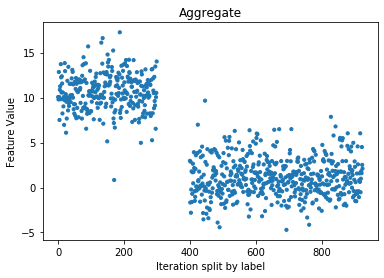

In [226]:
label1 = 13
label2 = 22
featurename = 'TRAPPC5'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist2 = list()
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -3:
        
        tmpindexlist.append(i)
    
    if v > -3:
        
        tmpindexlist2.append(i)
        
indexlist = tmpindexlist

#new value
featurename = 'NUDT21'
graphpairfeature(df, featurename, label1, label2, indexlist)

#other side of split
indexlist = tmpindexlist2

#new value
featurenamelist = ['TRAPPC5', 'F8A3', 'CTU1', 'CMC4', 'RPL18A', 'ZNF771']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)


Labels being compared: Pancreas  and  Peritoneum


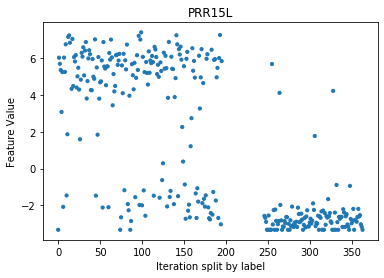

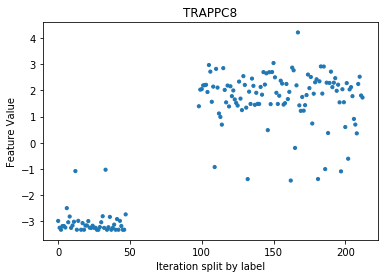

In [227]:
label1 = 14
label2 = 15
featurename = 'PRR15L'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'TRAPPC8'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Pancreas  and  Prostate


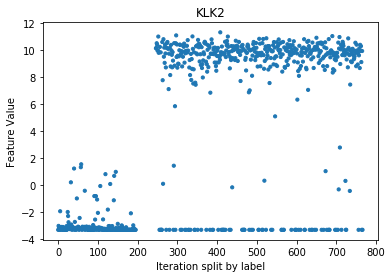

['GNA15', 'SBNO2', 'TRIM47', 'CCDC102A', 'CCDC38', 'RHAG']
[0, 0, 0, 0, 1, 1]


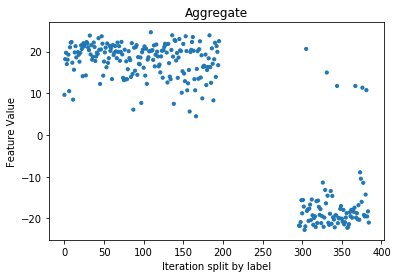

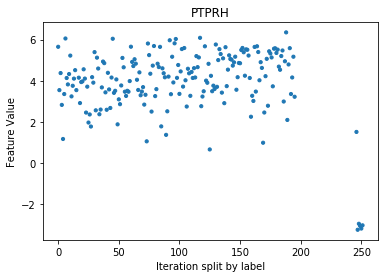

In [228]:
label1 = 14
label2 = 16
featurename = 'KLK2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 3:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['GNA15', 'SBNO2', 'TRIM47', 'CCDC102A', 'CCDC38', 'RHAG']
reverse = [0, 0, 0, 0, 1, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PTPRH'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Pancreas  and  Sarcoma
['CLDN4', 'FUT2', 'HGD', 'FA2H', 'GRB7', 'SULT2B1']
[0, 0, 0, 0, 0, 0]


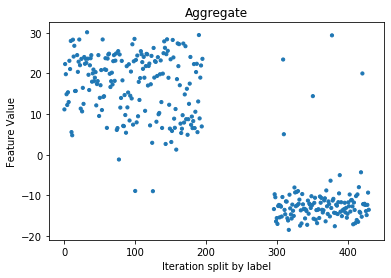

In [229]:
label1 = 14
label2 = 17
featurenamelist = ['CLDN4', 'FUT2', 'HGD', 'FA2H', 'GRB7', 'SULT2B1']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Pancreas  and  Skin


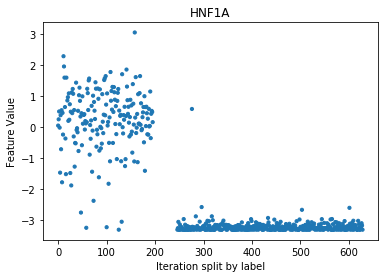

In [230]:
label1 = 14
label2 = 18
featurename = 'HNF1A'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Pancreas  and  Stomach


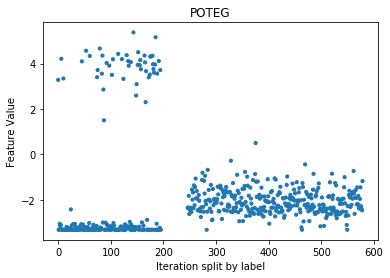

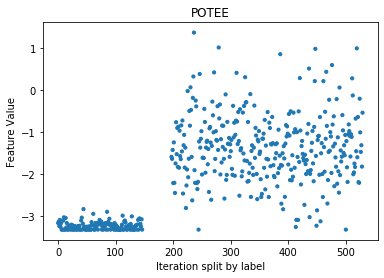

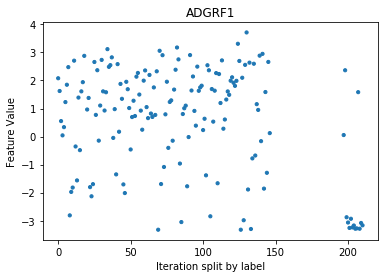

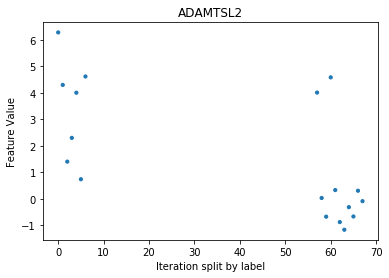

In [231]:
label1 = 14
label2 = 19
featurename = 'POTEG'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'POTEE'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2.7:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ADGRF1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < -2.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ADAMTSL2'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Pancreas  and  Testis


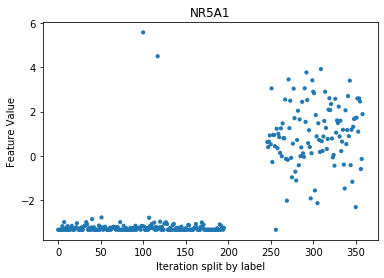

In [232]:
label1 = 14
label2 = 20
featurename = 'NR5A1'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Pancreas  and  Thyroid


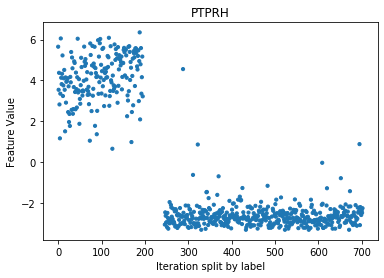

In [233]:
label1 = 14
label2 = 21
featurename = 'PTPRH'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Pancreas  and  Uterus
['HOXD10', 'HOXD9', 'EMX2', 'GC', 'PPY', 'SPINK1']
[0, 0, 0, 1, 1, 1]


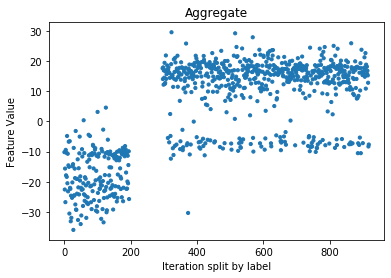

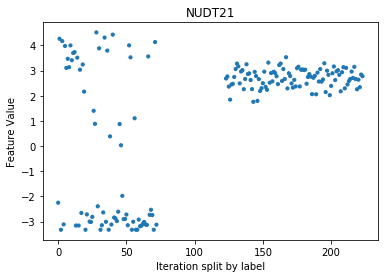

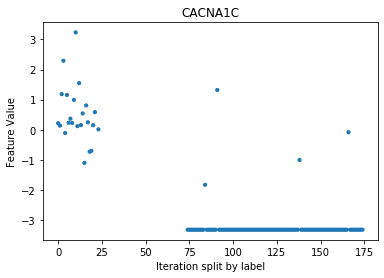

In [234]:
label1 = 14
label2 = 22
featurenamelist = ['HOXD10', 'HOXD9', 'EMX2', 'GC', 'PPY', 'SPINK1']
reverse = [0, 0, 0, 1, 1, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 0 and v > -15:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'NUDT21'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CACNA1C'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Peritoneum  and  Prostate
['AZGP1', 'PLA2G4F', 'EVPL', 'OVOL2', 'ARHGEF16', 'DSP']
[0, 0, 0, 0, 0, 0]


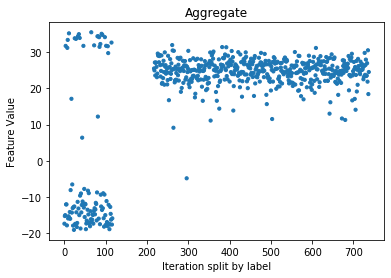

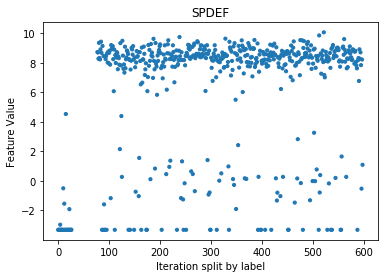

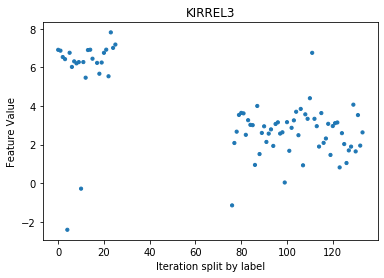

In [235]:
label1 = 15
label2 = 16
featurenamelist = ['AZGP1', 'PLA2G4F', 'EVPL', 'OVOL2', 'ARHGEF16', 'DSP']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v > 5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'SPDEF'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'KIRREL3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Peritoneum  and  Sarcoma


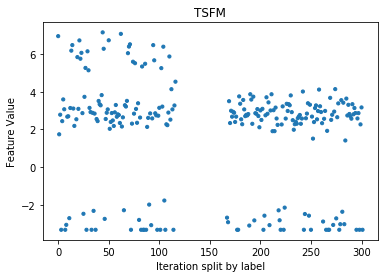

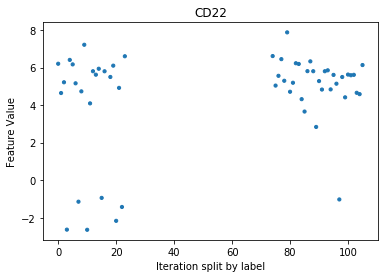

In [236]:
label1 = 15
label2 = 17
featurename = 'TSFM'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CD22'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Peritoneum  and  Skin


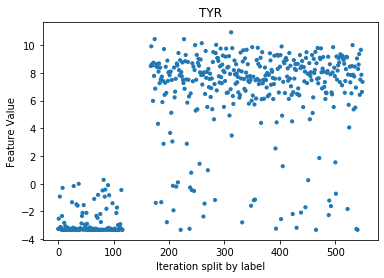

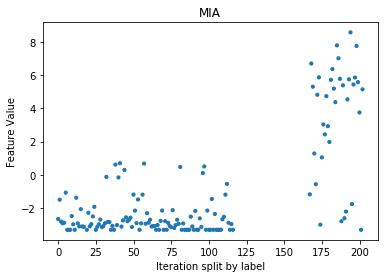

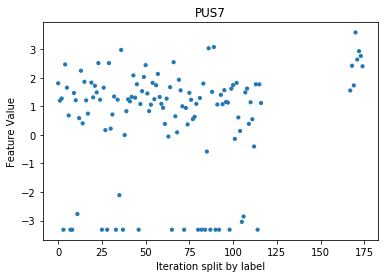

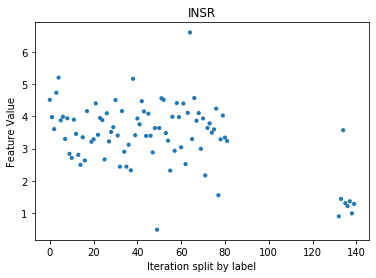

In [237]:
label1 = 15
label2 = 18
featurename = 'TYR'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'MIA'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PUS7'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'INSR'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Peritoneum  and  Stomach


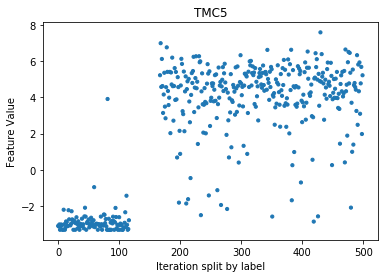

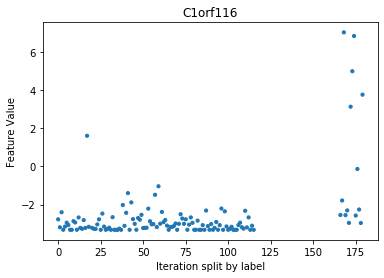

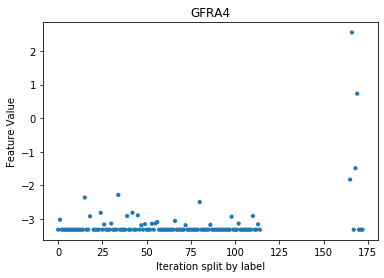

In [238]:
label1 = 15
label2 = 19
featurename = 'TMC5'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'C1orf116'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'GFRA4'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Peritoneum  and  Testis


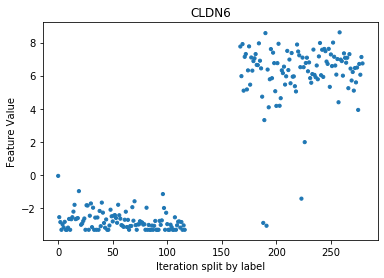

In [239]:
label1 = 15
label2 = 20
featurename = 'CLDN6'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Peritoneum  and  Thyroid


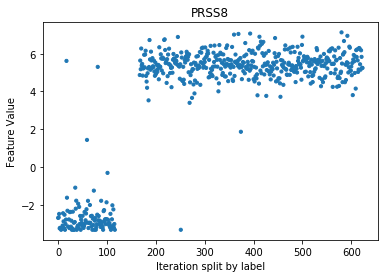

In [240]:
label1 = 15
label2 = 21
featurename = 'PRSS8'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Peritoneum  and  Uterus


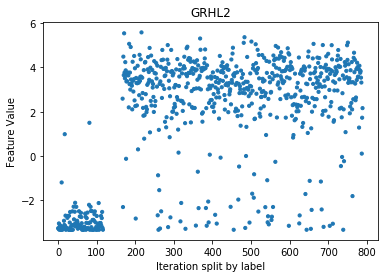

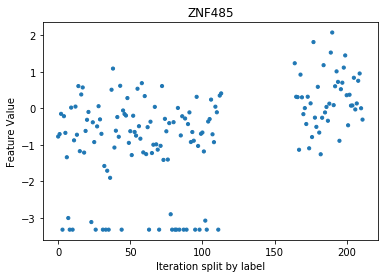

In [241]:
label1 = 15
label2 = 22
featurename = 'GRHL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ZNF485'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Prostate  and  Sarcoma


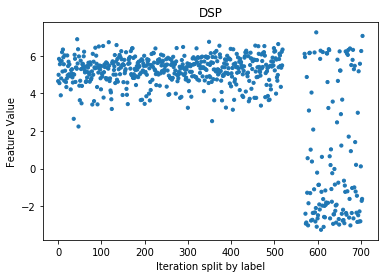

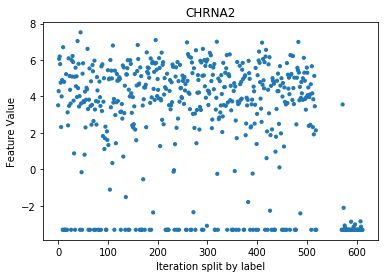

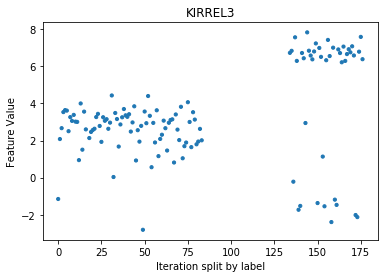

In [242]:
label1 = 16
label2 = 17
featurename = 'DSP'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CHRNA2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'KIRREL3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Prostate  and  Skin
['SLC9A2', 'RAB27B', 'CUX2', 'OVOL2', 'CDS1', 'KIAA1324']
[0, 0, 0, 0, 0, 0]


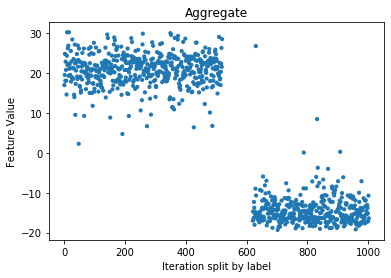

In [243]:
label1 = 16
label2 = 18
featurenamelist = ['SLC9A2', 'RAB27B', 'CUX2', 'OVOL2', 'CDS1', 'KIAA1324']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Prostate  and  Stomach
['SLC45A3', 'CREB3L4', 'STEAP2', 'DHRS7', 'ABCC4', 'TMPRSS2']
[0, 0, 0, 0, 0, 0]


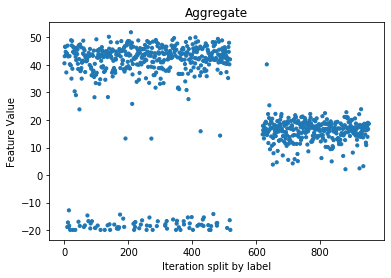

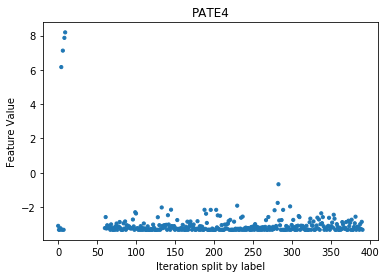

In [244]:
label1 = 16
label2 = 19
featurenamelist = ['SLC45A3', 'CREB3L4', 'STEAP2', 'DHRS7', 'ABCC4', 'TMPRSS2']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)
    
    if v < 30 and v > -5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PATE4'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Prostate  and  Testis


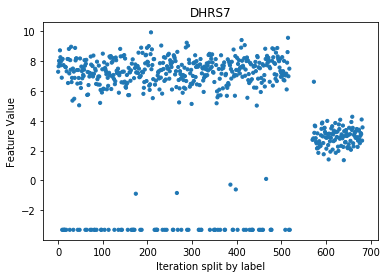

In [245]:
label1 = 16
label2 = 20
featurename = 'DHRS7'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Prostate  and  Thyroid


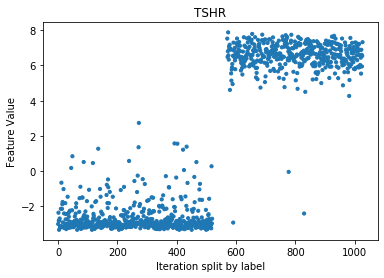

In [246]:
label1 = 16
label2 = 21
featurename = 'TSHR'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Prostate  and  Uterus


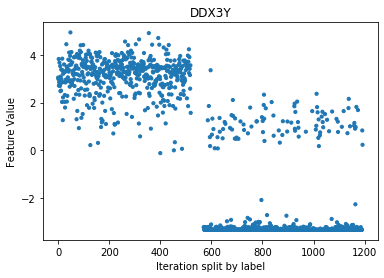

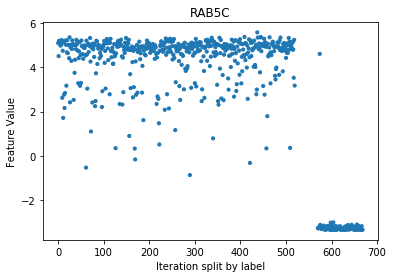

In [247]:
label1 = 16
label2 = 22
featurename = 'DDX3Y'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > -1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'RAB5C'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Sarcoma  and  Skin


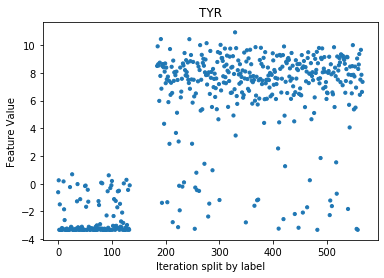

['DUSP4', 'MIA-RAB4B', 'CDH19', 'S100B', 'ITIH6', 'GJB1']
[0, 0, 0, 0, 0, 0]


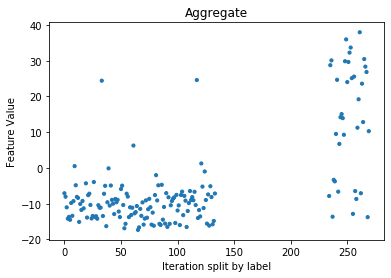

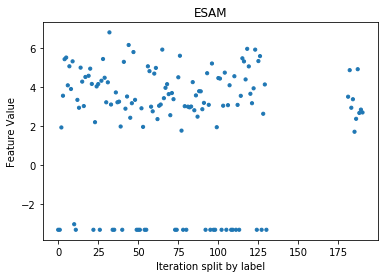

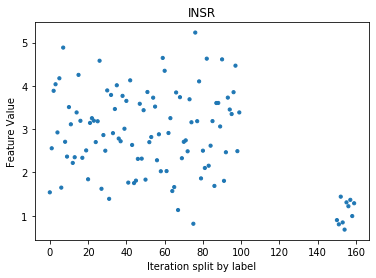

In [248]:
label1 = 17
label2 = 18
featurename = 'TYR'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['DUSP4', 'MIA-RAB4B', 'CDH19', 'S100B', 'ITIH6', 'GJB1']
reverse = [0, 0, 0, 0, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ESAM'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'INSR'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Sarcoma  and  Stomach


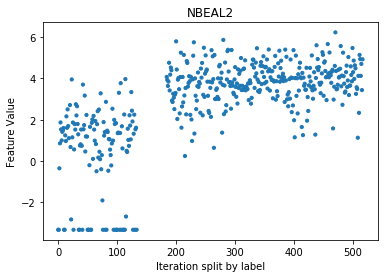

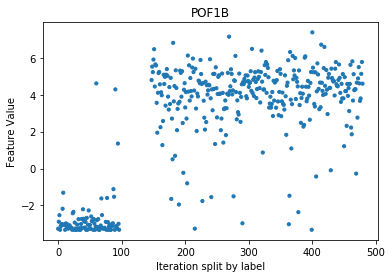

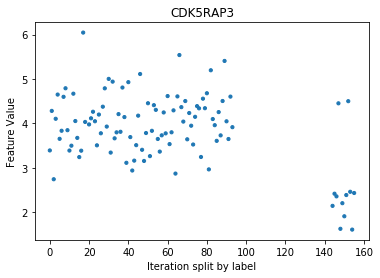

In [249]:
label1 = 17
label2 = 19
featurename = 'NBEAL2'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 0:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'POF1B'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -0.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'CDK5RAP3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Sarcoma  and  Testis


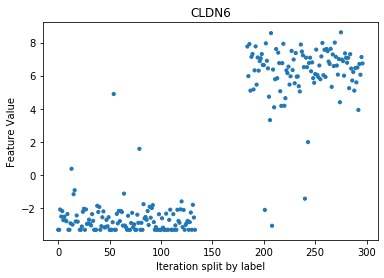

In [250]:
label1 = 17
label2 = 20
featurename = 'CLDN6'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Sarcoma  and  Thyroid


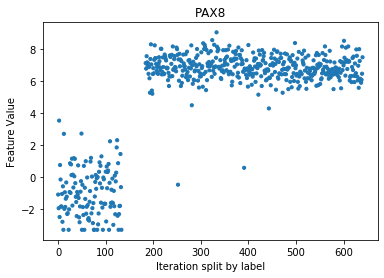

In [251]:
label1 = 17
label2 = 21
featurename = 'PAX8'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Sarcoma  and  Uterus


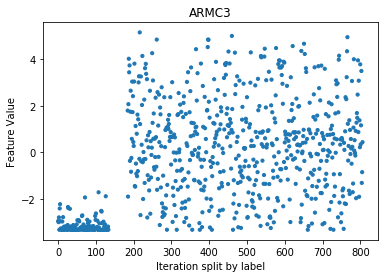

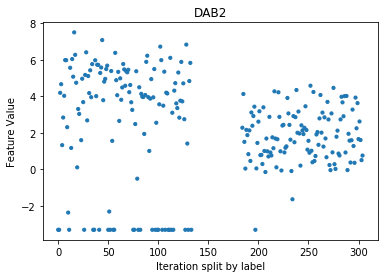

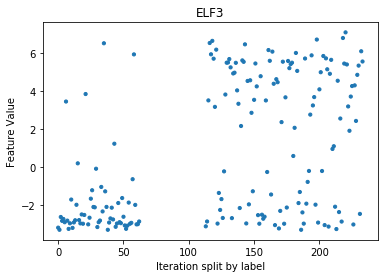

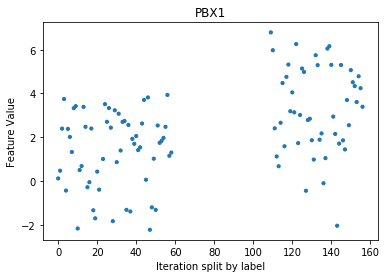

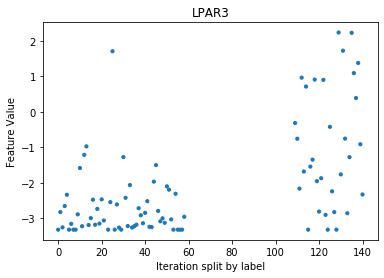

In [252]:
label1 = 17
label2 = 22
featurename = 'ARMC3'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < -1.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'DAB2'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 5 and v > -2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'ELF3'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 2:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'PBX1'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 4.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'LPAR3'
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Skin  and  Stomach
['PAX3', 'CCDC140', 'ALX1', 'RGS20', 'TYR', 'TJP3']
[0, 0, 0, 0, 0, 1]


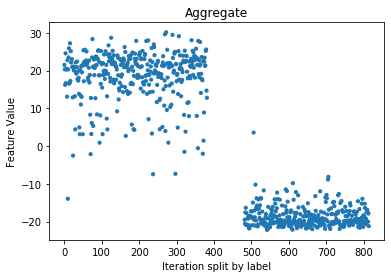

In [253]:
label1 = 18
label2 = 19
featurenamelist = ['PAX3', 'CCDC140', 'ALX1', 'RGS20', 'TYR', 'TJP3']
reverse = [0, 0, 0, 0, 0, 1]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Skin  and  Testis


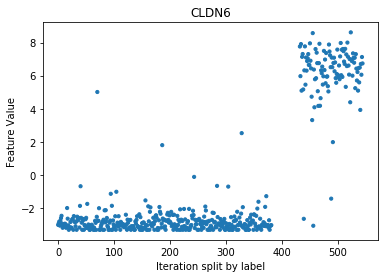

In [254]:
label1 = 18
label2 = 20
featurename = 'CLDN6'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Skin  and  Thyroid


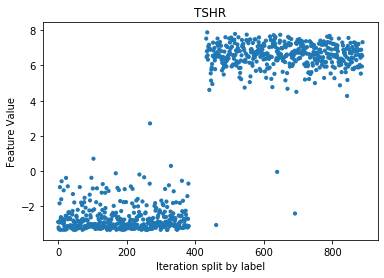

In [255]:
label1 = 18
label2 = 21
featurename = 'TSHR'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Skin  and  Uterus


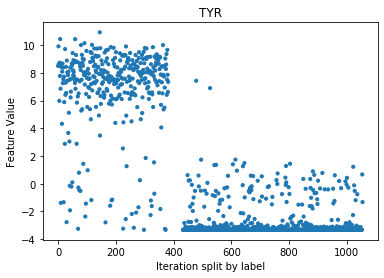

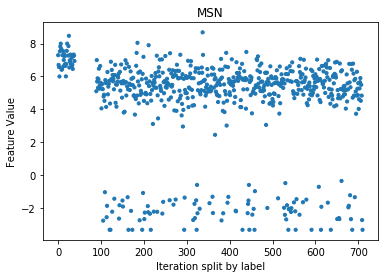

['FGFR2', 'EMX2', 'PKP2', 'PAX3', 'AR', 'CD24']
[0, 0, 0, 1, 0, 0]


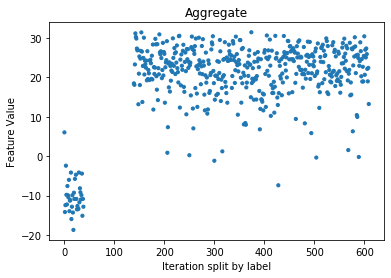

In [256]:
label1 = 18
label2 = 22
featurename = 'TYR'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v < 2.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurename = 'MSN'
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]

    if v > 4.5:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['FGFR2', 'EMX2', 'PKP2', 'PAX3', 'AR', 'CD24']
reverse = [0, 0, 0, 1, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Stomach  and  Testis
['TRO', 'ZNF667', 'WNK3', 'MAGEL2', 'ZIK1', 'SPSB4']
[0, 0, 0, 0, 0, 0]


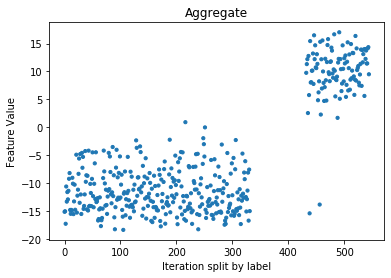

In [257]:
label1 = 19
label2 = 20
featurenamelist = ['TRO', 'ZNF667', 'WNK3', 'MAGEL2', 'ZIK1', 'SPSB4']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Stomach  and  Thyroid


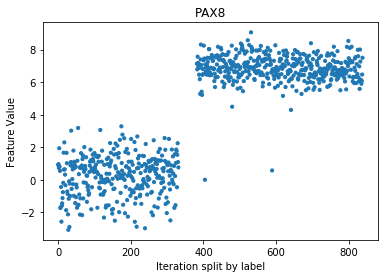

In [258]:
label1 = 19
label2 = 21
featurename = 'PAX8'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Stomach  and  Uterus


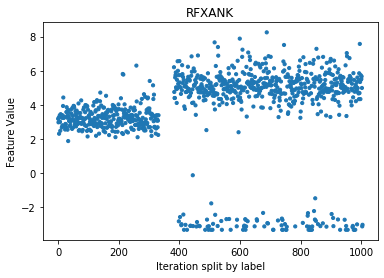

['EMX2', 'CLDN18', 'ESR1', 'LGALS4', 'SOX17', 'DLX5']
[0, 1, 0, 1, 0, 0]


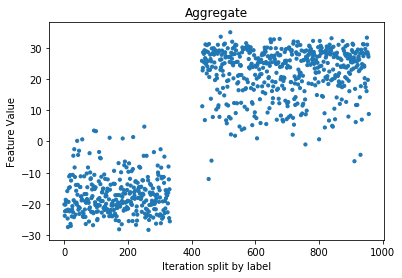

['ANKS3', 'SH2B1', 'RNF215', 'RHBDD3', 'PRPF6', 'NCOA4']
[0, 0, 0, 0, 0, 1]


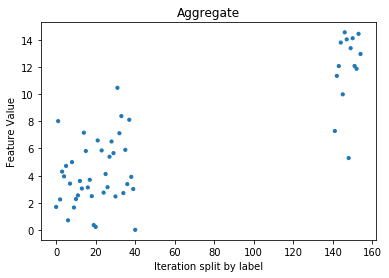

In [259]:
label1 = 19
label2 = 22
featurename = 'RFXANK'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = list(df[featurename])[i]
    
    if v > 1:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['EMX2', 'CLDN18', 'ESR1', 'LGALS4', 'SOX17', 'DLX5']
reverse = [0, 1, 0, 1, 0, 0]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

#split
tmpindexlist = list()
for i in indexlist:
    v = Aggregate(df, i, featurenamelist, reverse)

    if v < 5 and v > -10:
        
        tmpindexlist.append(i)
indexlist = tmpindexlist

#new value
featurenamelist = ['ANKS3', 'SH2B1', 'RNF215', 'RHBDD3', 'PRPF6', 'NCOA4']
reverse = [0, 0, 0, 0, 0, 1]
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

Labels being compared: Testis  and  Thyroid


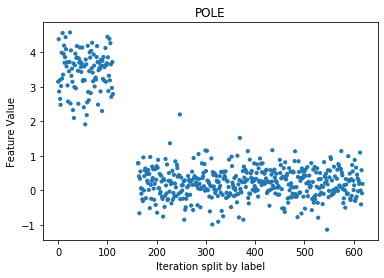

In [260]:
label1 = 20
label2 = 21
featurename = 'POLE'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Testis  and  Uterus


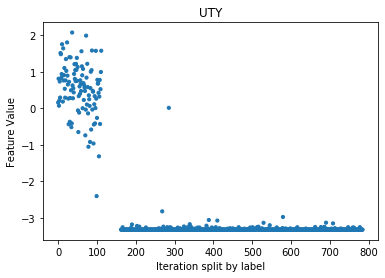

In [261]:
label1 = 20
label2 = 22
featurename = 'UTY'
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairfeature(df, featurename, label1, label2, indexlist)

Labels being compared: Thyroid  and  Uterus
['TG', 'FOXE1', 'IYD', 'SFTA3', 'DUOX2', 'KCNJ16']
[0, 0, 0, 0, 0, 0]


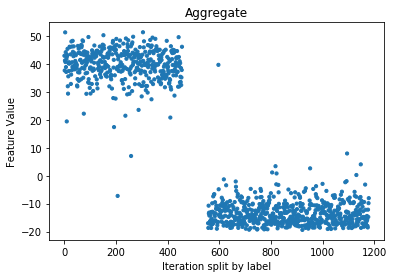

In [262]:
label1 = 21
label2 = 22
featurenamelist = ['TG', 'FOXE1', 'IYD', 'SFTA3', 'DUOX2', 'KCNJ16']
reverse = [0, 0, 0, 0, 0, 0]
print("Labels being compared:", labelnames[label1], " and ", labelnames[label2])

#first feature
indexlist = NarrowToTwoLabels(df, label1, label2)
graphpairaggregate(df, featurenamelist, reverse, label1, label2, indexlist)

In [263]:
#Adrenal 0
#Bladder 1
#Brain 2
#Breast 3
#Cervix 4
#Colon 5
#Esophagus 6
#Head 7
#Kidney 8
#Leukemia 9
#Liver 10
#Lung 11
#Lymph 12
#Ovarian 13
#Pancreas 14
#Peritoneum 15
#Prostate 16
#Sarcoma 17
#Skin 18
#Stomach 19
#Testis 20
#Thyroid 21
#Uterus 22
